# Coherence functions, spectra and antibunching in molecular resonance fluorescence

In [7]:
from qutip import basis, qeye, tensor, destroy, thermal_dm, mesolve, steadystate, Options, entropy_mutual
import qutip as qt
import numpy as np
from numpy import sqrt, pi
from utils import *
import phonons as RC
from style import *
import matplotlib.pyplot as plt
import optical as EM
import time
from importlib import reload
import copy

plt.style.use('ggplot')
plt.rcParams["axes.grid"] = True
plt.rcParams["axes.edgecolor"] = "0.15"
plt.rcParams["axes.linewidth"]  = 1.5
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['font.size'] = 18
plt.rcParams['legend.fontsize'] = 'large'
plt.rcParams['figure.titlesize'] = 'medium'

G= basis(2,0)
E = basis(2,1)

sigma = G*E.dag()

I_sys = qeye(2)
initial_sys = G*G.dag()#0.5*(E+G)*(G.dag()+E.dag())
T_EM = 0.

# Numerical Weak coupling phonons

In [8]:
def weak_phonon(H_sub, alpha=0., w0=0., Gamma=0., T=0., tol=1e-5):
    A = sigma.dag()*sigma 
    
    return EM.L_non_rwa(H_sub, A, w0, Gamma, T, J_underdamped, 
                     principal=True, silent=True, alpha=alpha, tol=tol) # need principal value parts

In [9]:



def WC_comparison(detuning=0., alpha=0.01, Rabi=0.01, w0=0.01, N=5, 
      T_ph=77., Gamma=0.01, overdamped_cutoff=0, tf=1., wc_tol=1e-5):
    
    epsilon = 1*ev_to_inv_cm
    detuning = detuning*ev_to_inv_cm #0.01*ev_to_inv_cm
    w_laser = epsilon + detuning
    Rabi = Rabi*ev_to_inv_cm # 0.01*ev_to_inv_cm
    w0 = w0*ev_to_inv_cm
    Gamma = Gamma*ev_to_inv_cm
    alpha_ph = alpha*ev_to_inv_cm
    
    if abs(overdamped_cutoff)>0:
        Gamma = (w0**2)/overdamped_cutoff
    Gamma_EM =  100*5.309e-3
    
    
    H_sub = (epsilon-w_laser)*sigma.dag()*sigma + (Rabi/2)*(sigma.dag()+sigma)
    shift = 0.5*pi*alpha_ph/2
    
    timelist = np.linspace(0, tf, int(tf*1300))
    energies, states = exciton_states(detuning, Rabi, shift=shift)
    
    real_exciton = 0.5*(states[1]*states[0].dag() + states[0]*states[1].dag())
    imag_exciton = 0.5*1j*(states[1]*states[0].dag() - states[0]*states[1].dag())
    J = J_minimal
    L_RC, H, A_EM, A_ph, Z, wRC, kappa, gamma = RC.RC_mapping_general(H_sub, sigma, T_ph, Gamma, 
                                                                        w0, alpha_ph, N,
                                                                        silent=True, w_laser=w_laser)
    
    L = copy.deepcopy(L_RC)
    L_add = copy.deepcopy(L_RC)
    #assert L==L_add
    options = Options(nsteps=1500, store_states=True)
    
    n_RC = EM.Occupation(w0, T_ph)
    I = qeye(N)
    rho_0 = tensor(initial_sys, thermal_dm(N, n_RC))
    expects = [tensor(G*G.dag(), I), tensor(E*E.dag(), I), tensor(E*G.dag()+G*E.dag(), I), #0, 1, 2
               Rabi*(1j*tensor(G*E.dag()-E*G.dag(), I)), # 3, TLS current
                tensor(real_exciton, I), tensor(imag_exciton, I), #4,5
               tensor(qeye(2), destroy(N).dag()*destroy(N)), # 6
               tensor(qeye(2), destroy(N).dag()+destroy(N)), # 7
               kappa*1j*tensor(E*E.dag(), destroy(N).dag()-destroy(N))] # 8
    L += EM.L_nonsecular(H, A_EM, epsilon, Gamma_EM, T_EM, J, silent=True, w_laser=w_laser)
    
    ss_sc = steadystate(H, [L])
    ss_expvals_sc = [(ss_sc*ex).tr() for ex in expects]
    dynamics_sc = mesolve(H, rho_0, timelist, c_ops=[L], e_ops=expects, options=options)
    
    L_add += EM.L_nonsecular(tensor(H_sub, I), A_EM, epsilon, Gamma_EM, T_EM, J, silent=True, w_laser=w_laser)
    
    ss_add = steadystate(H, [L_add])
    ss_expvals_add = [(ss_add*ex).tr() for ex in expects]
    rho_0 = tensor(initial_sys, thermal_dm(N, n_RC))
    dynamics_add = mesolve(H, rho_0, timelist, c_ops=[L_add], e_ops=expects, options=options)
    
    expects = [G*G.dag(), E*E.dag(), E*G.dag()+G*E.dag(), #0, 1, 2
               1j*Rabi*(G*E.dag()-E*G.dag()), # 3, TLS current
               real_exciton, imag_exciton] # 4, 5
    
    #L_wc = wc.L_wc_analytic(detuning=detuning, Rabi=Rabi, alpha=alpha_ph, w0=w0, Gamma=Gamma, T=T_ph, tol=1e-5)
    
    L_wc = weak_phonon(H_sub, alpha=alpha_ph, 
                       w0=w0, Gamma=Gamma, T=T_ph, tol=wc_tol)
    
    L_wc+= EM.L_nonsecular(H_sub, sigma, epsilon, Gamma_EM, T_EM, J, silent=True, w_laser=w_laser)
    
    H_sub_shift = H_sub + shift*E*E.dag()
    ss_wc = steadystate(H_sub_shift, [L_wc])
    ss_expvals_wc = [(ss_wc*ex).tr() for ex in expects]
    rho_0 = initial_sys
    dynamics_wc = mesolve(H_sub_shift, rho_0, timelist, c_ops=[L_wc], e_ops=expects, options=options)
            
    #print( "Full:\n", ss[0].ptrace(0).full(), '\n Add.:\n', ss[1].ptrace(0).full())
    print("Dynamics complete")
    scope = locals()
    PARAM_names = ['Rabi', 'kappa', 'gamma', 'Gamma_EM', 'Gamma', 'alpha_ph', 
                   'w0', 'H_sub', 'H_sub_shift', 'shift', 'detuning', 'overdamped_cutoff']
    
    PARAMS = {name: eval(name, scope) for name in PARAM_names}
    #print(PARAMS)
    timelist*=inv_ps_to_inv_cm # convert time from cm to ps : cm^-1/ps^-1 = ps/cm
    
    scope = locals()
    data_names = ['ss_expvals_sc', 'ss_sc', 'dynamics_sc', 'ss_expvals_add', 'ss_add', 'dynamics_add',
                  'ss_expvals_wc', 'ss_wc', 'dynamics_wc', 'L_RC', 'H', 'A_ph', 'timelist', 'PARAMS']
    
    return {name: eval(name, scope) for name in data_names}



In [10]:
def mutual_info(rho, selA=0, selB=1, base=2):
    return entropy_mutual(rho, selA, selB)

def current(rho, L, operator):
    return (qt.vector_to_operator(L*qt.operator_to_vector(rho))*operator).tr()


In [11]:

def plot_thermo_and_info(data_dict, timelength=1, axes=None):
    timelist = data_dict['timelist']
    L, H_S = data_dict['L_RC'], data_dict['H']
    labels = ['Full', 'add.']
    A_ph = data_dict['A_ph']
    linestyle=['solid', 'dashed']
    #if type(axes) != list:
    #    f, axes = plt.subplots(5, 1, figsize=(12,12), sharex=True,tight_layout=True)
        
    for i, suff in enumerate(['_sc', '_add']):
        data = data_dict['dynamics'+suff]
        ss = data_dict['ss'+suff]
        l, c, ls = labels[i], colourWheel[i], linestyle[i]
        
        energy = np.array([current(rho, L, H_S).real for rho in data.states])
        n_R_dot = np.array([current(rho, L, A_ph.dag()*A_ph).real for rho in data.states])
        mutual = np.array([mutual_info(rho).real for rho in data.states])
        
        n_S_dot = -data.expect[8]
        number = data.expect[6].real
        d1 = n_R_dot + n_S_dot
        d2 = np.gradient(number)
        ratio =max(abs(d2))/max(abs(d1)) # check what the scaling is between analytical and numerical diff.
        n_dot = d1*ratio
        n_S_dot*=ratio # scale the analytical models to match the numerical
        n_R_dot*=ratio
        axes[0].plot(timelist, n_dot, label=l, color=c, ls=ls) #  TLS-RC current
        #ax1.axhline(n_dot[-1], color=c, ls='dotted') 
        
        axes[1].plot(timelist, n_S_dot, label=l, color=c, ls=ls) # TD of b.dag()*b
        #ax2.axhline(n_S_dot[-1], color=c, ls='dotted')
        axes[2].plot(timelist, n_R_dot, label=l, color=c, ls=ls) # residual phonon current
        #ax3.axhline(current(ss[i], L, O).real*ratio, color=c, ls='dotted')

        axes[3].plot(timelist, number, label=l, color=c, ls=ls) # number operator
        #ax4.axhline(number[-1], color=c, ls='dotted')
        axes[4].plot(timelist, mutual, label=l, color=c, ls=ls) # mutual info
        #ax5.axhline(mutual_info(rho).real, color=c, ls='dotted')
    #ax1.set_ylabel(r'$\langle\dot{H_S}\rangle$')
    axes[0].set_ylabel(r'$\langle{\dot{n}}\rangle$')
    axes[1].set_ylabel(r'$\langle{\dot{n}_S}\rangle$')
    #ax3.set_ylabel(r'$\langle{\dot{n}}\rangle$')
    axes[2].set_ylabel(r'$\langle{\dot{n_R}}\rangle$')
    axes[3].set_ylabel(r'$\langle{n}\rangle$')
    axes[4].set_ylabel(r'$I(\rho_M, \rho_{RC})$')
    axes[4].set_xlabel('Time (ps)')
    for ax in axes:
        #ax.legend(loc='best')
        ax.set_xlim(timelist[0], timelist[int((len(timelist)-1)*timelength)])
    plt.show()
    #return n_dot, n_S_dot, n_R_dot

    
def plot_additive_dynamics(data_dict, timelength=1):
    labels = ['Full', 'Add.']
    linestyles = ['solid', 'dashed']
    timelist = data_dict['timelist']
    alphas = [1, 1]
    f, axes = plt.subplots(8, 1, figsize=(12,20), sharex=True, tight_layout=True)
    for i, suff in enumerate(['_sc', '_add']):
        dynamics = data_dict['dynamics'+suff]
        ss = data_dict['ss_expvals'+suff]
        l, c, linestyle, a = labels[i], colourWheel[i], linestyles[i], alphas[i]
        
        axes[0].plot(timelist, dynamics.expect[1].real, label=l, color=c, ls=linestyle, alpha=a) # TLS pop.
        axes[0].axhline(ss[1], color=c, ls='dotted')
        axes[1].plot(timelist, dynamics.expect[2].real, label=l, color=c, ls=linestyle, alpha=a) # sigma_x
        axes[1].axhline(ss[2].real, color=c, ls='dotted')
        #ax3.plot(timelist, dynamics.expect[4].real, label=l, color=c, ls=linestyle, alpha=a) # Real eig
        #ax3.axhline(ss[4].real, color=c, ls='dotted')
        axes[2].plot(timelist, dynamics.expect[3].real, label=l, color=c, ls=linestyle, alpha=a) # TLS current
        axes[2].axhline(ss[3].real, color=c, ls='dotted')
        
    axes[0].set_ylabel(r'$\langle\sigma^{\dagger}\sigma\rangle$')
    axes[1].set_ylabel(r'$\langle\sigma_x\rangle$')
    #ax3.set_ylabel(r'$  \langle -| \rho_S(t)|+\rangle |$')
    axes[2].set_ylabel(r'$\langle I_{g \to e} \rangle$')
    #ax4.set_ylabel(r'$2\Im\langle |+\rangle\!\langle -|\rangle$')
    axes[2].set_xlabel('Time ($ps$)')
    axes[0].legend(loc='best')
    for ax in axes[0:2]:
        ax.set_xlim(timelist[0], timelist[int((len(timelist)-1)*timelength)])
        ax.set_aspect('auto')
        
    plot_thermo_and_info(data_dict, timelength=1, axes=axes[3::])
    

# Comparison to Additive theory

Detunings are going to be $(1meV, 10meV)$.

Coupling strengths are going to be $(1meV, 10meV, 100meV)$.

Temperatures are $35, 77, 150K$

Mode frequencies are $6meV, 12meV, 18meV$ (or $48, 96, 145 cm^{-1}$)


In [12]:
reload(RC)
def get_data_and_plot_for_detunings_additive(T=35, alpha=1e-3, w0=6e-3, Gamma=12e-3, Rabi = 1e-3, tf=4, 
                                    err_threshold=0.001, wc_tol=0):
    wc_tol=50. # make this very large as we don't need to calculate it
    
    # WC: 1meV. # Detuning dependence
    N = RC.N_estimate_eV(alpha, w0, T, err_threshold=err_threshold, min_N=4, max_N=24, silent=True)
    print("USING N={}".format(N))
    # Detuning dependence
    shift = 0.5*(pi*alpha/2)/ev_to_inv_cm
    detuning = shift
    for detuning in [shift, 6e-3, 12e-3, 18e-3]:
        print("Detuning : {:0.4f}meV | w0 : {:0.2f}meV".format(1000*detuning, 1000*w0))
        DD = WC_comparison(detuning=detuning, alpha=alpha, Rabi=Rabi, w0=w0, N=N, T_ph=T, 
                           Gamma=Gamma, tf=tf, wc_tol=wc_tol)
        plot_additive_dynamics(DD, timelength=1)
    


USING N=8
Detuning : 0.0010meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


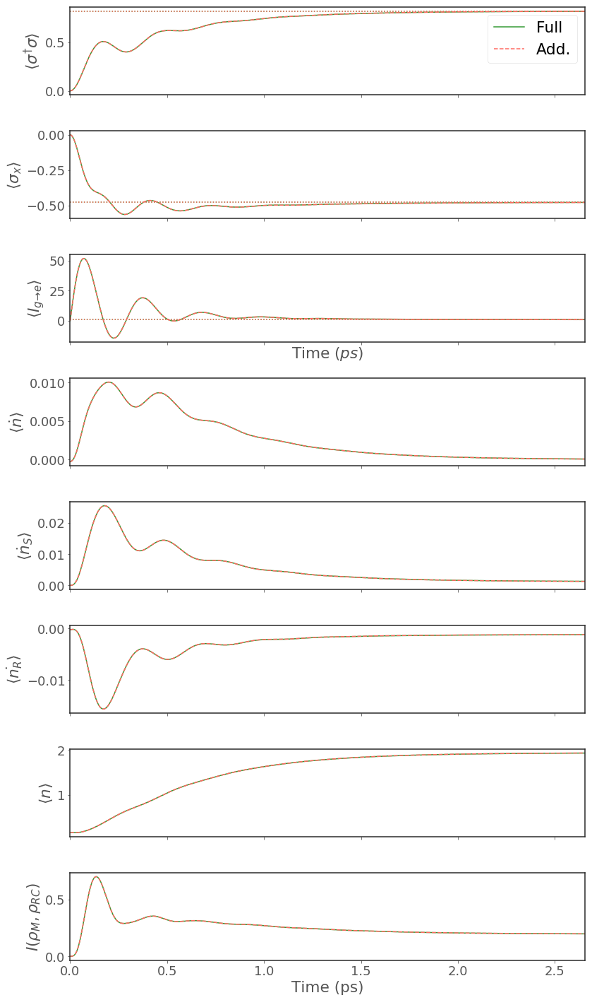

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


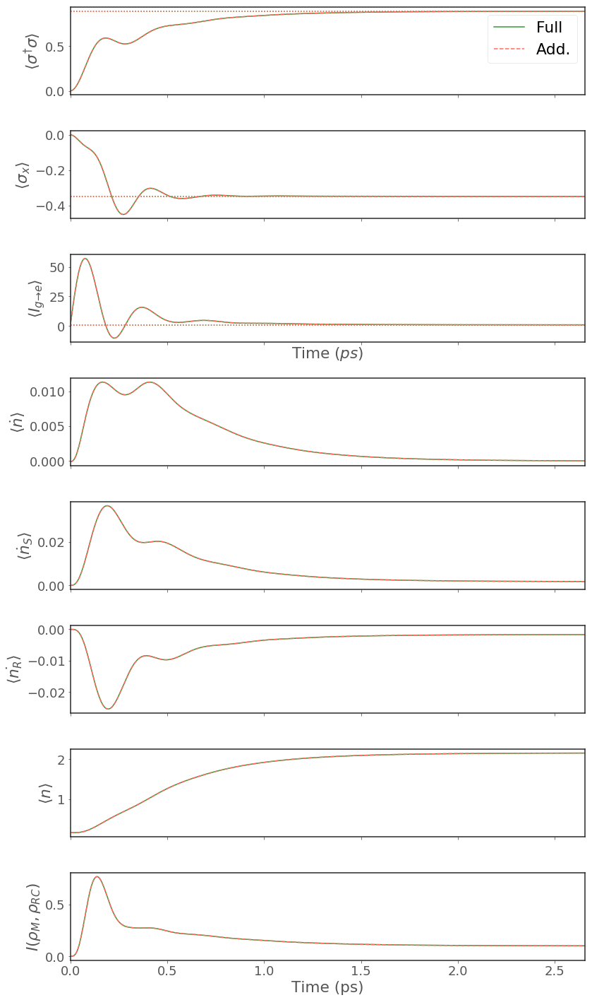

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


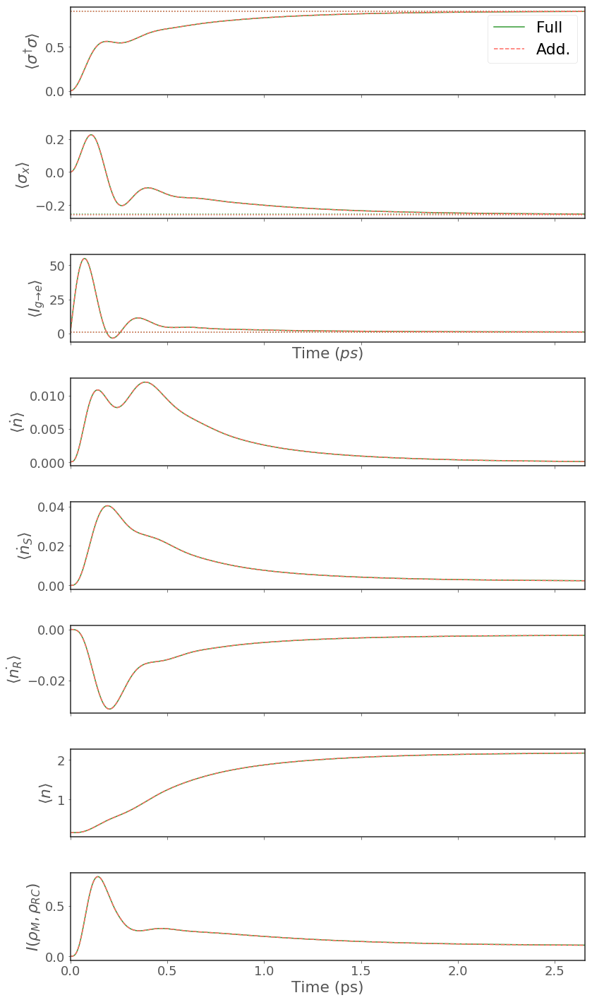

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


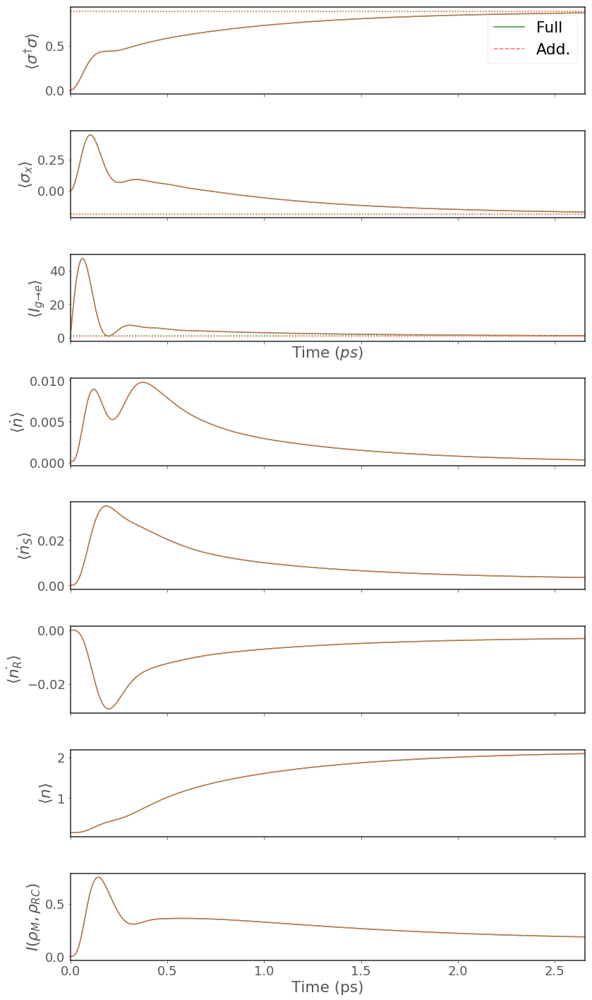

USING N=7
Detuning : 0.0010meV | w0 : 12.00meV
Dynamics complete


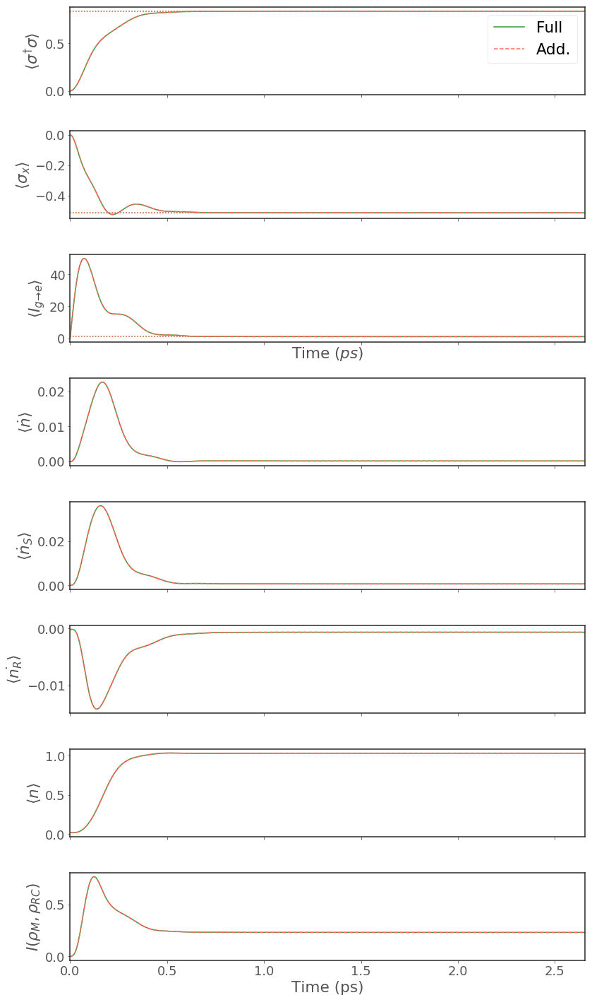

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


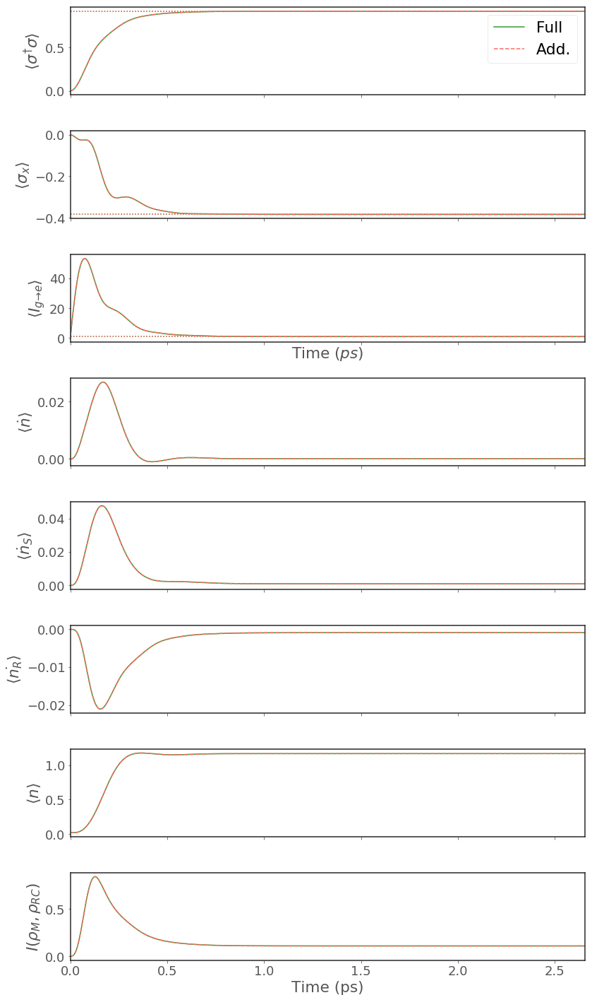

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


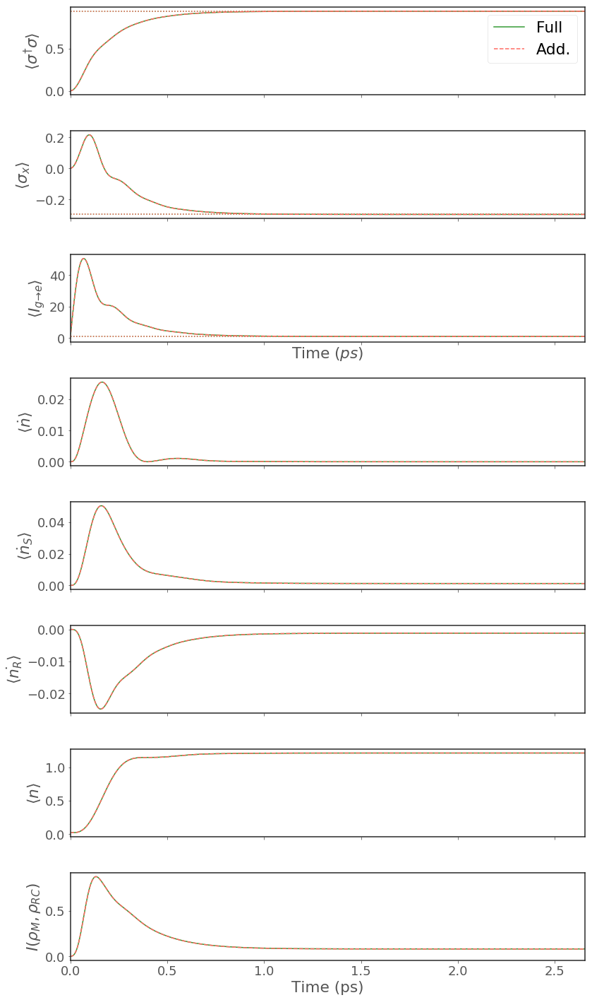

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


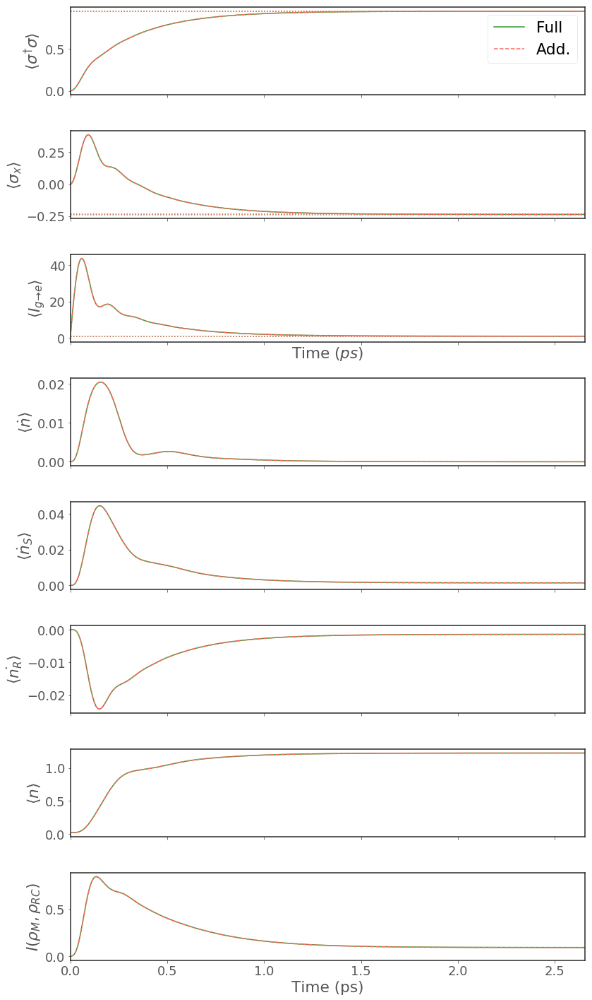

USING N=6
Detuning : 0.0010meV | w0 : 18.00meV
Dynamics complete


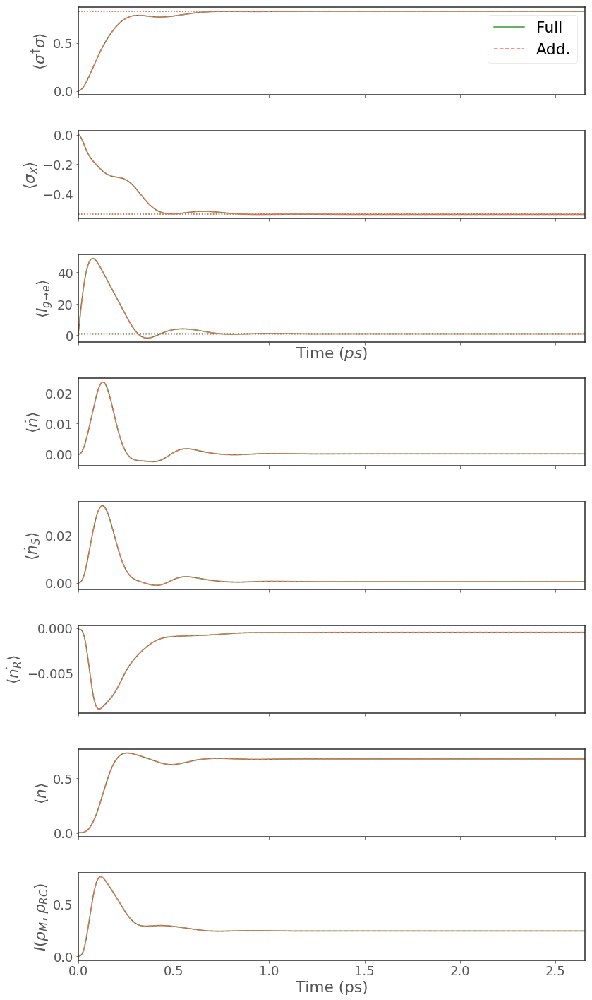

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


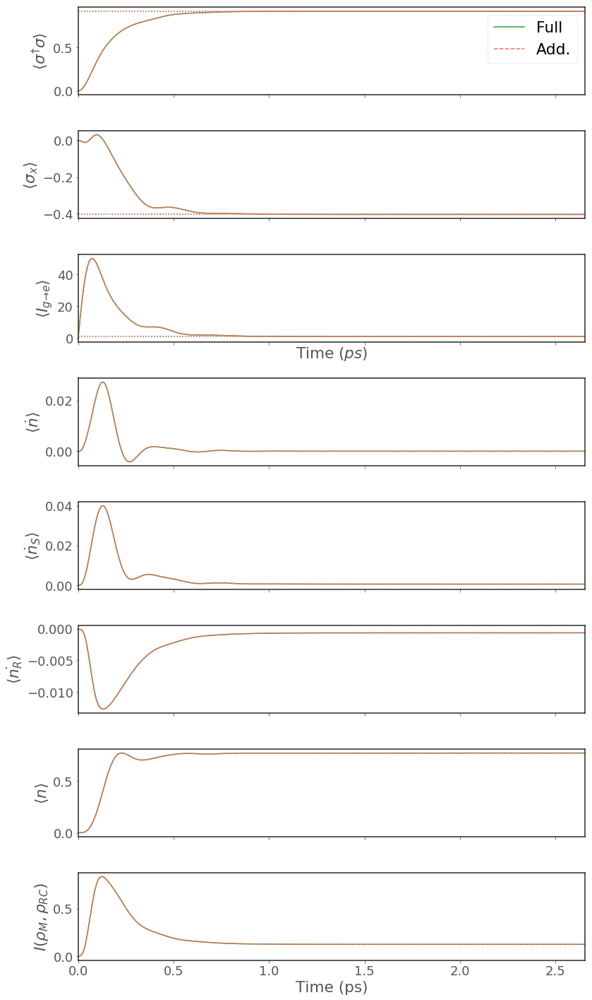

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


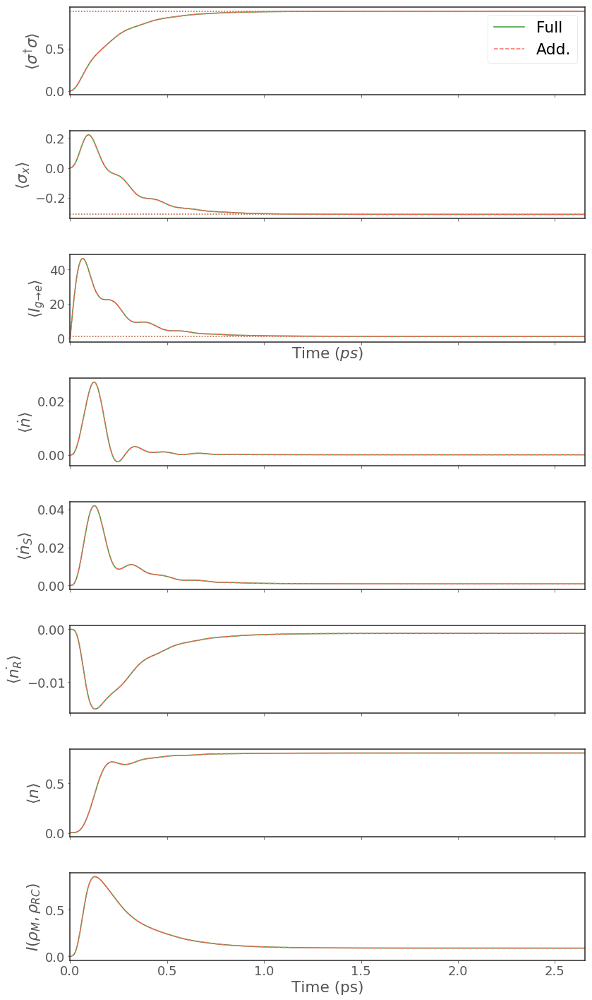

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


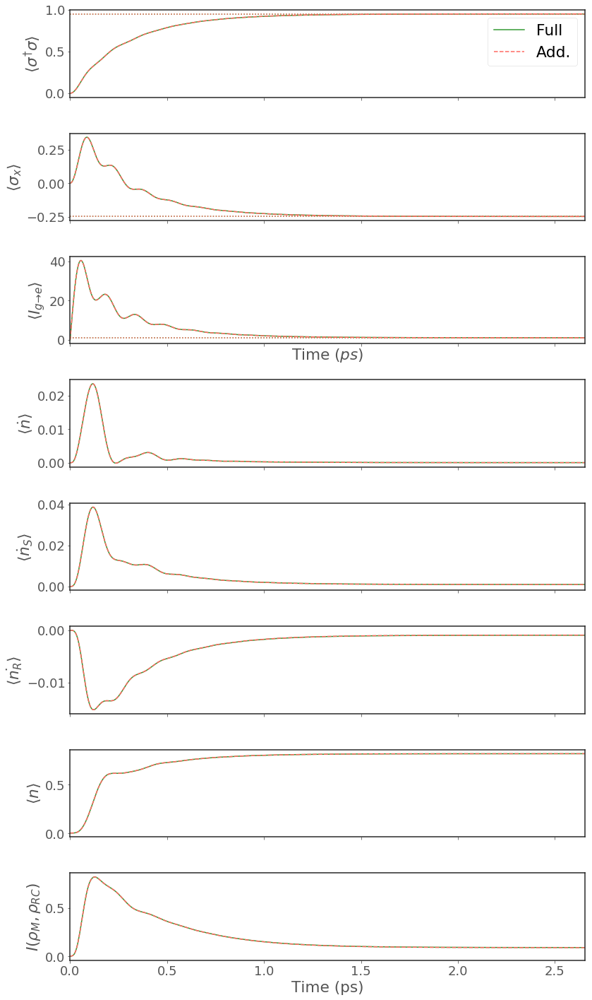

In [13]:
# low T, intermediate coupling and Rabi 
T=35
alpha=10e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 10e-3
tf=0.5
for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)
    

USING N=8
Detuning : 0.0010meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


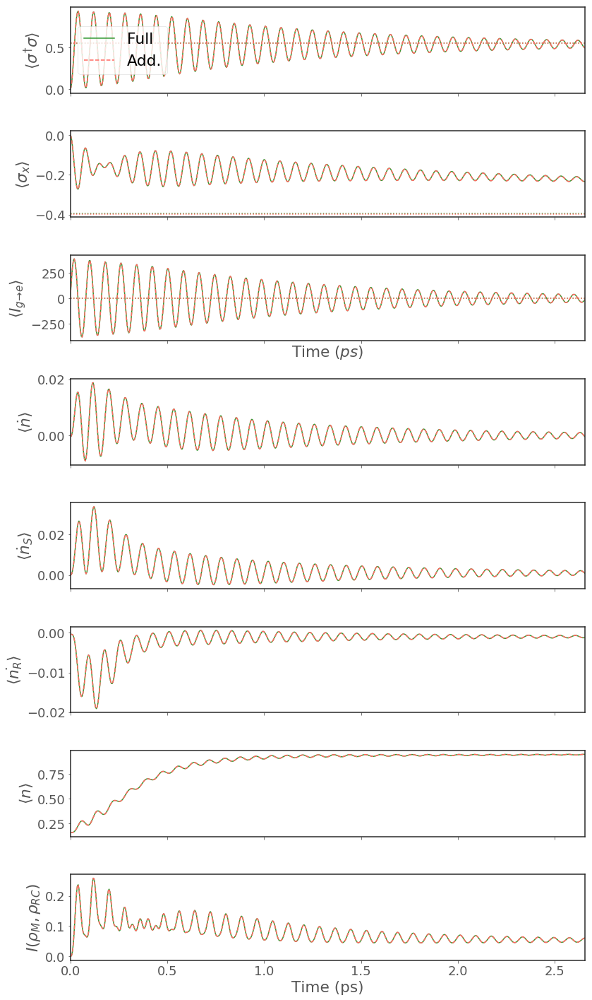

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


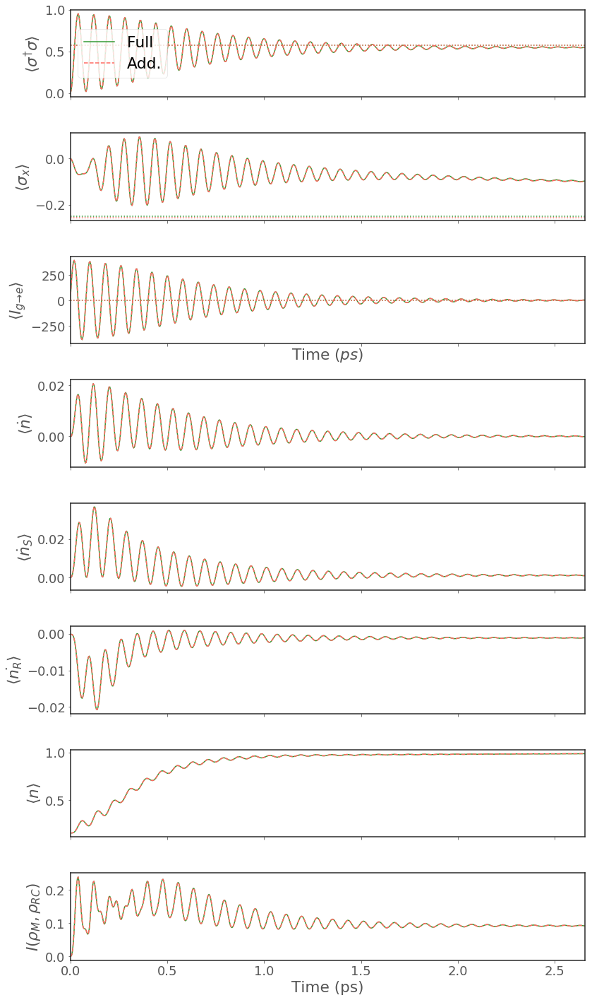

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


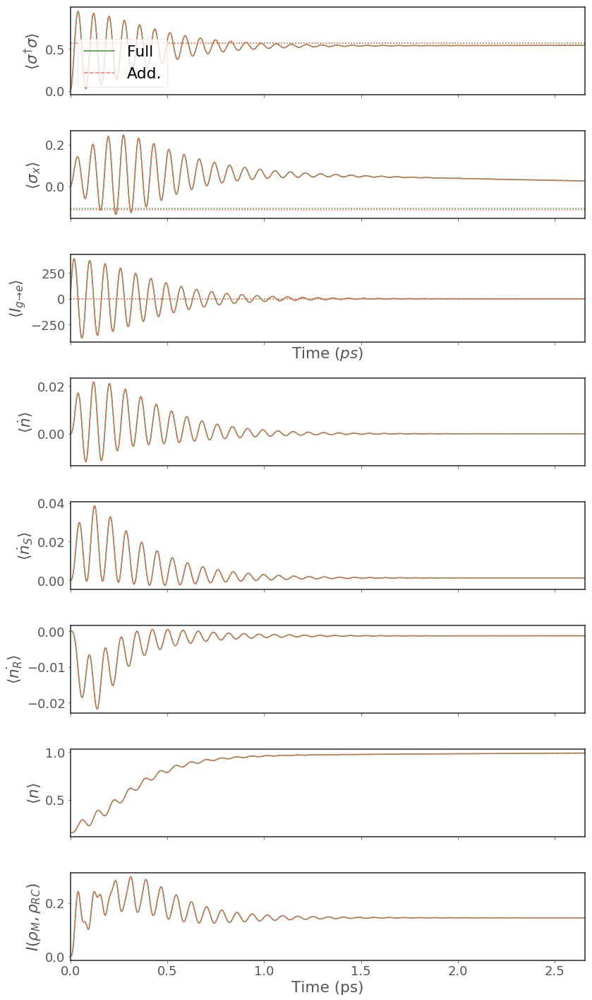

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


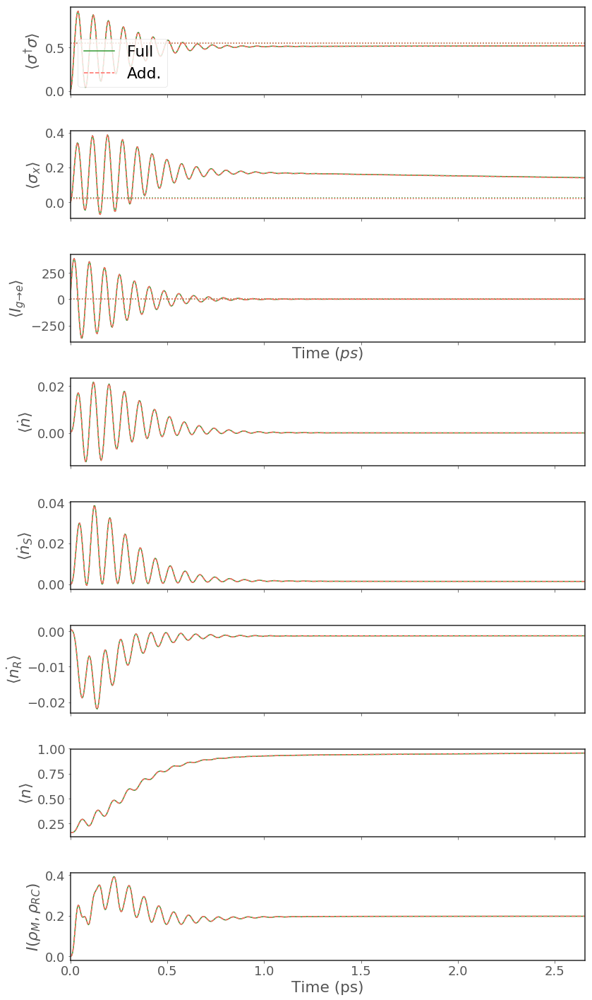

USING N=7
Detuning : 0.0010meV | w0 : 12.00meV
Dynamics complete


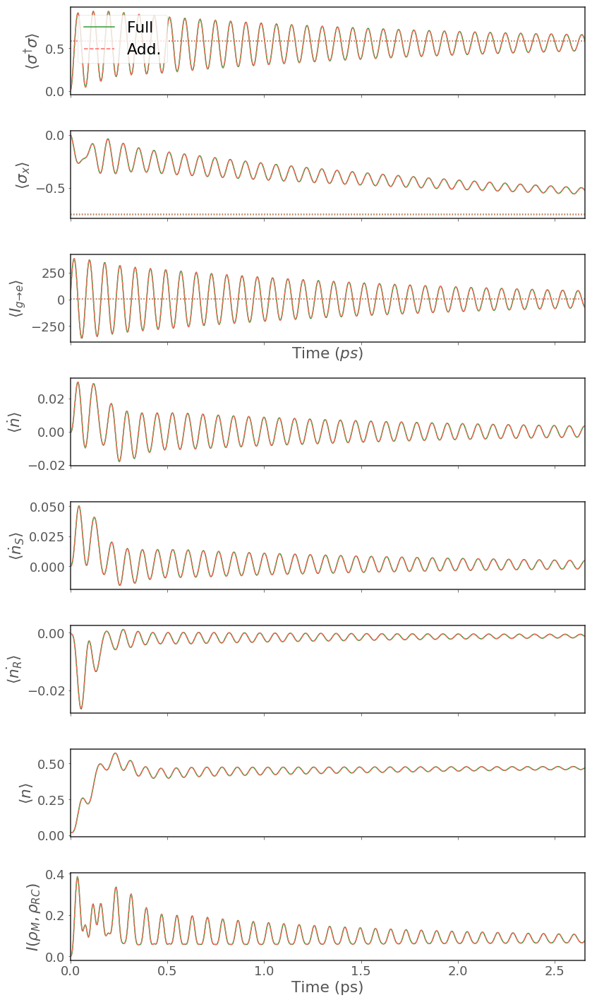

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


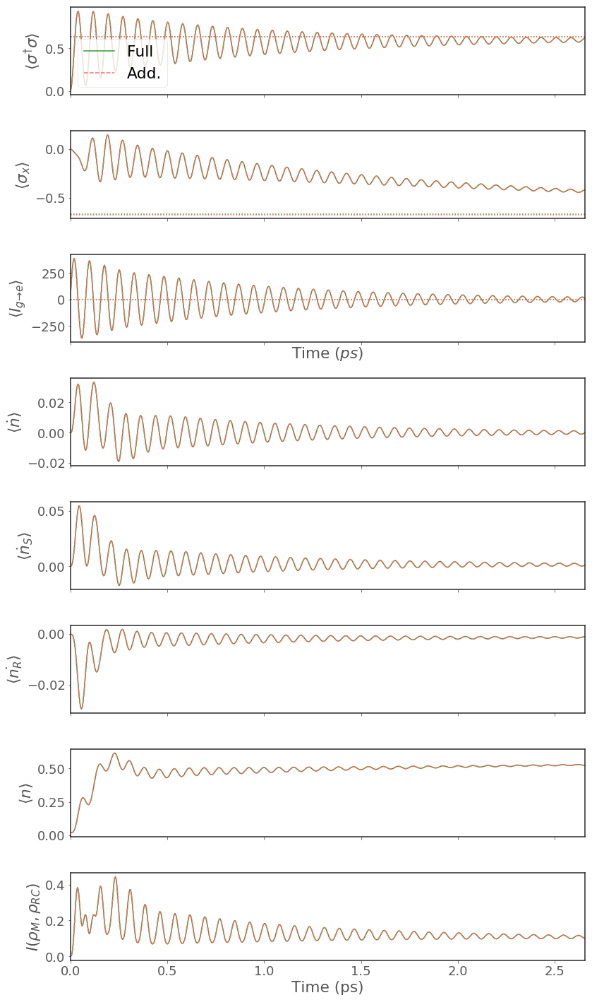

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


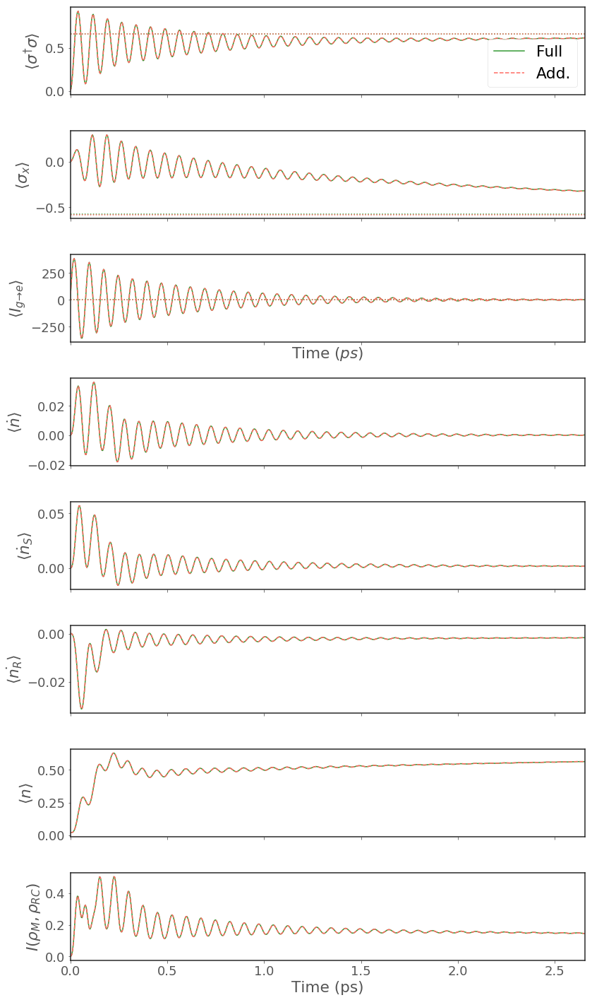

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


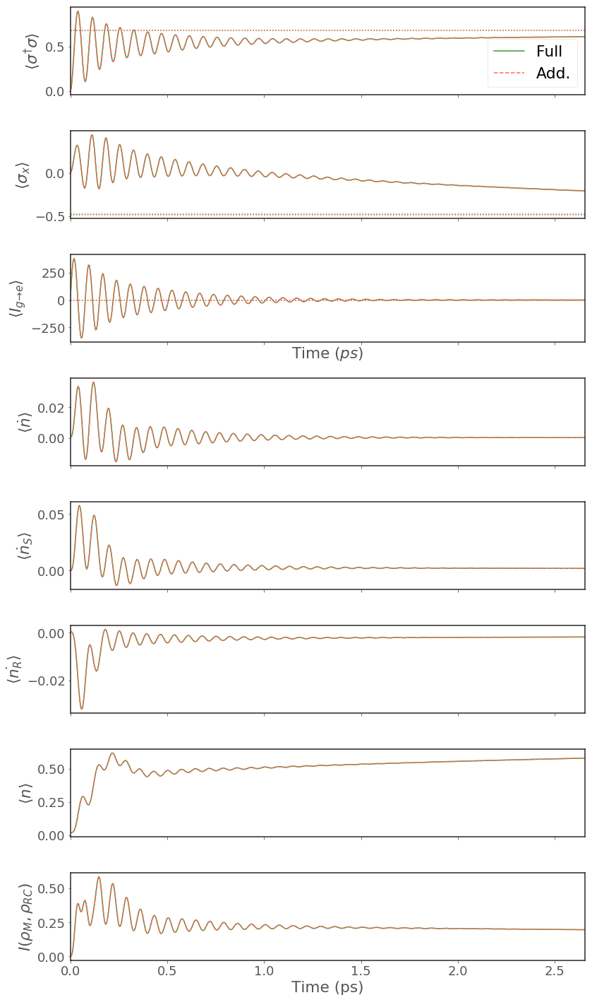

USING N=6
Detuning : 0.0010meV | w0 : 18.00meV
Dynamics complete


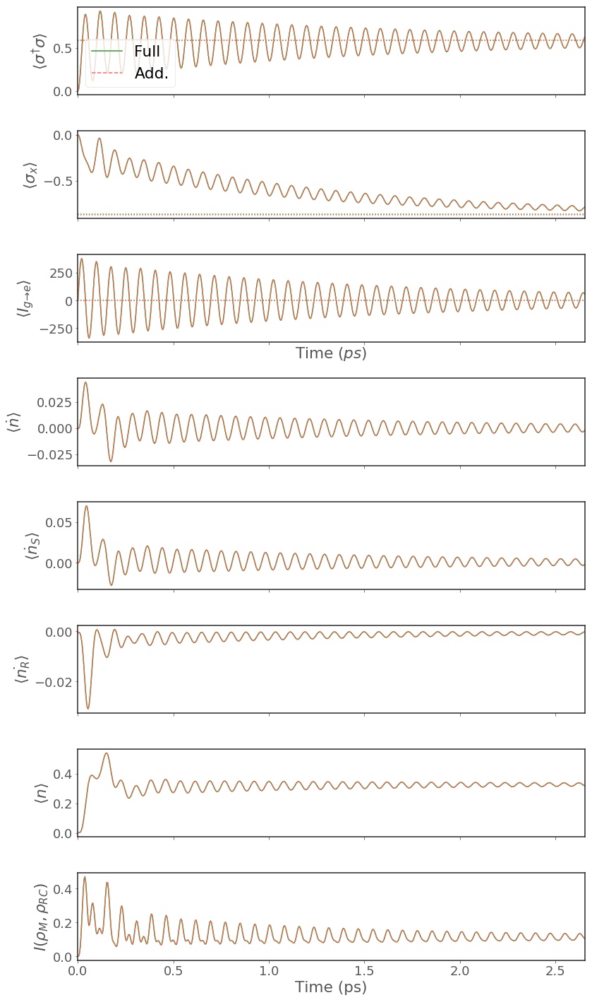

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


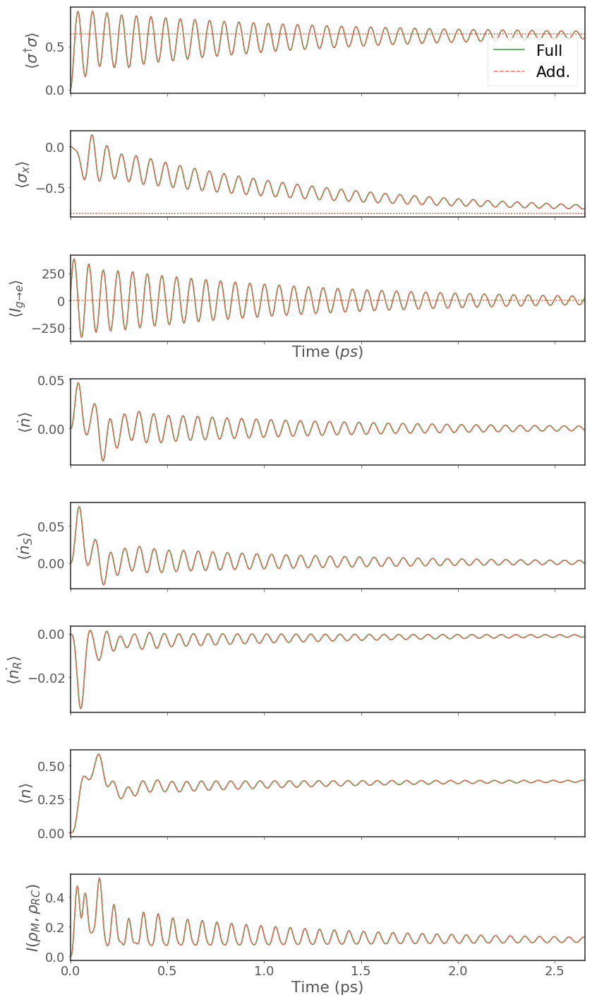

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


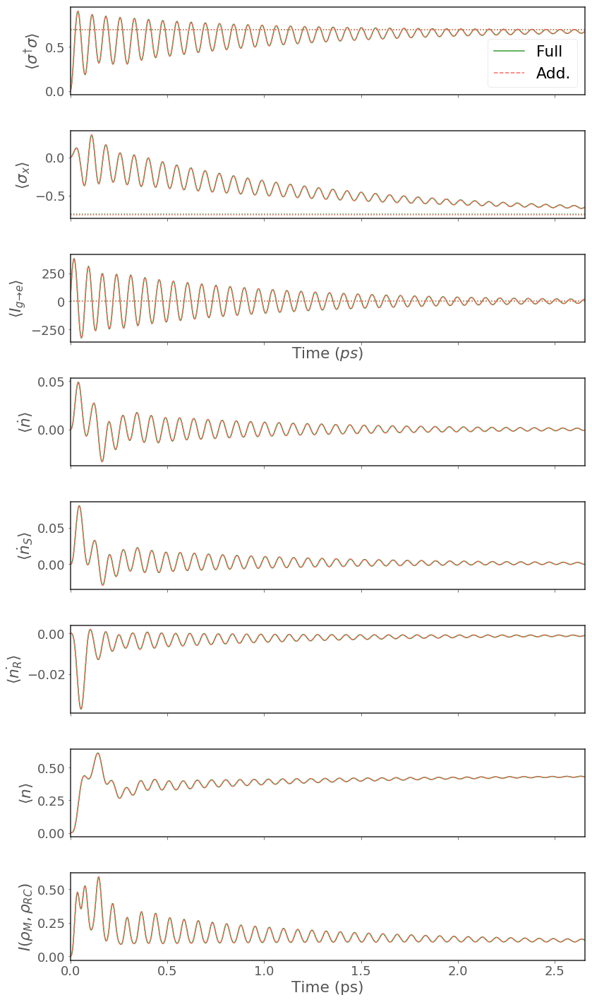

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


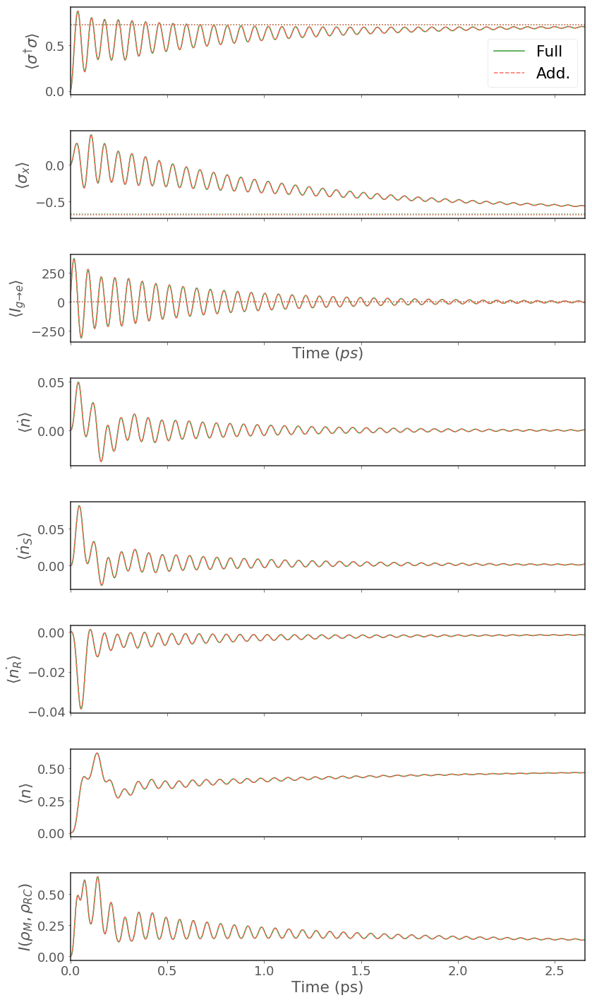

In [14]:
# low T, intermediate coupling and Strong Rabi 
T=35
alpha=10e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 50e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

Error could only converge to 0.0035054045983088675
USING N=24
Detuning : 0.0097meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


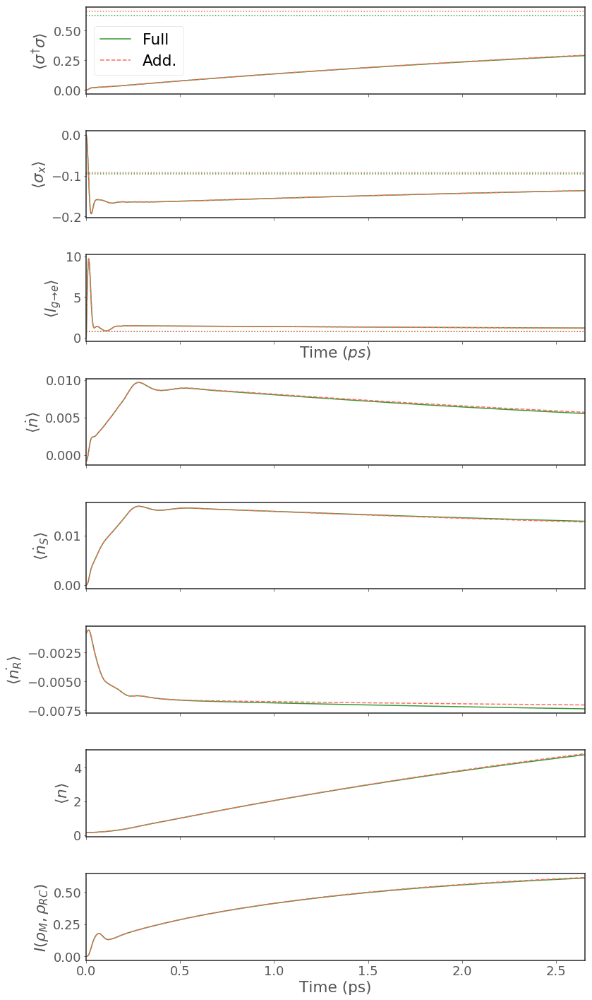

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


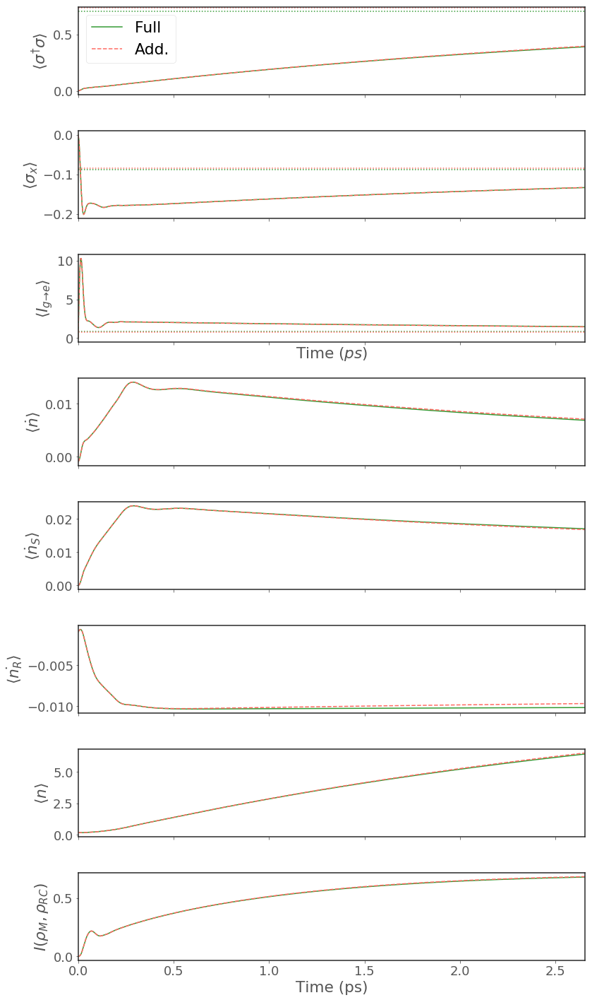

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


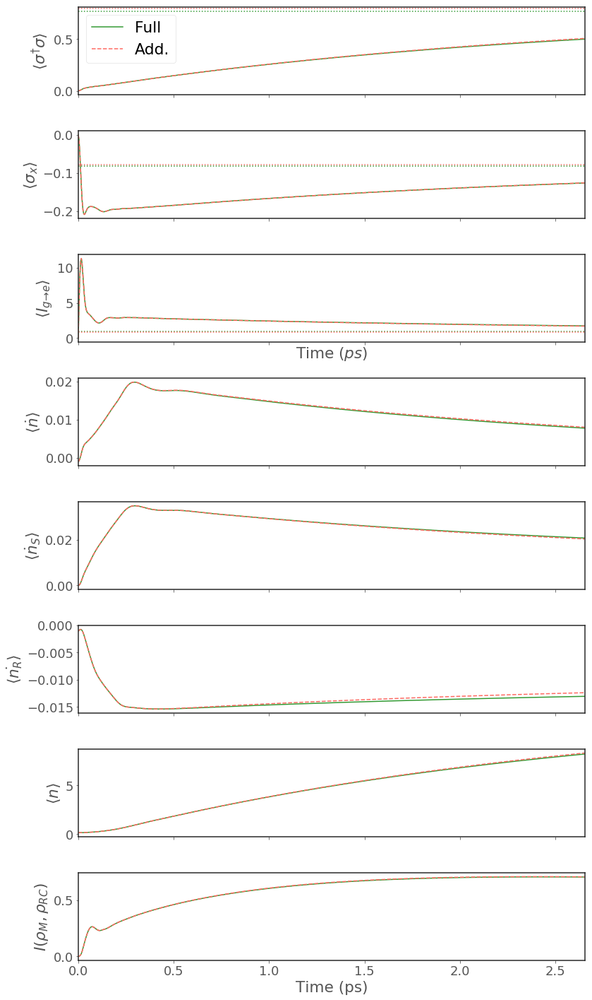

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


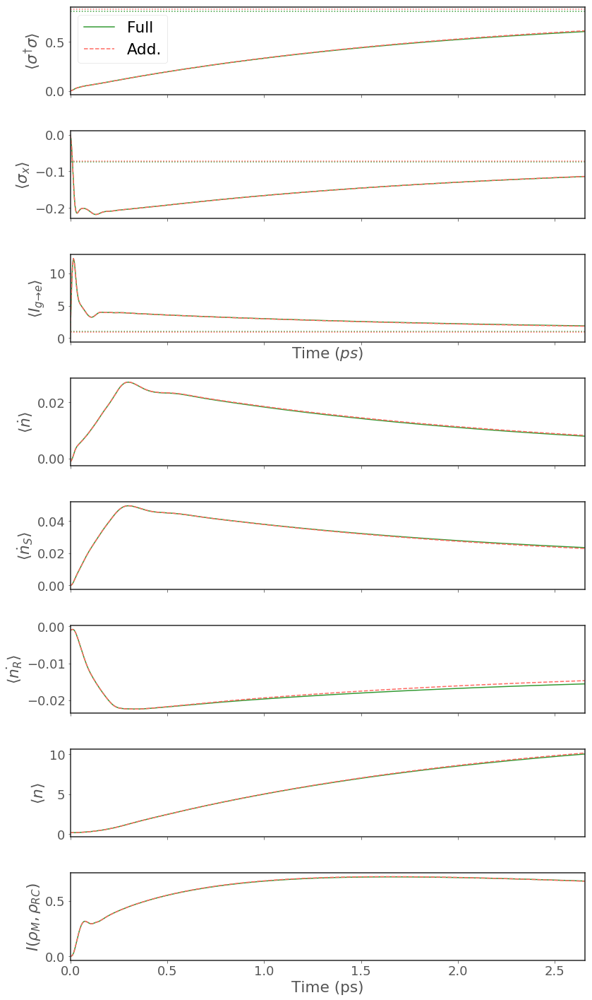

USING N=16
Detuning : 0.0097meV | w0 : 12.00meV
Dynamics complete


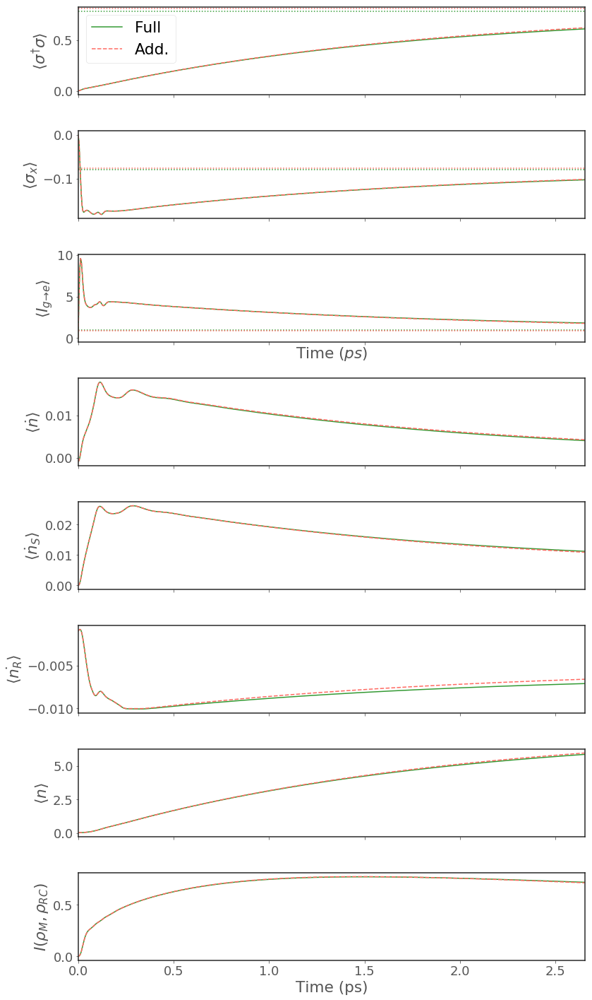

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


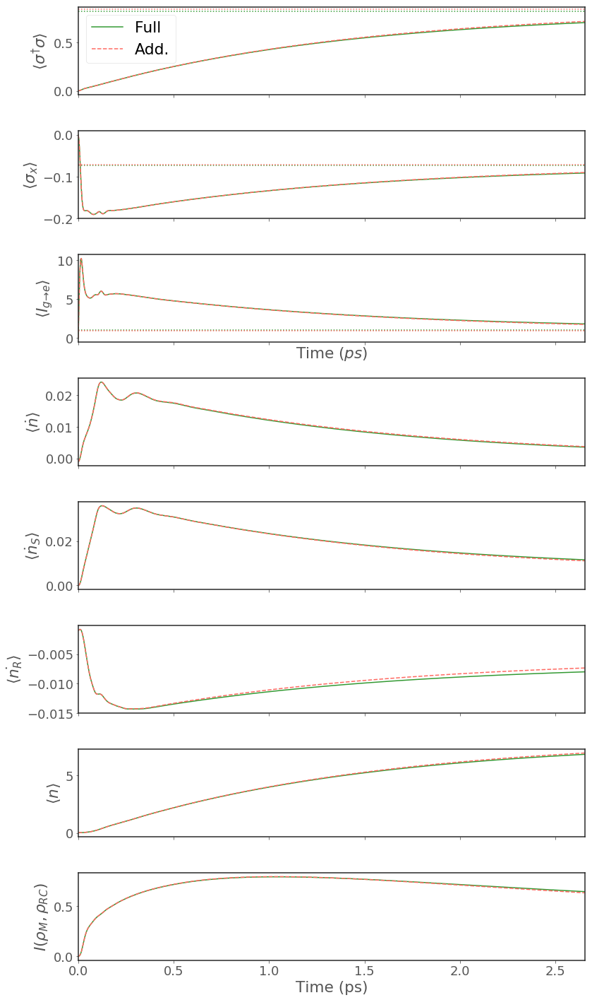

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


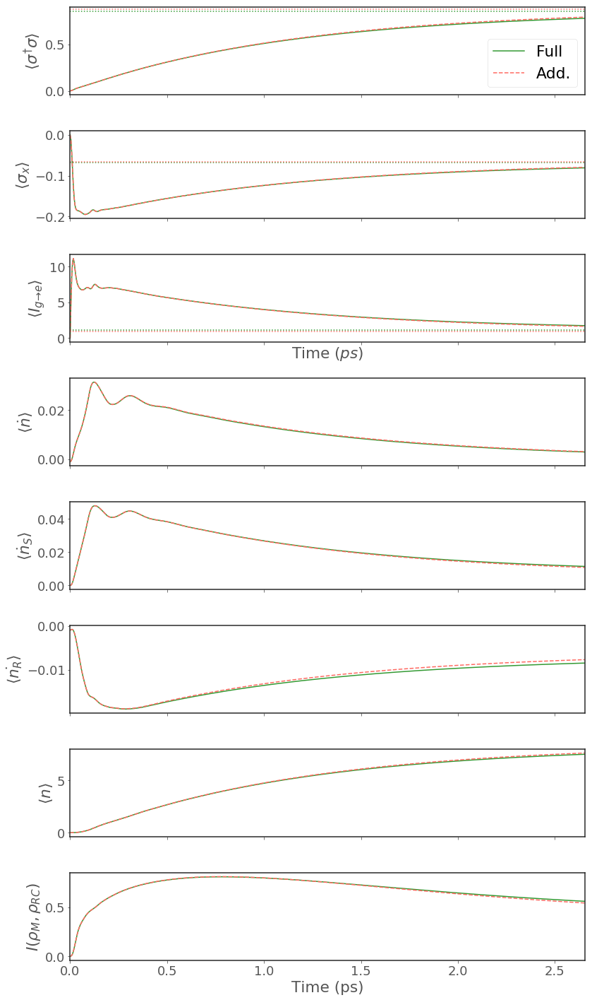

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


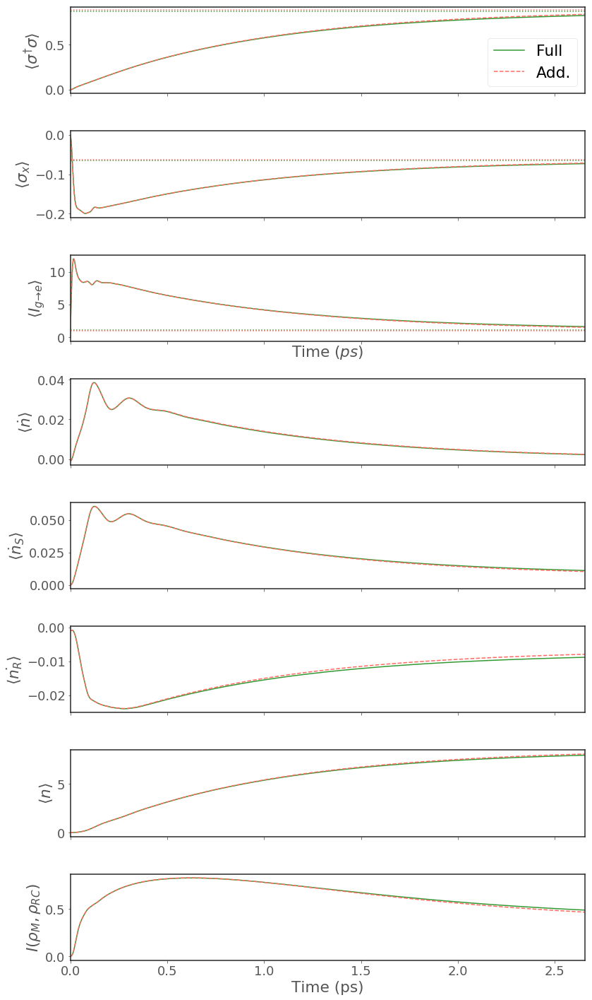

USING N=13
Detuning : 0.0097meV | w0 : 18.00meV
Dynamics complete


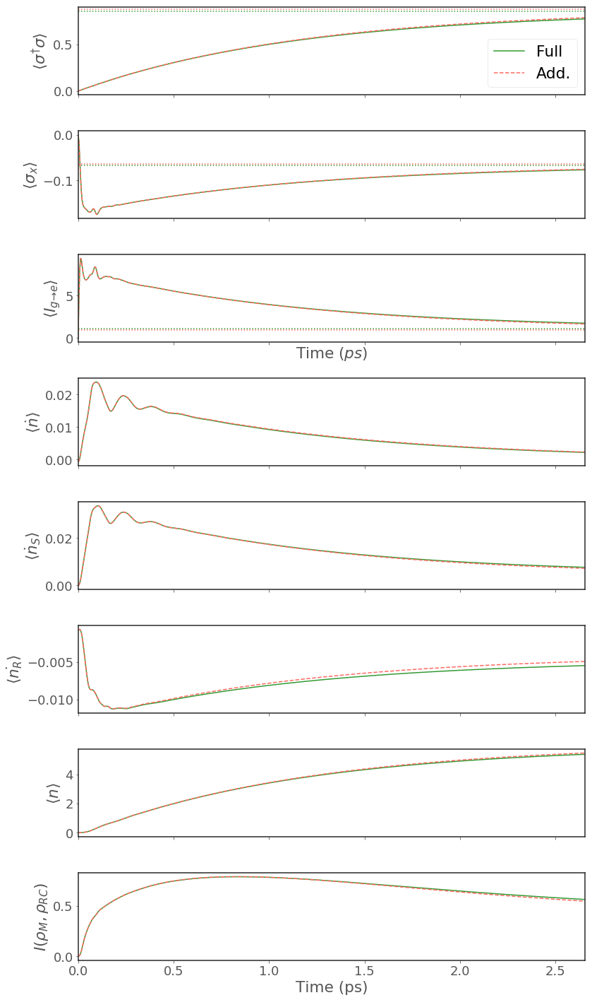

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


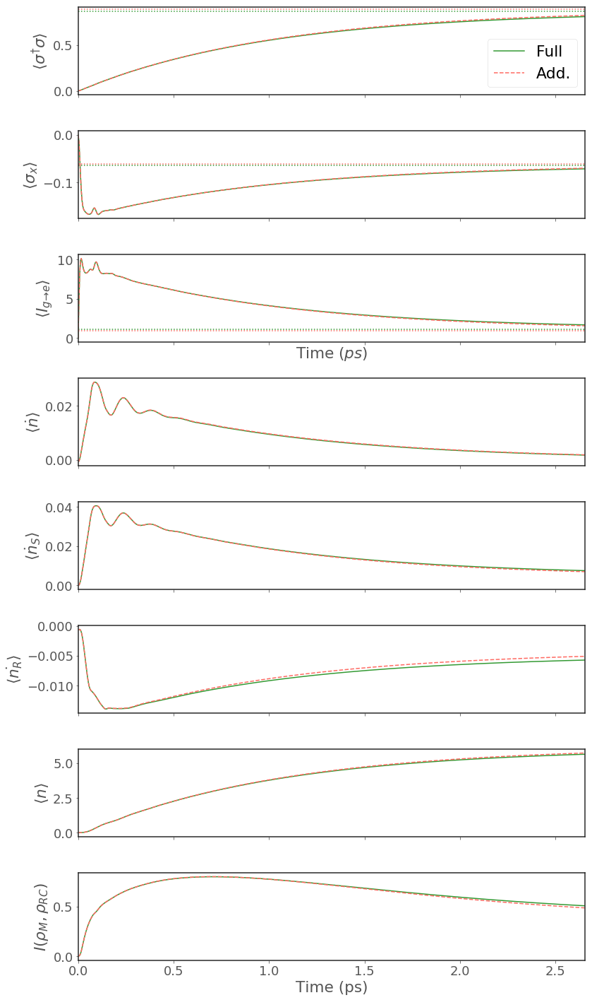

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


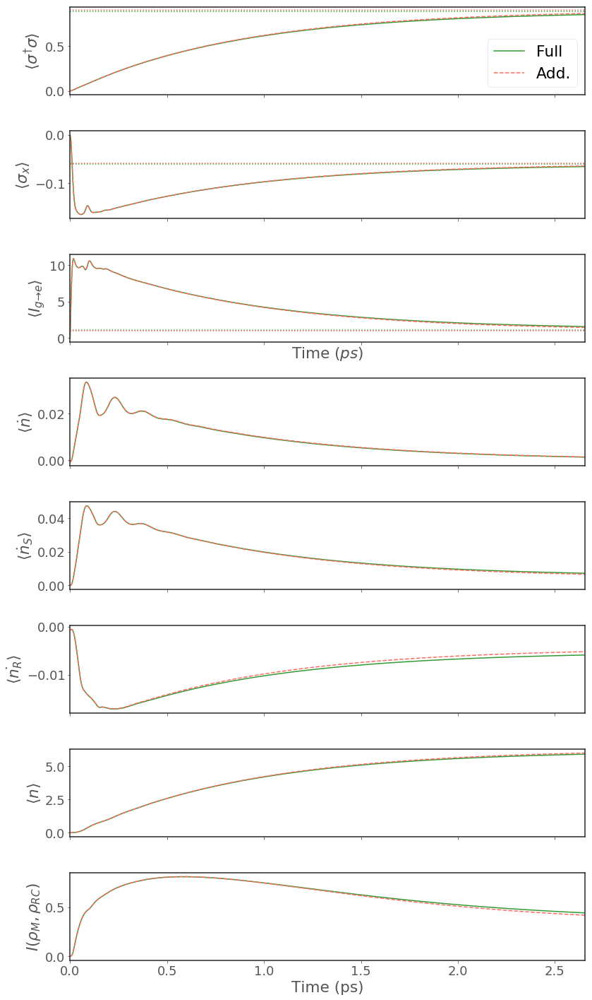

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


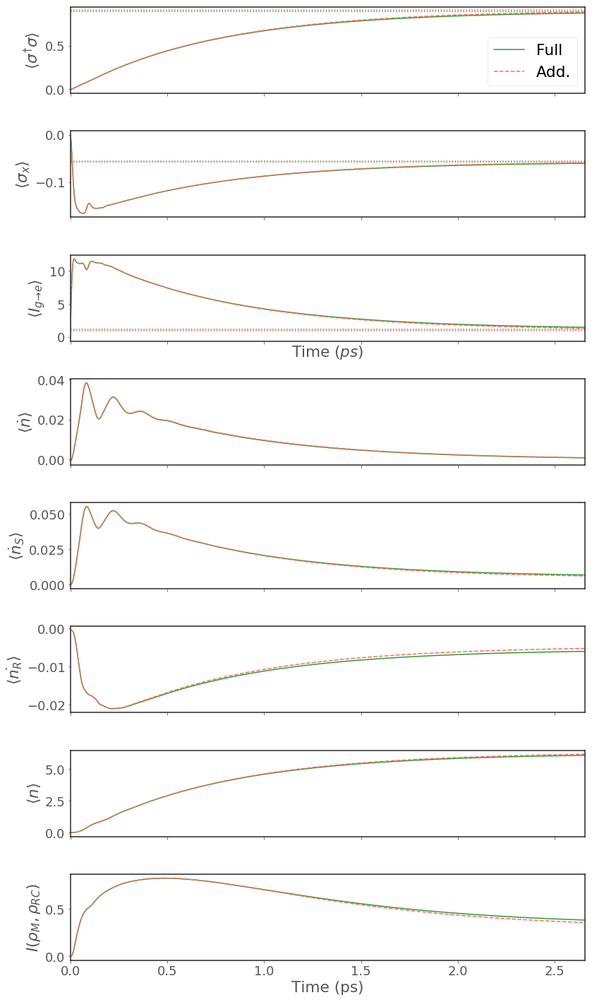

In [15]:
# low T, strong coupling and intermediate Rabi 
T=35
alpha=100e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 10e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

Error could only converge to 0.0035054045983088675
USING N=24
Detuning : 0.0097meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


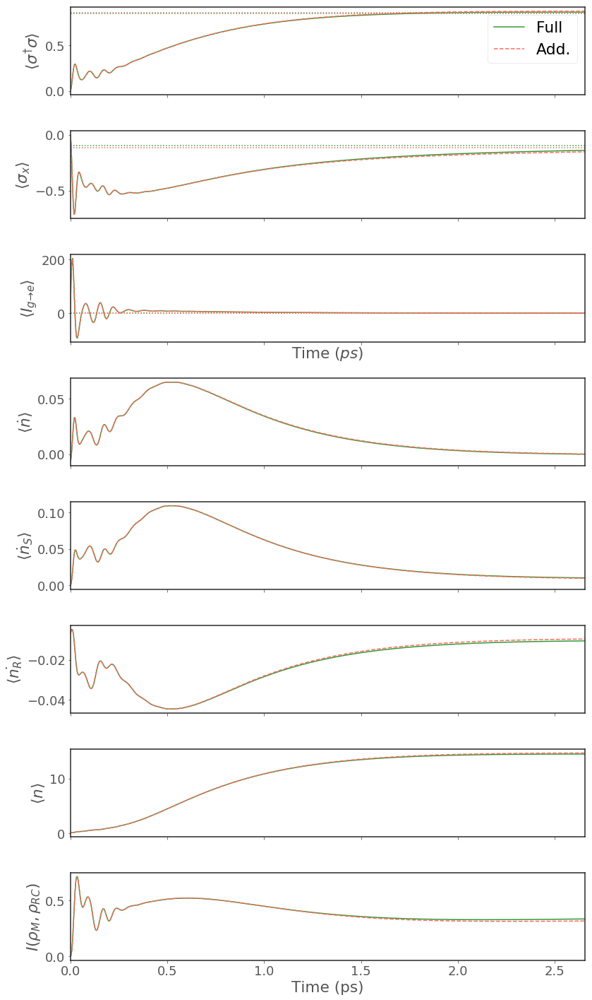

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


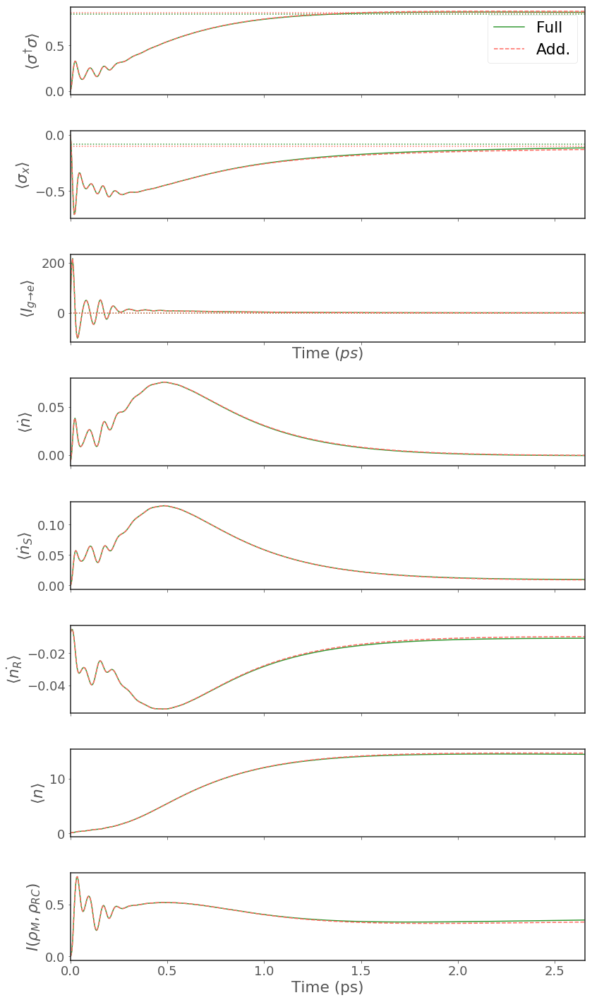

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


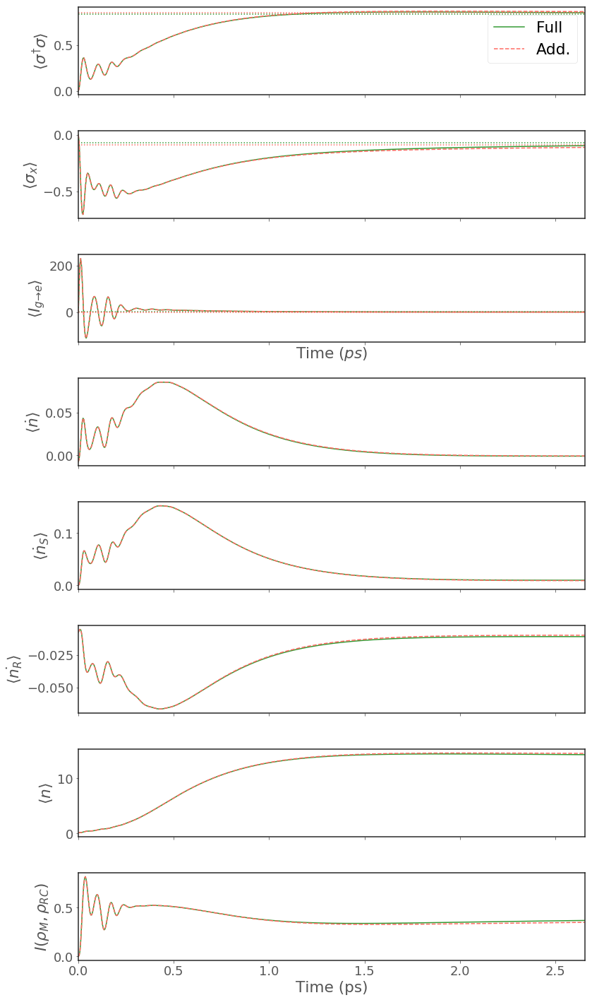

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


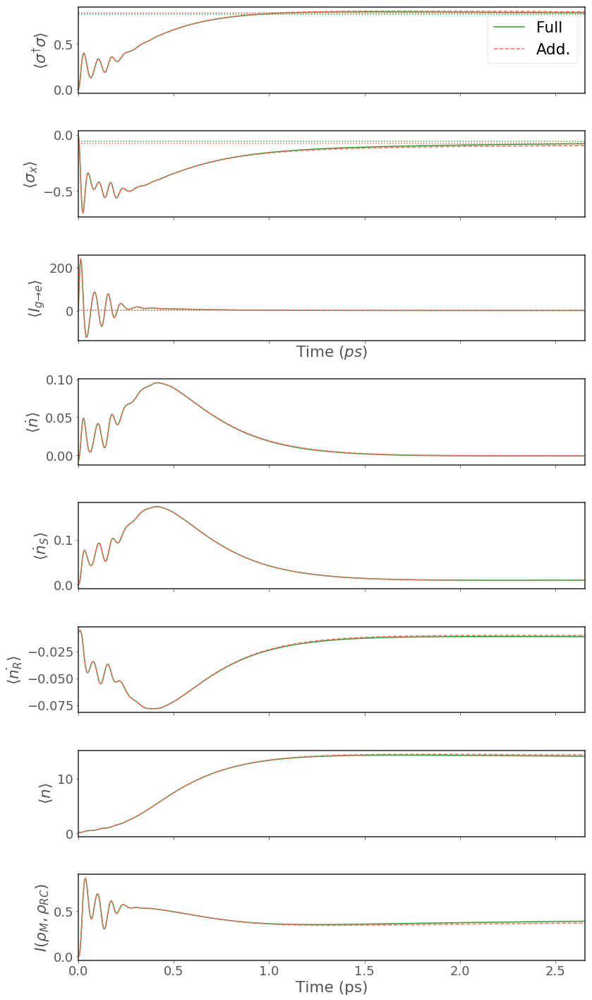

USING N=16
Detuning : 0.0097meV | w0 : 12.00meV
Dynamics complete


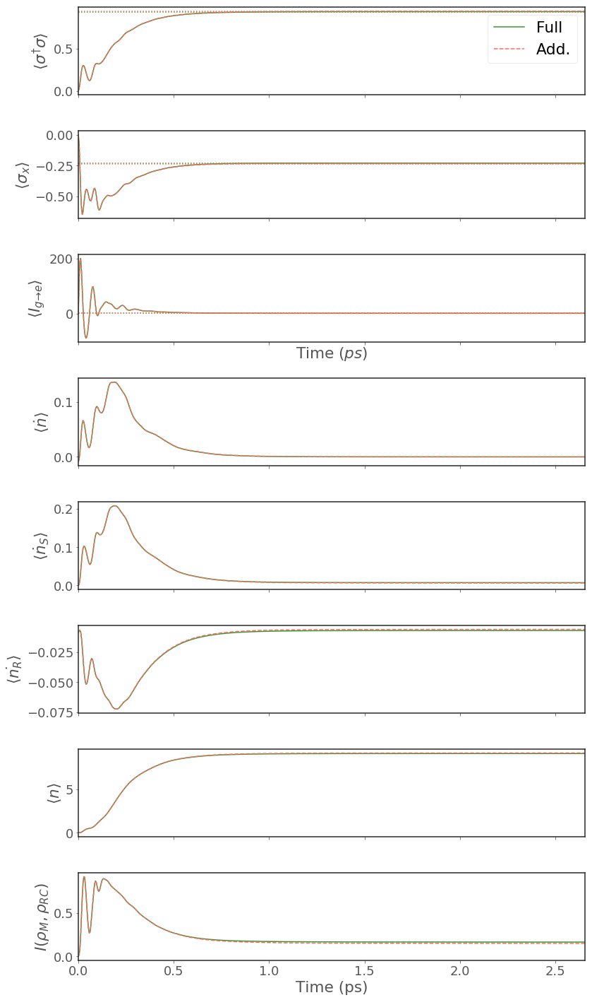

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


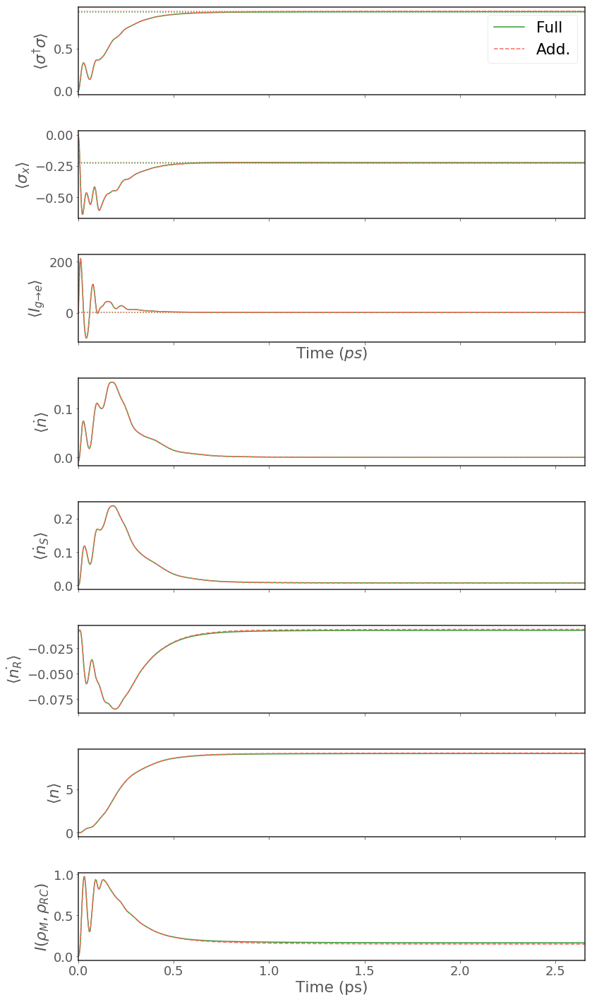

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


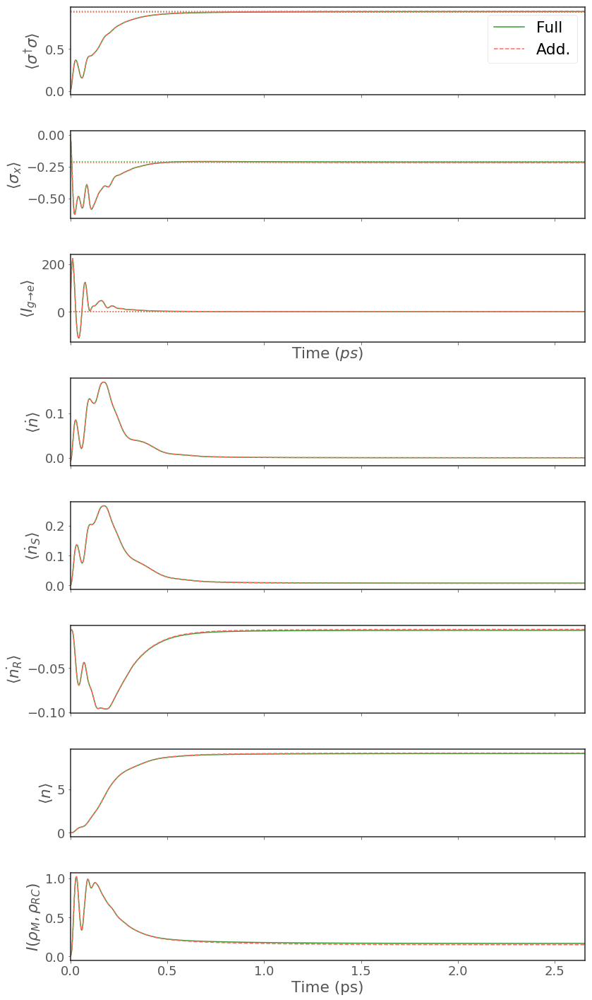

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


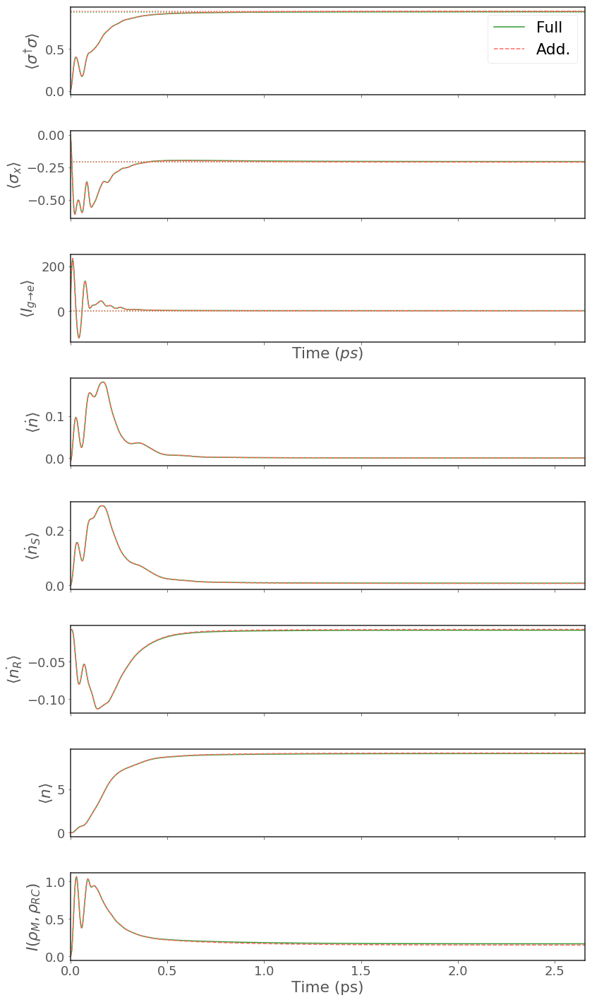

USING N=13
Detuning : 0.0097meV | w0 : 18.00meV
Dynamics complete


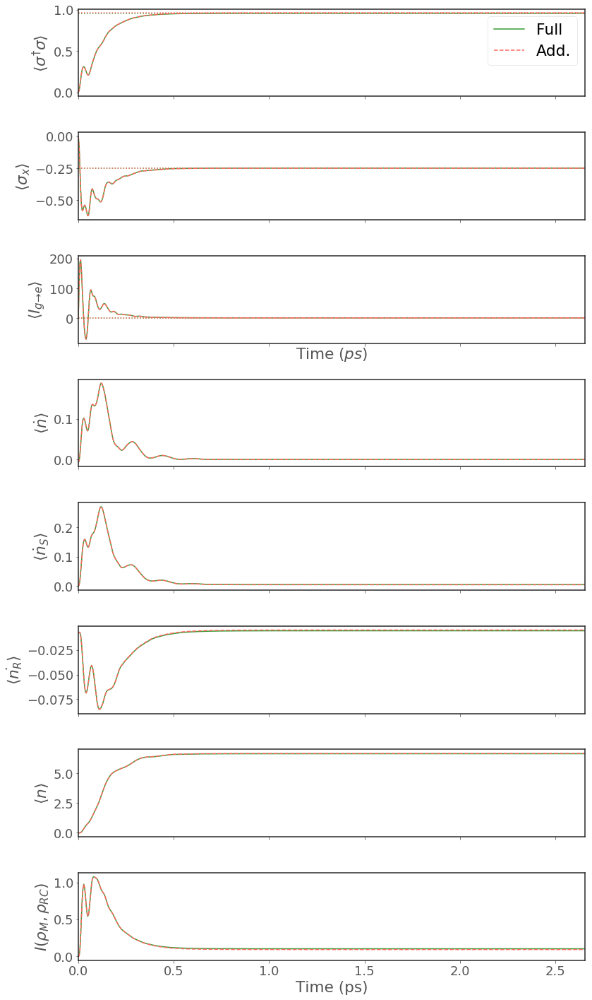

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


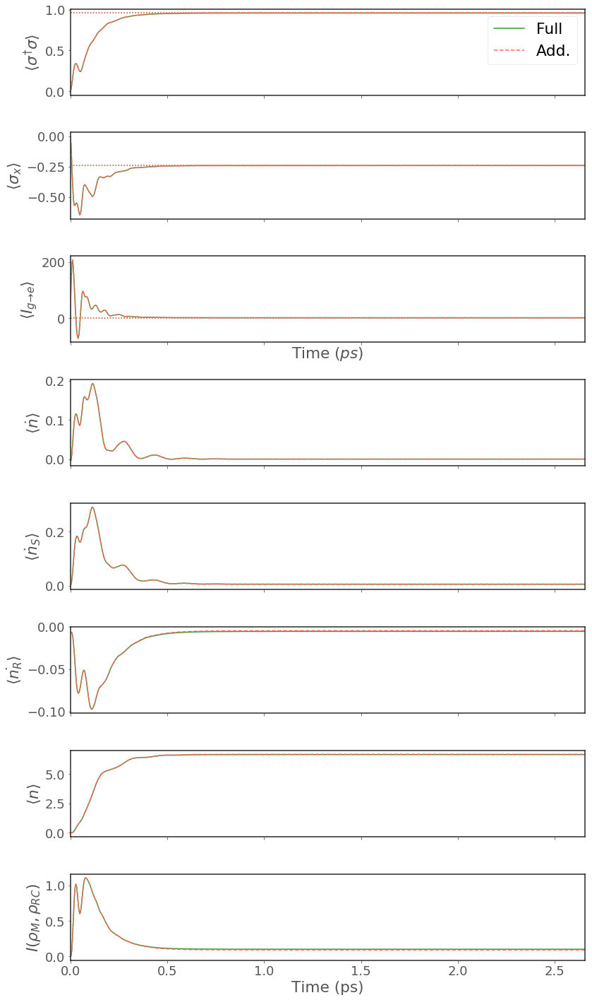

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


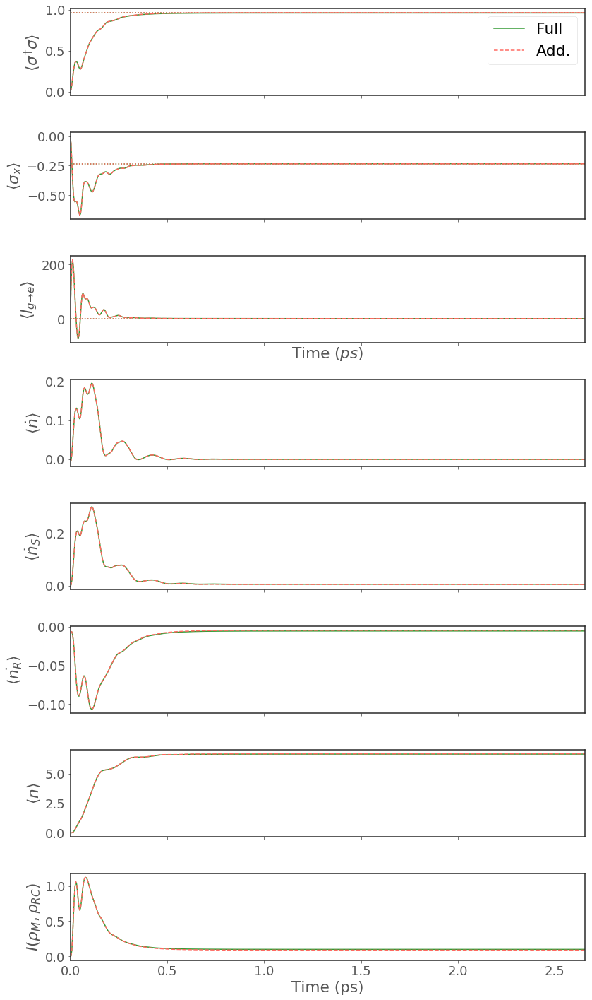

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


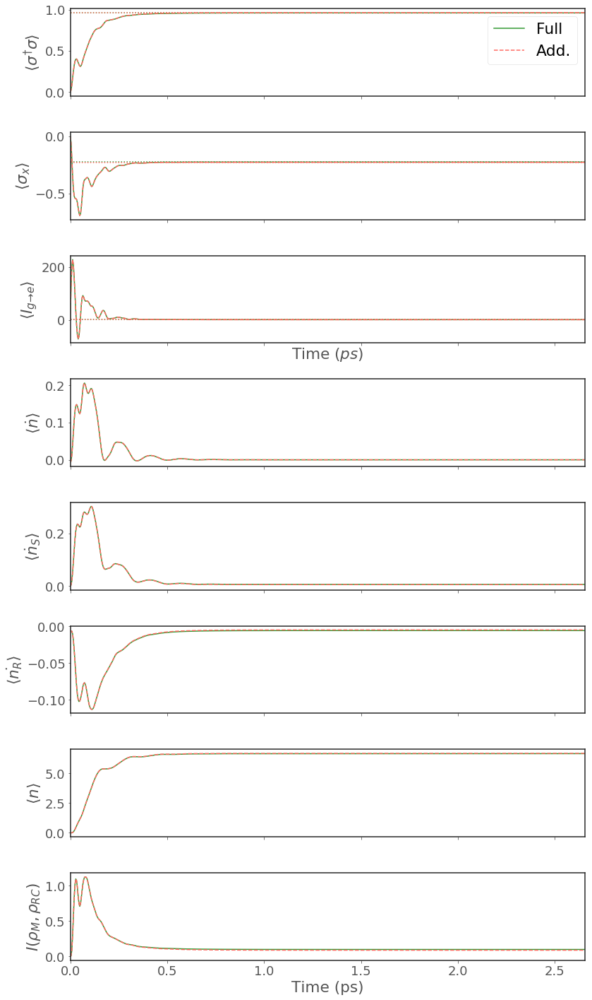

In [16]:
# low T, strong coupling and strong Rabi 
T=35
alpha=100e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 50e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

USING N=9
Detuning : 0.0010meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


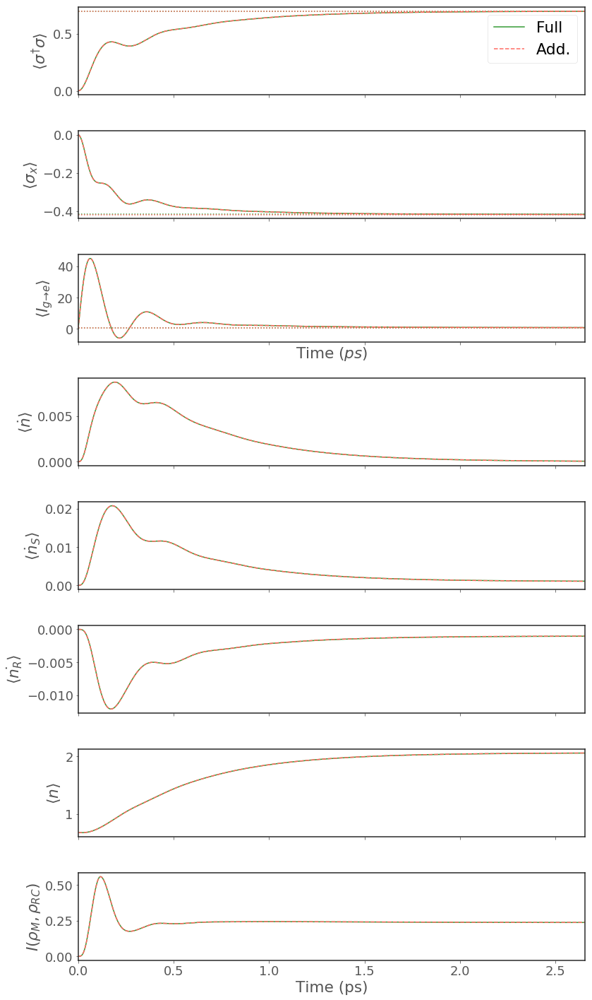

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


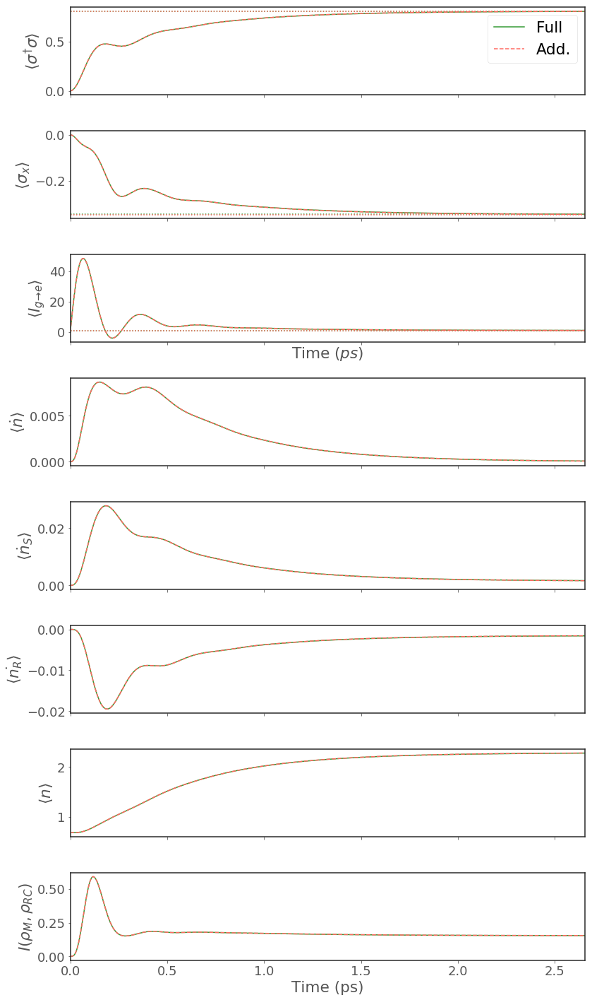

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


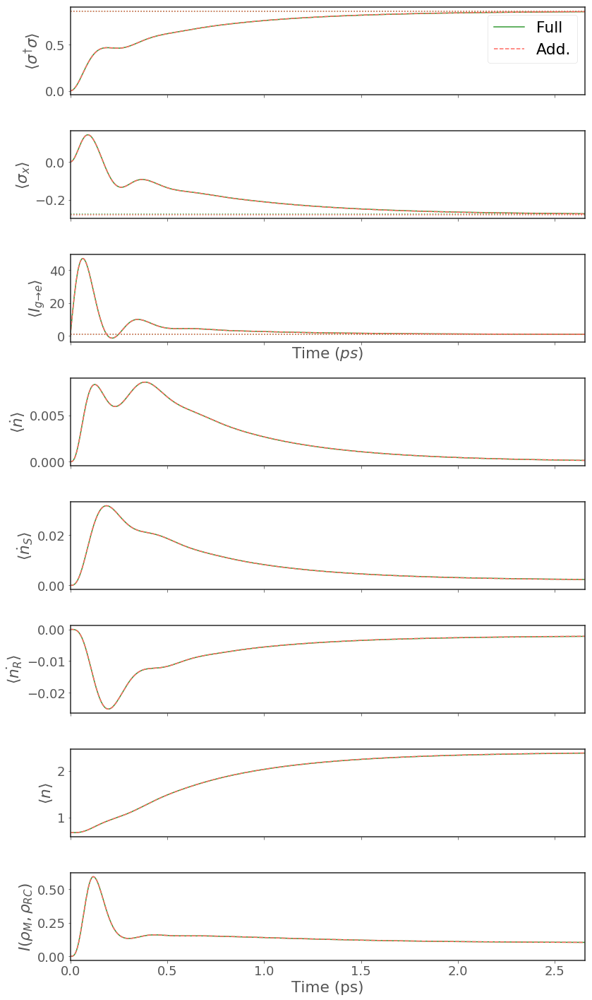

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


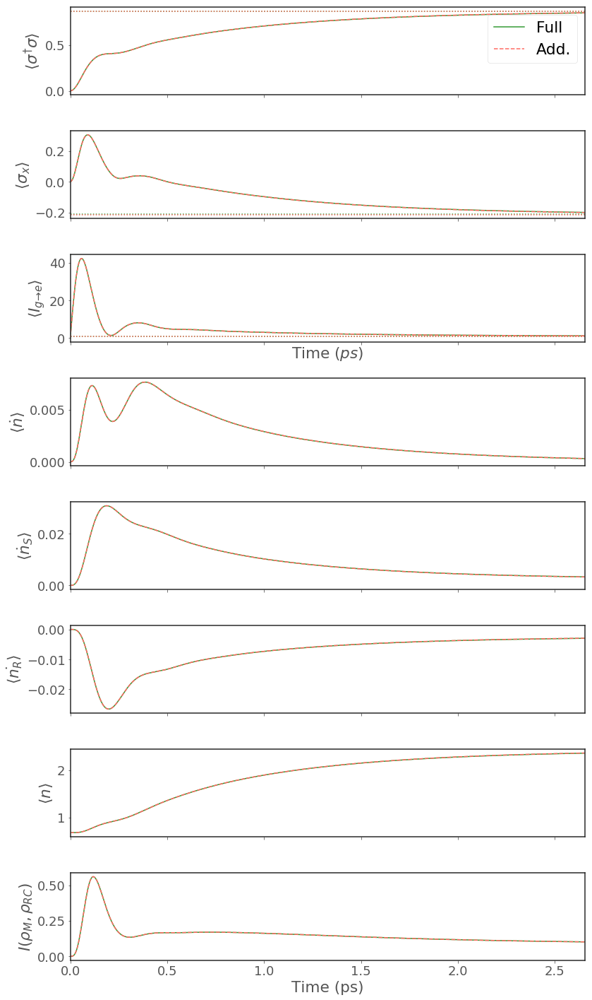

USING N=8
Detuning : 0.0010meV | w0 : 12.00meV
Dynamics complete


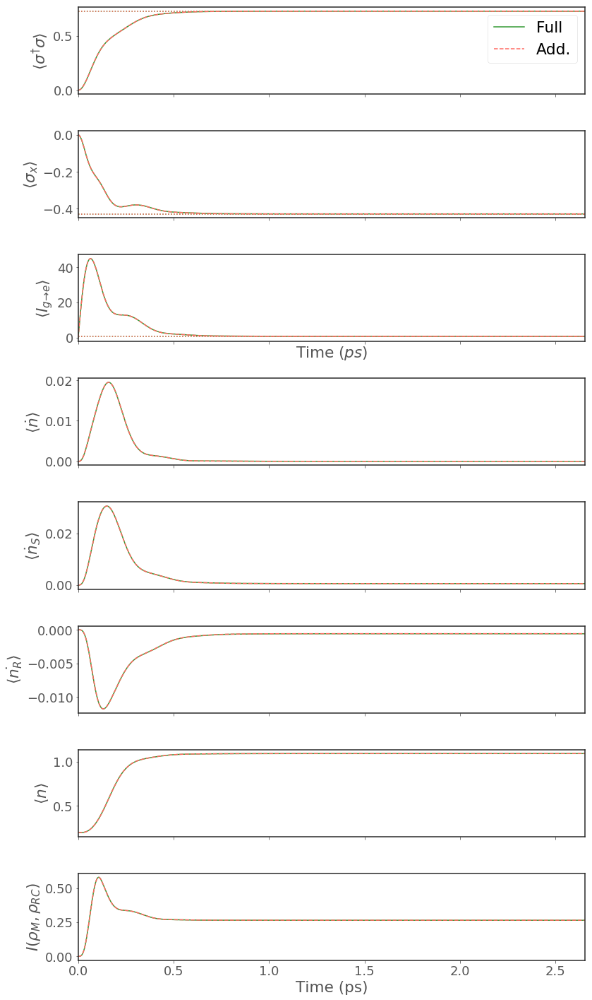

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


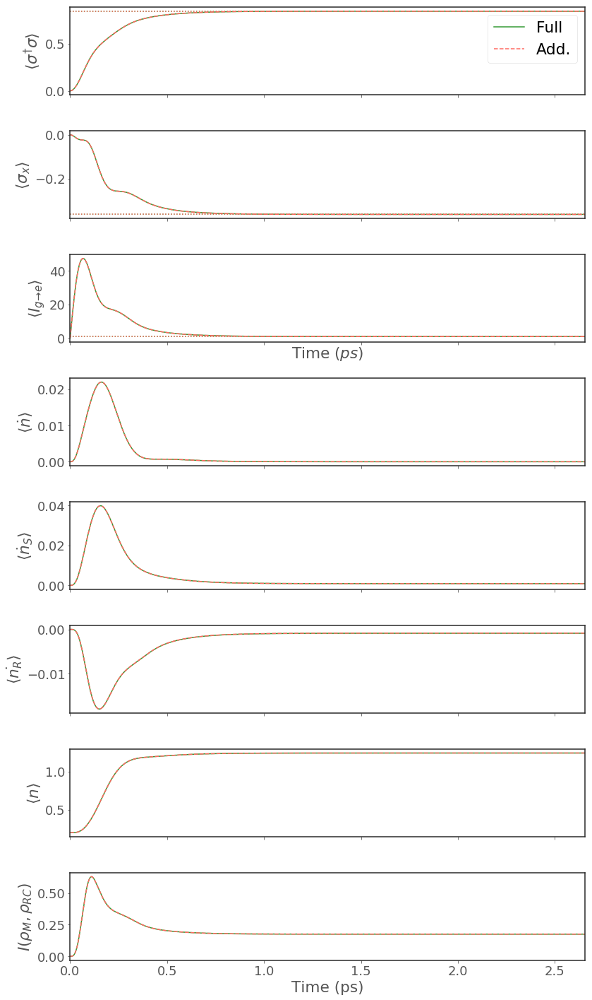

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


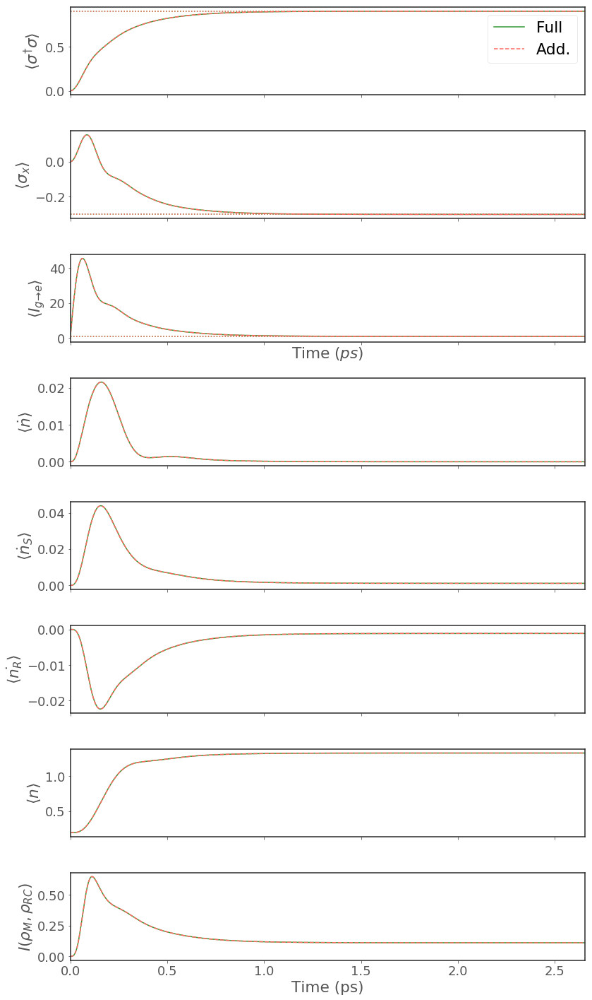

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


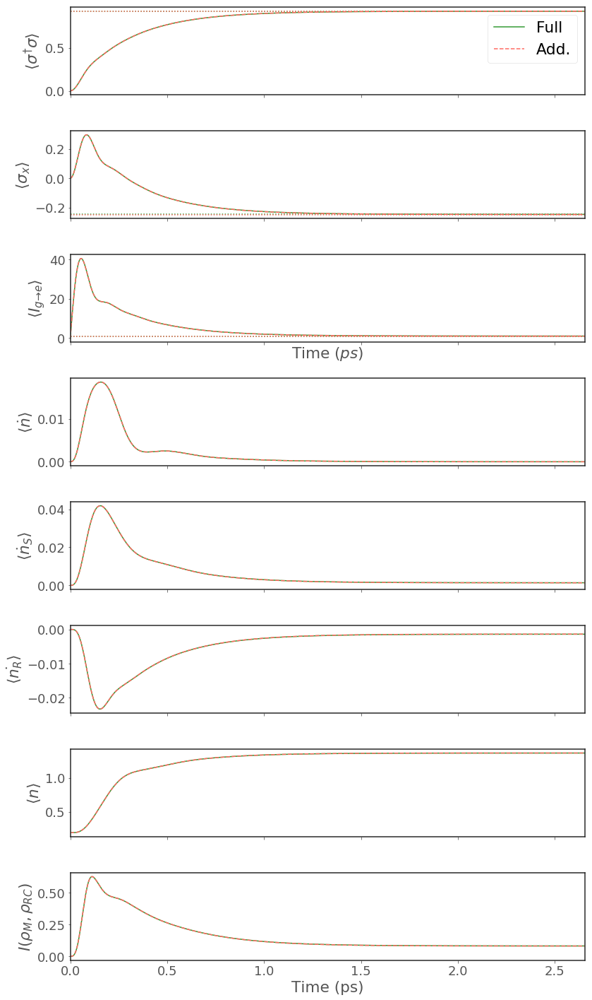

USING N=7
Detuning : 0.0010meV | w0 : 18.00meV
Dynamics complete


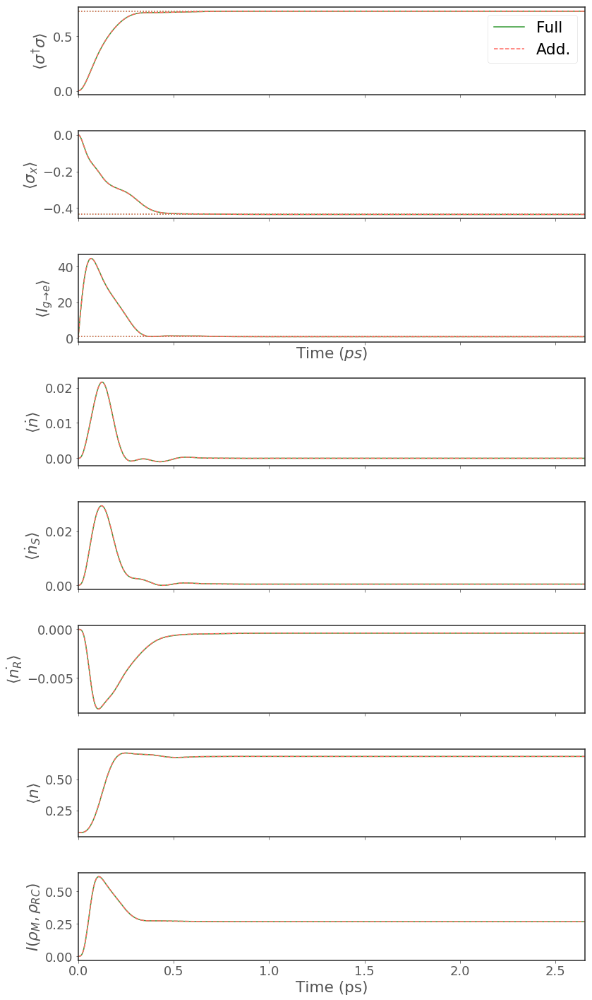

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


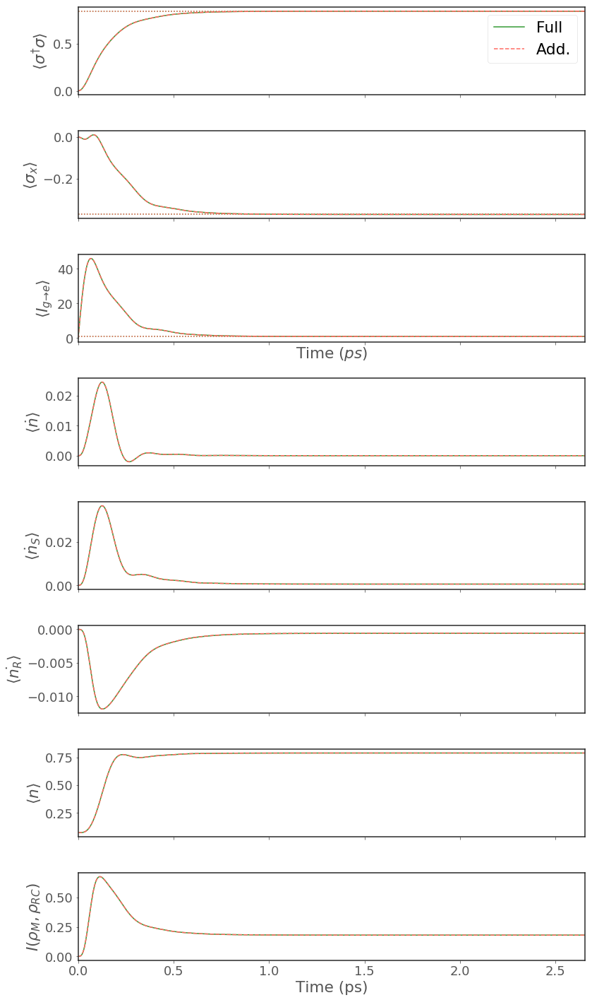

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


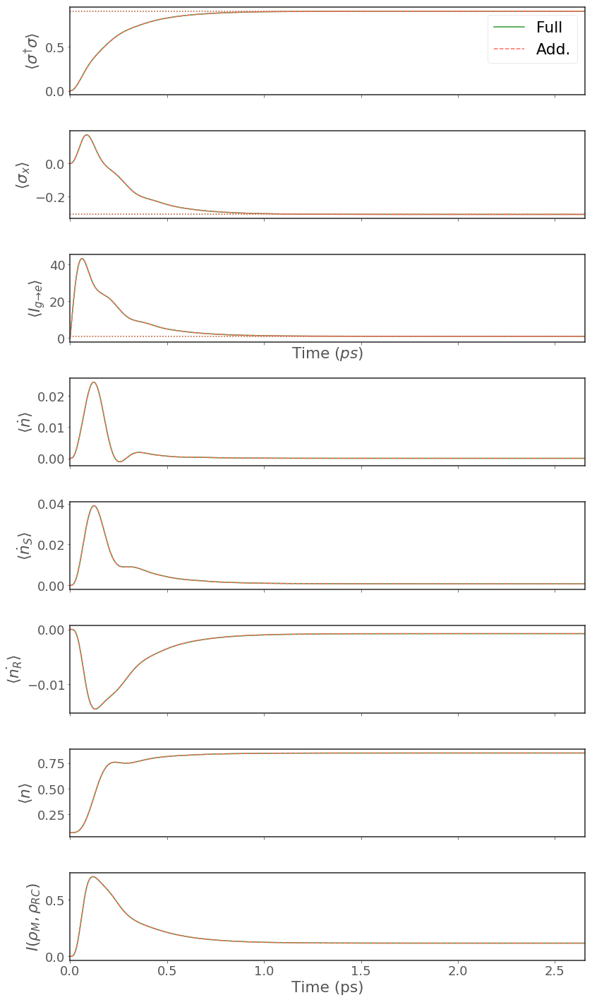

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


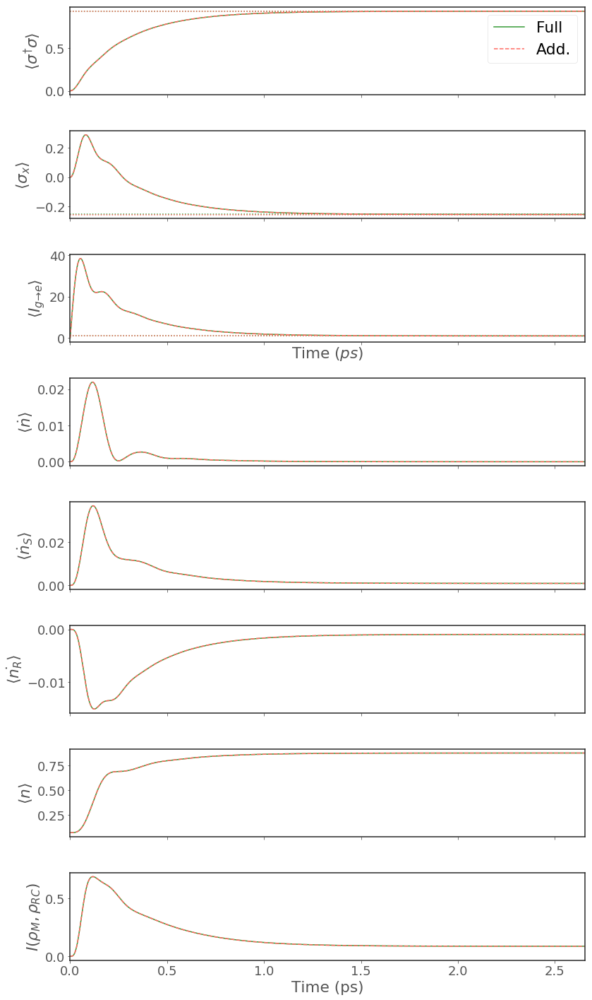

In [17]:
# higher T, intermediate coupling and Rabi 
T=77
alpha=10e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 10e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

USING N=9
Detuning : 0.0010meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


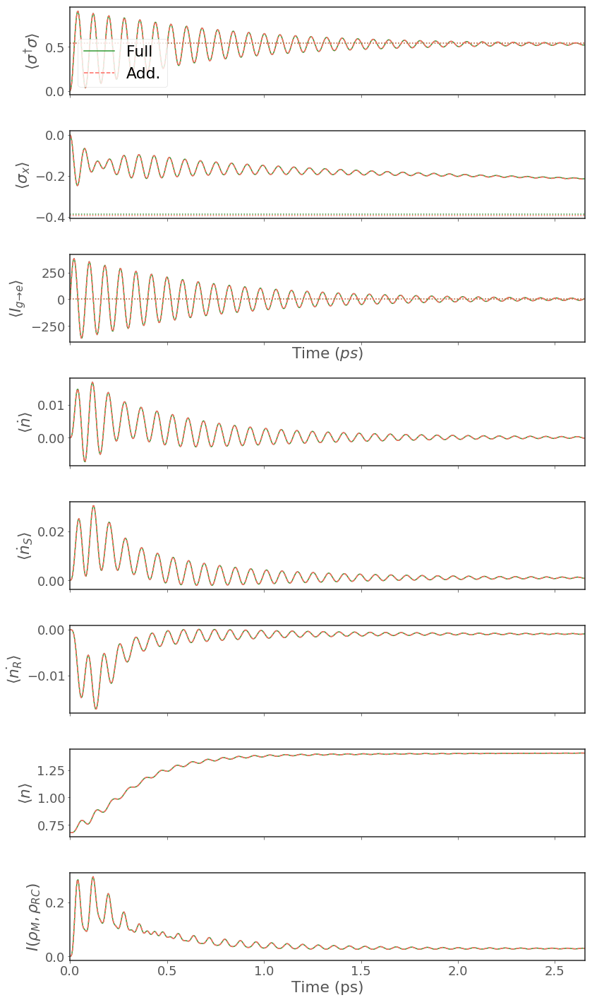

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


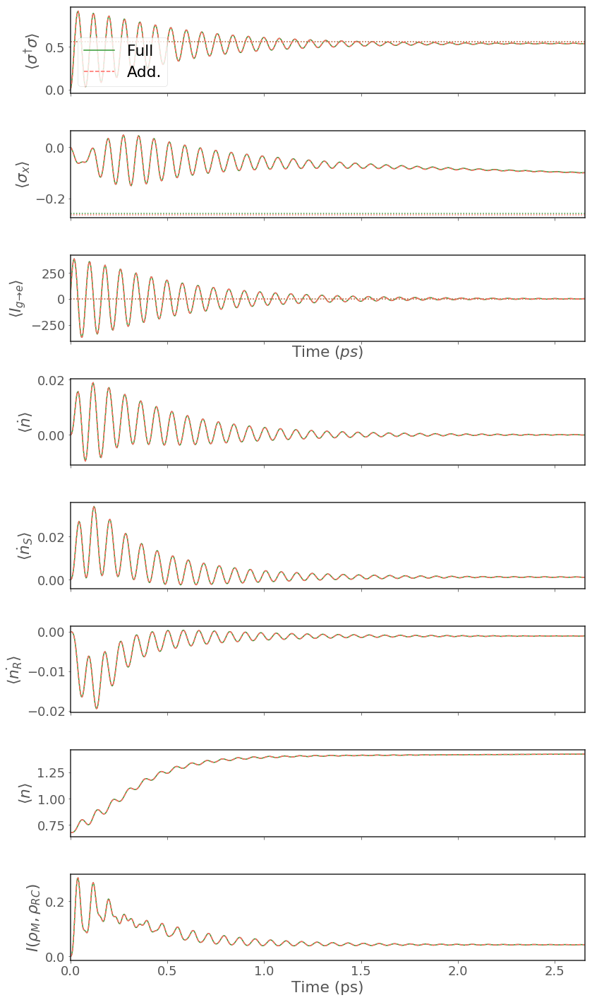

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


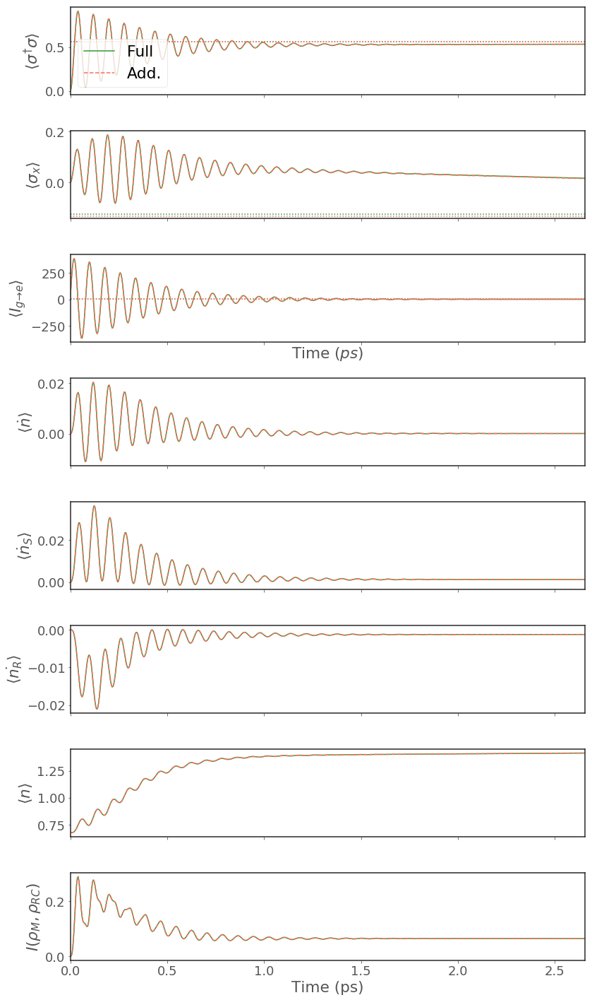

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


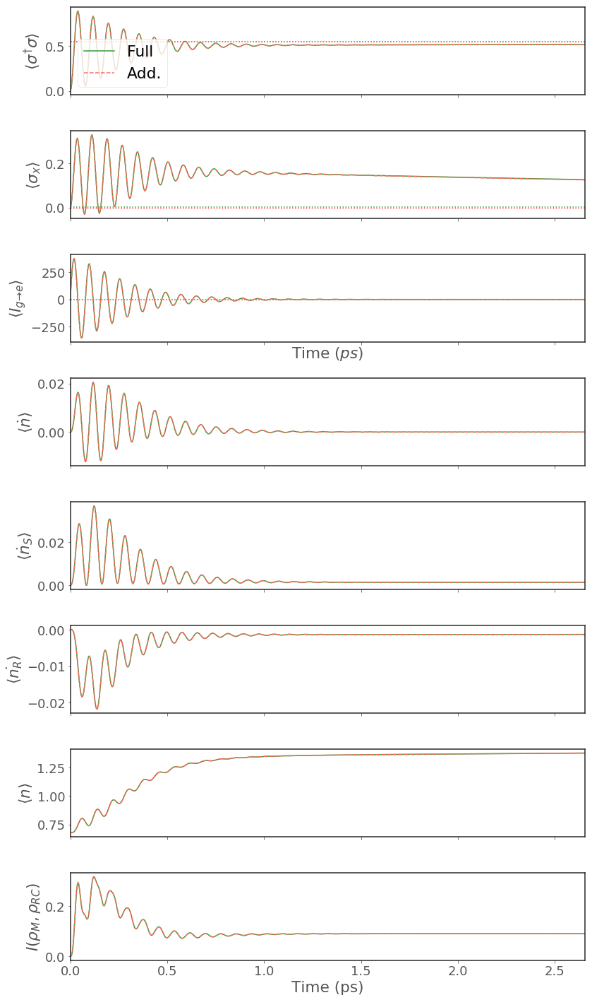

USING N=8
Detuning : 0.0010meV | w0 : 12.00meV
Dynamics complete


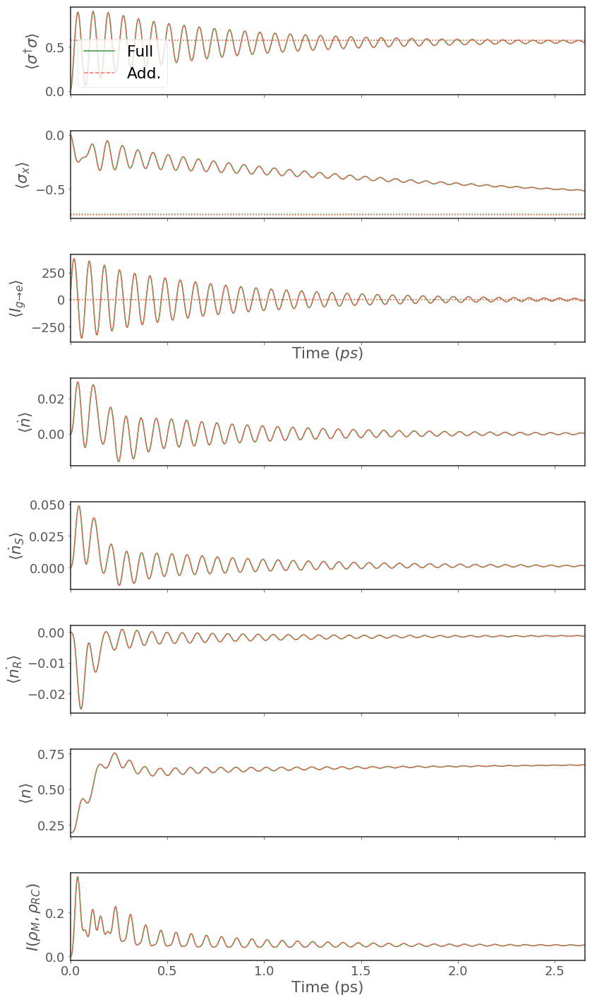

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


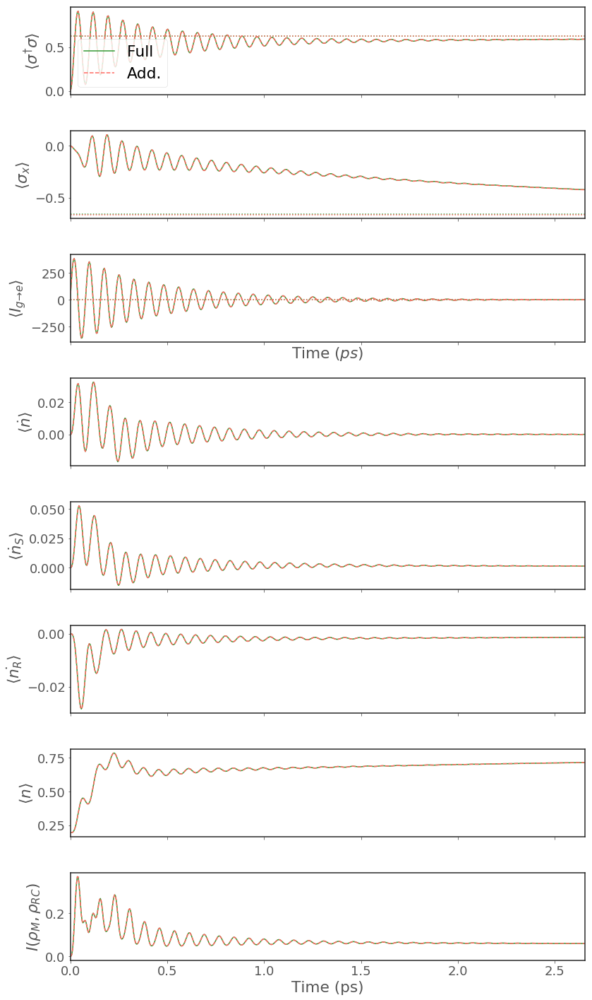

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


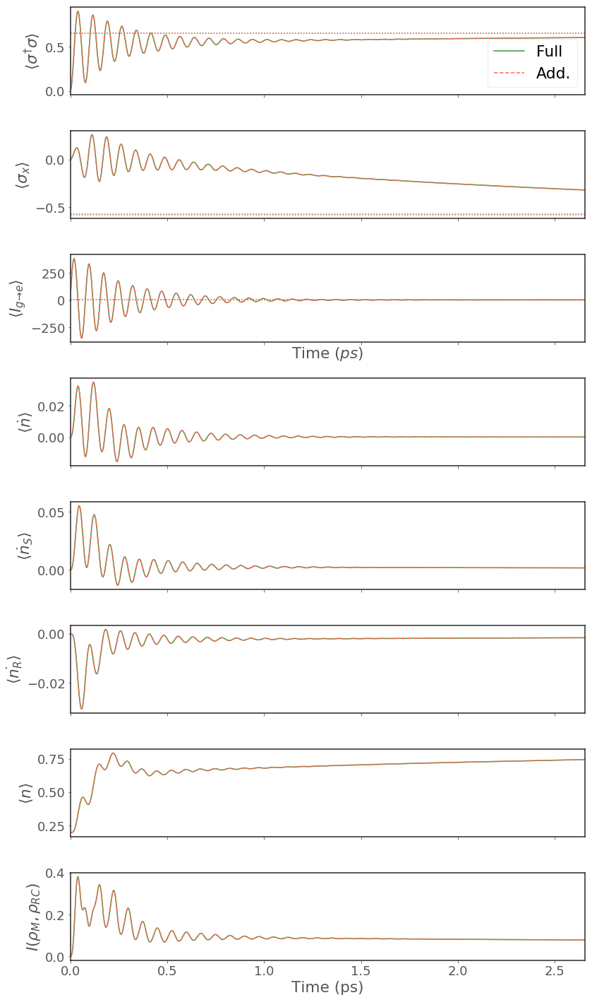

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


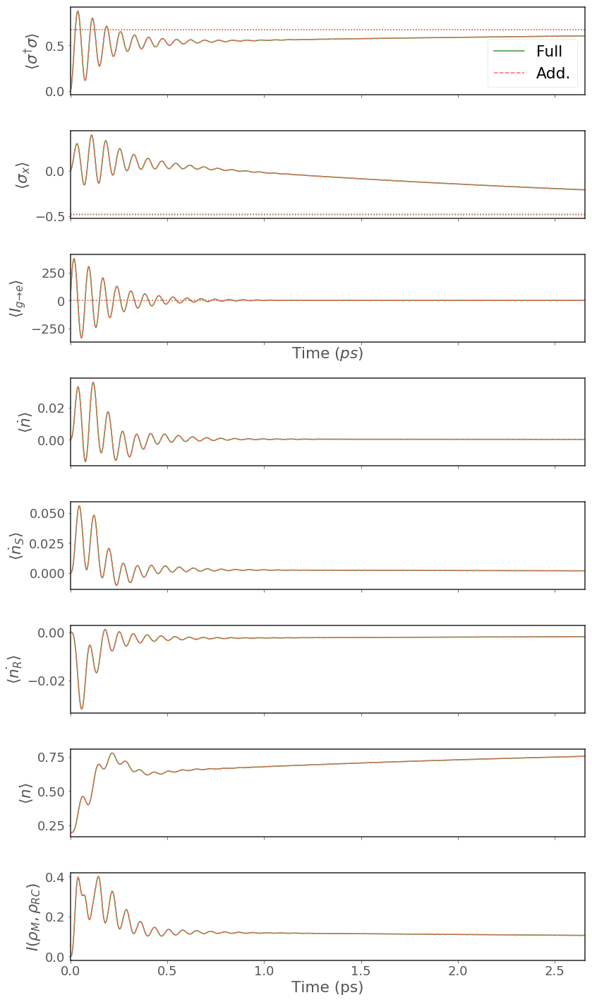

USING N=7
Detuning : 0.0010meV | w0 : 18.00meV
Dynamics complete


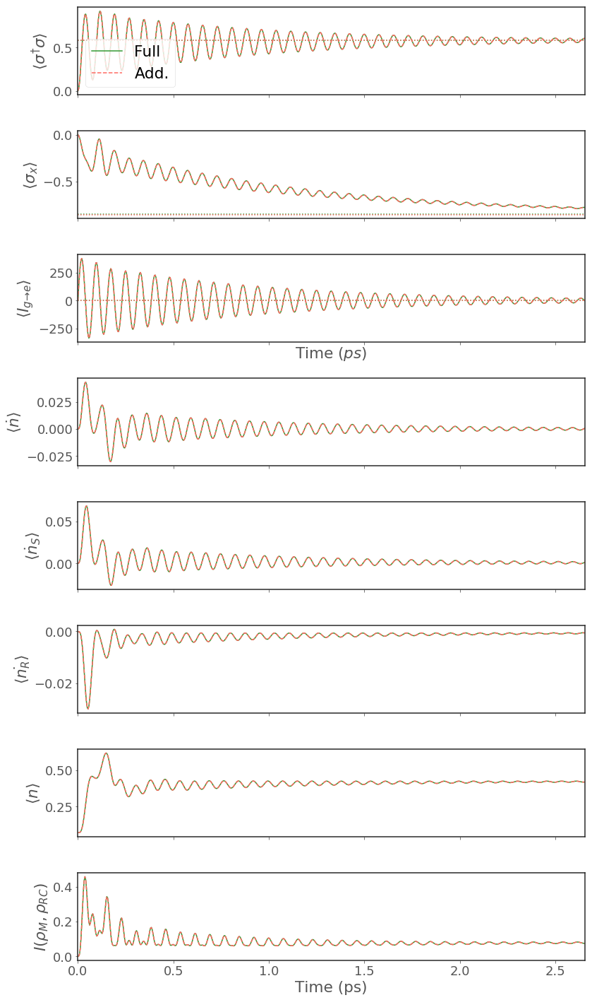

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


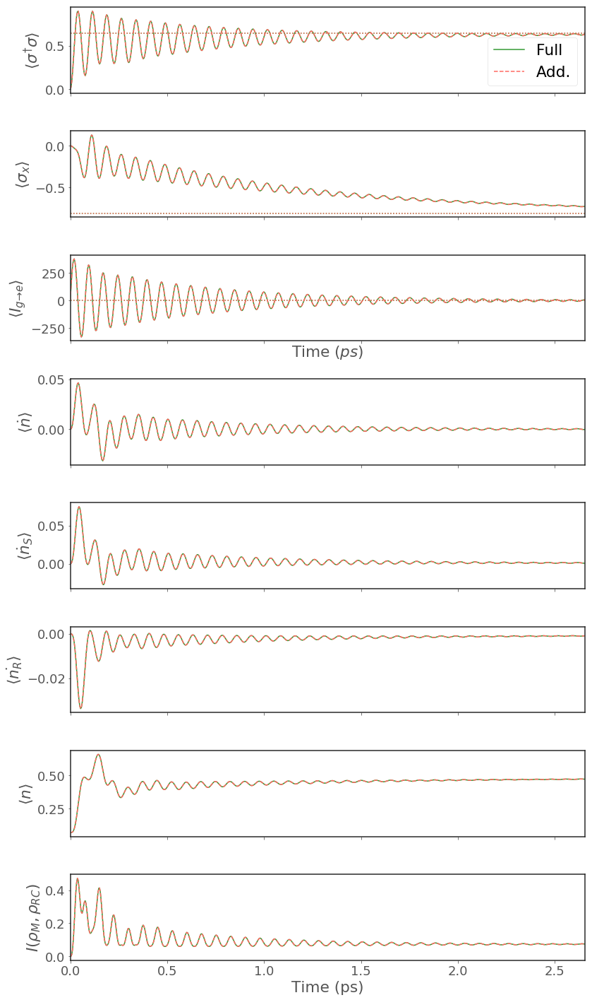

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


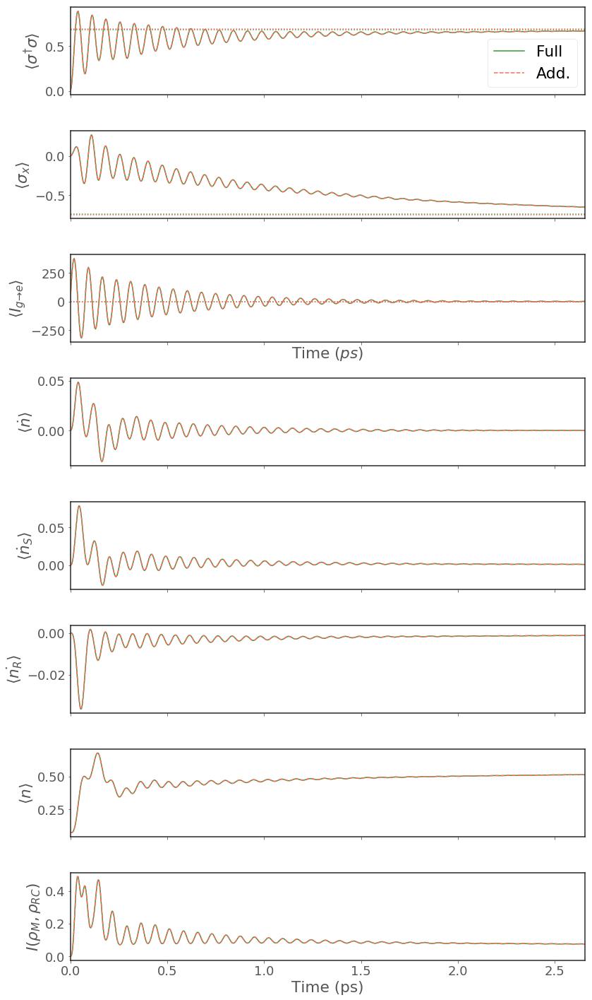

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


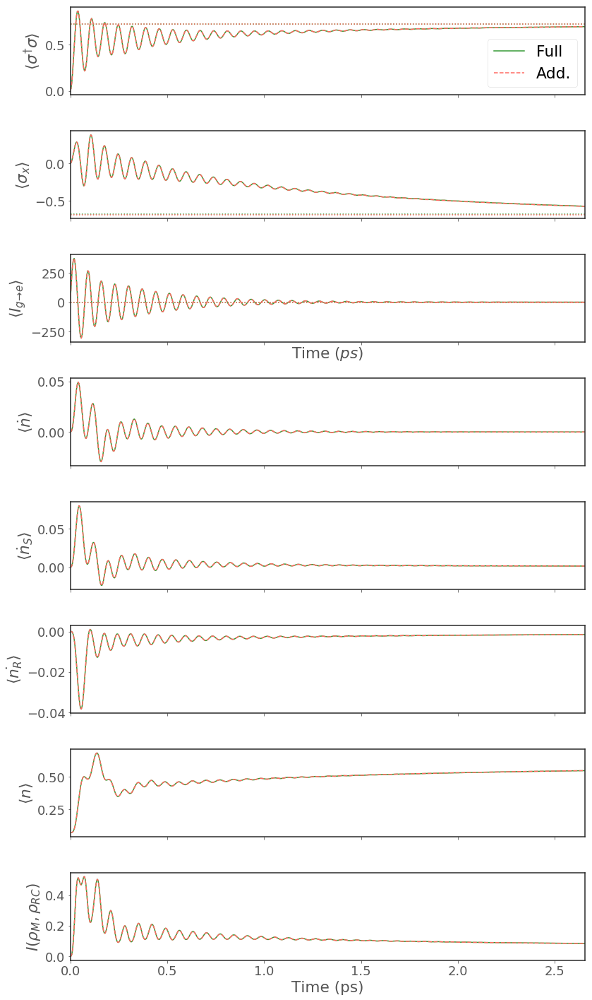

In [18]:
# higher T, intermediate coupling and strong Rabi 
T=77
alpha=10e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 50e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

Error could only converge to 0.4467148608798703
USING N=24
Detuning : 0.0097meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


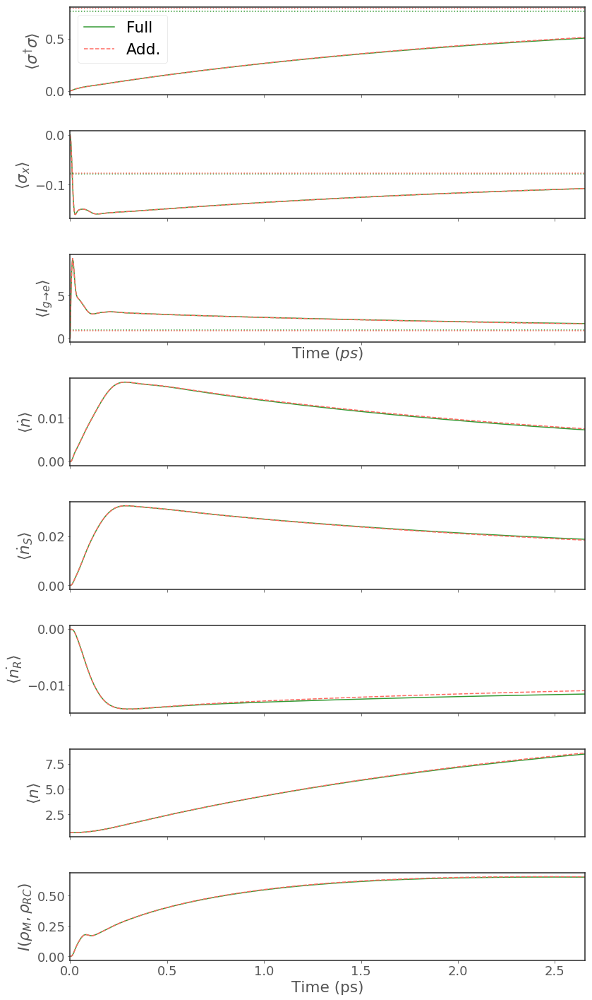

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


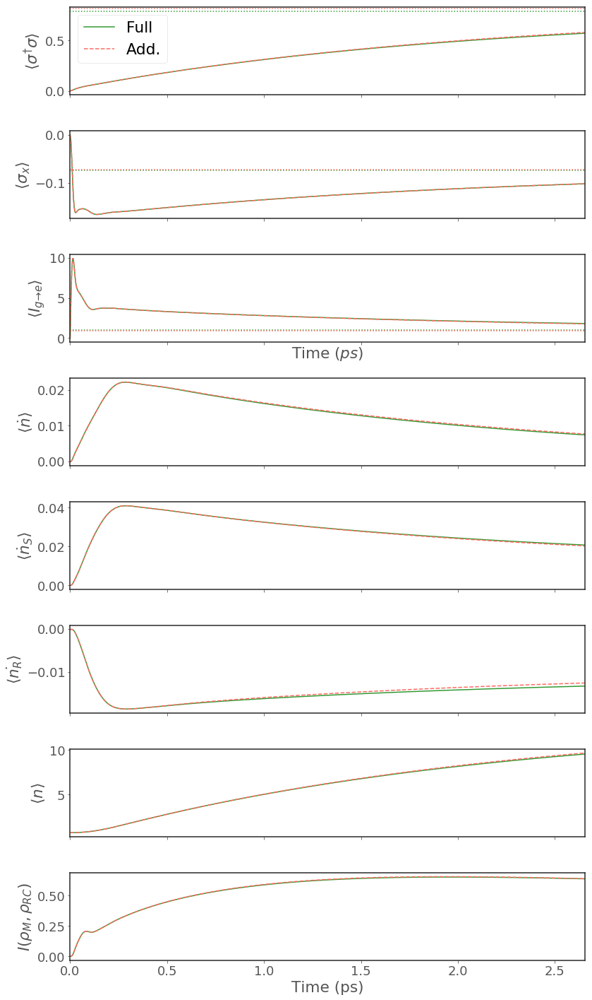

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


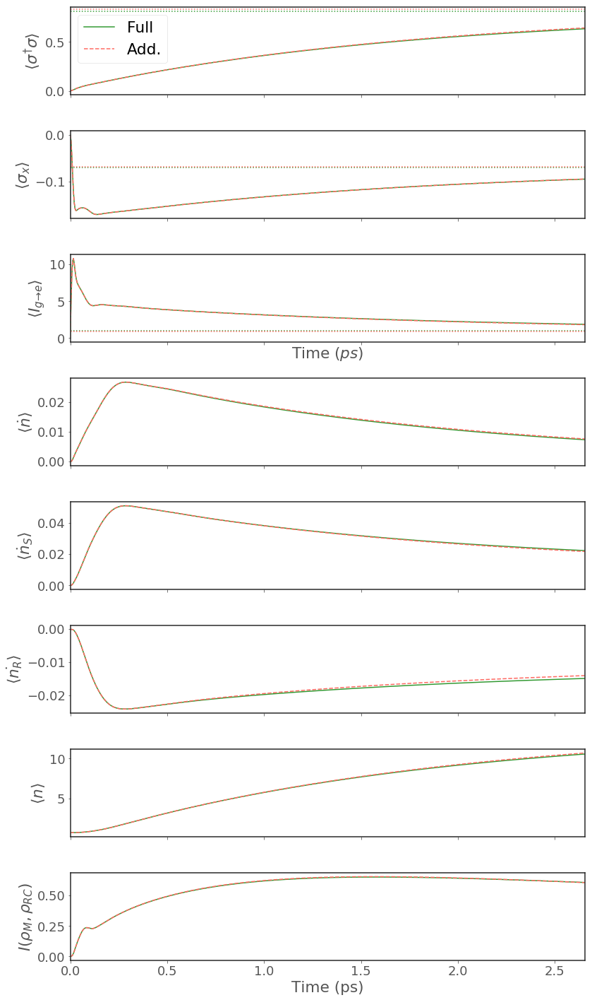

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


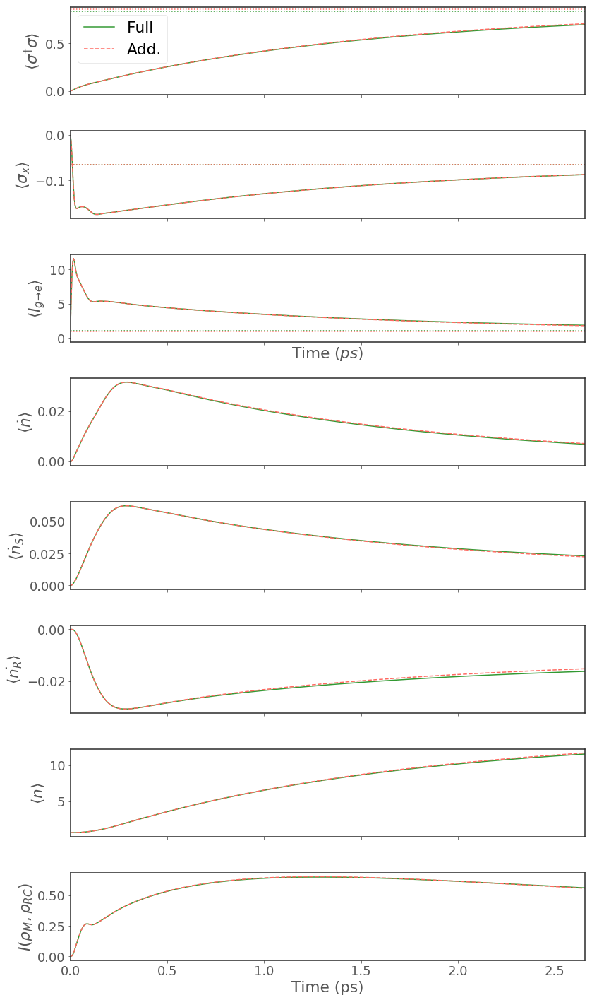

USING N=20
Detuning : 0.0097meV | w0 : 12.00meV
Dynamics complete


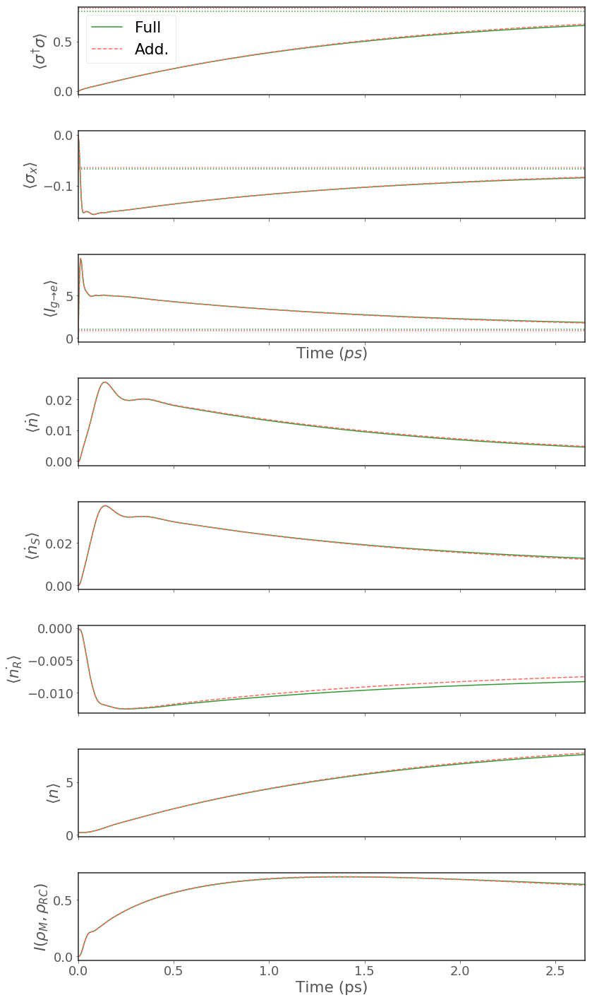

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


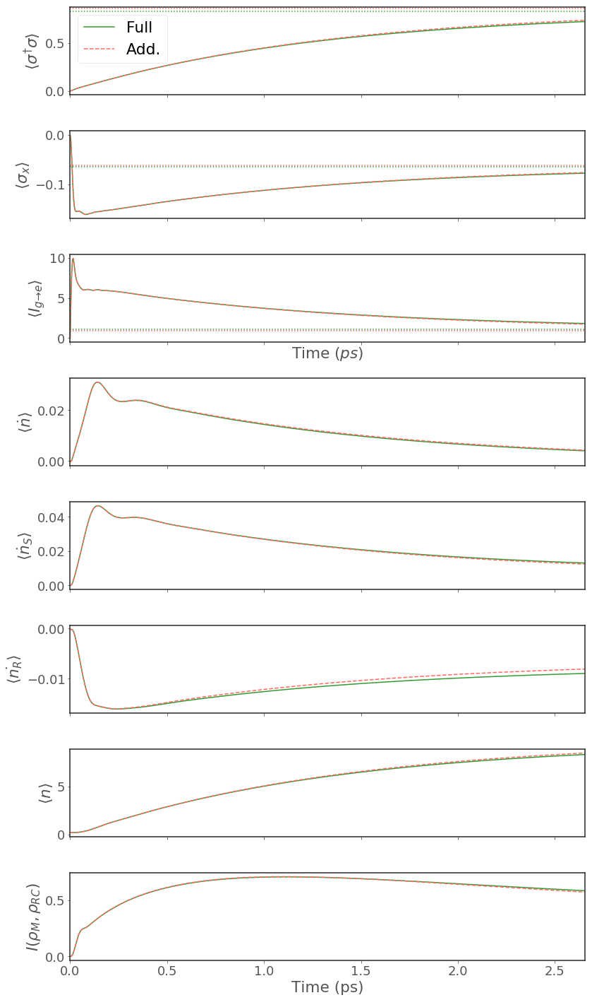

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


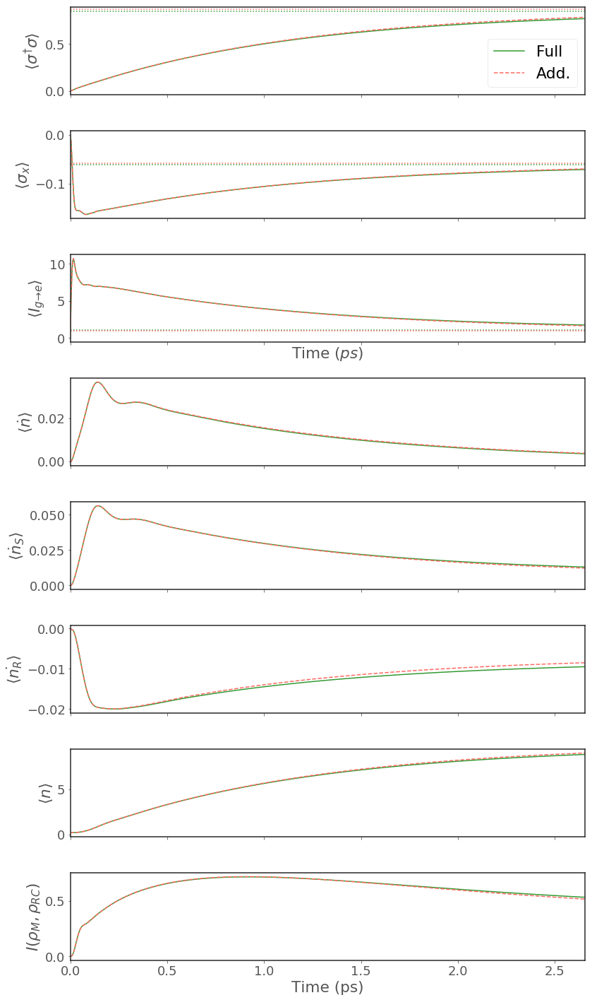

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


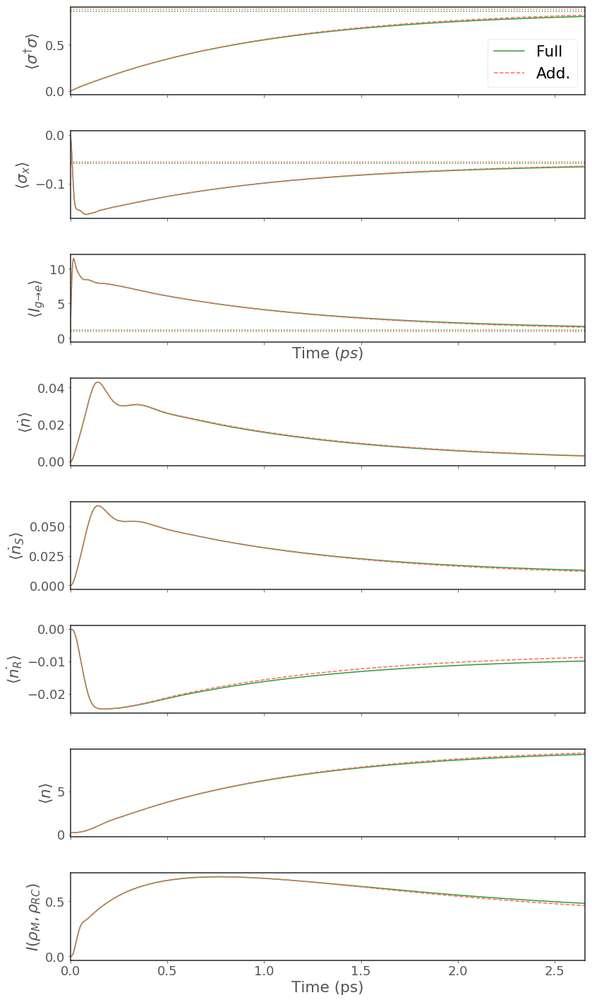

USING N=14
Detuning : 0.0097meV | w0 : 18.00meV
Dynamics complete


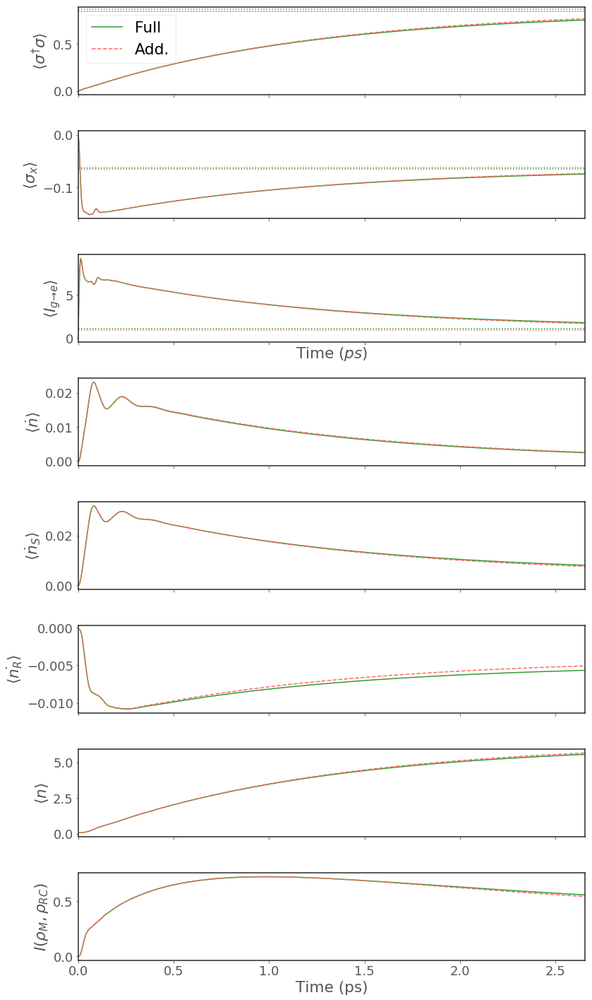

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


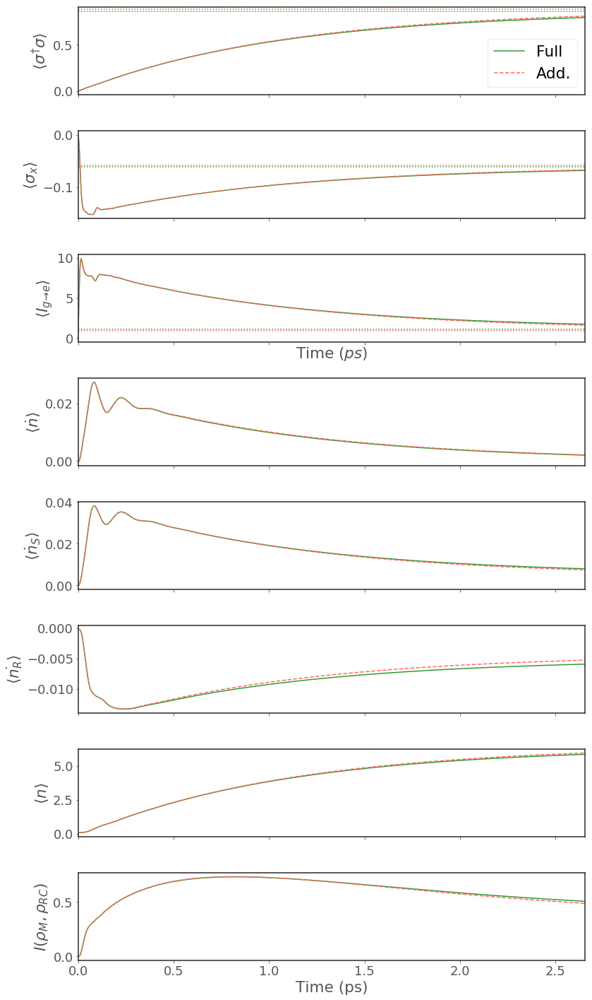

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


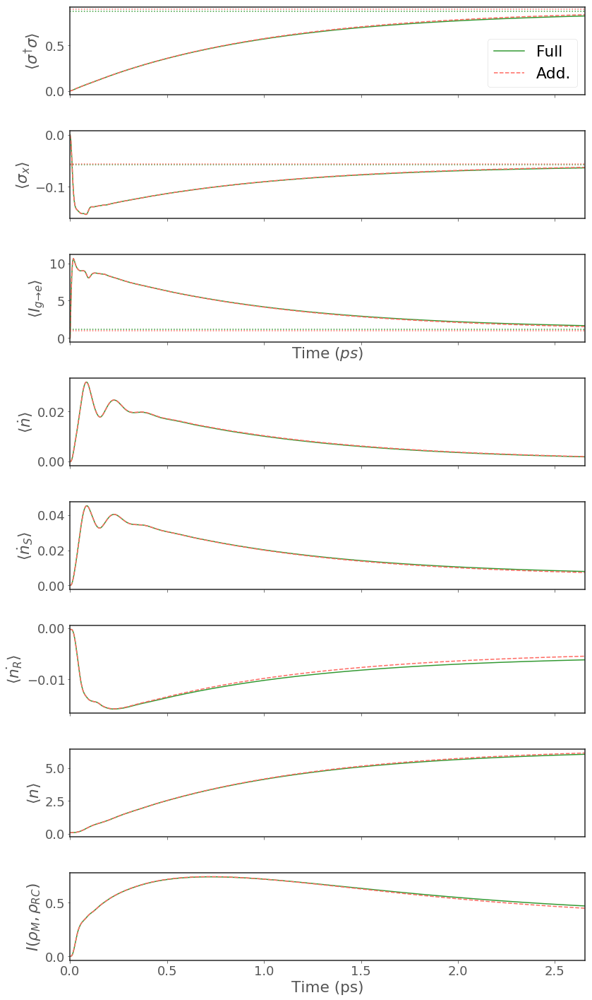

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


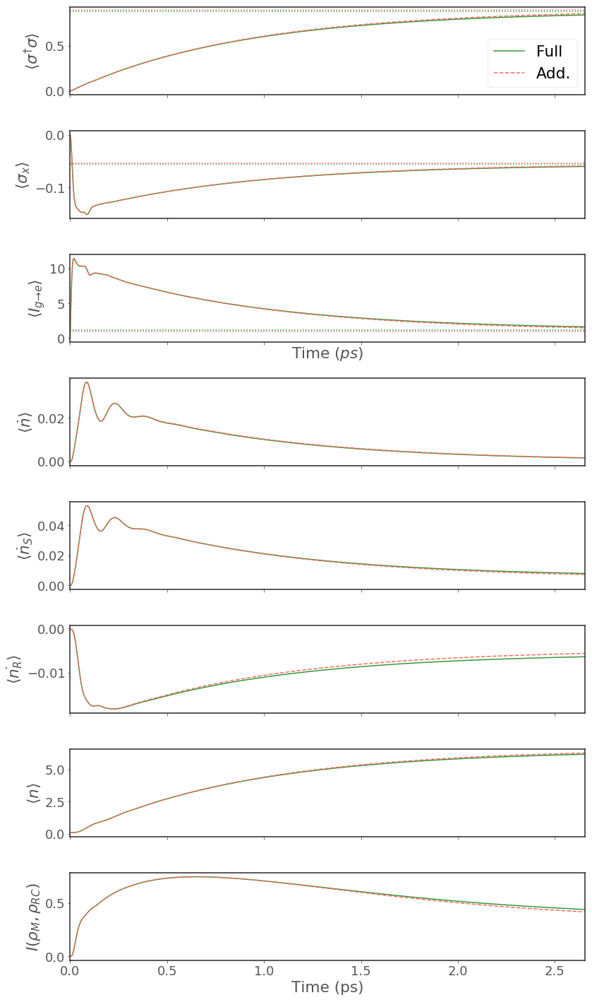

In [19]:
# higher T, strong coupling and intermediate Rabi 
T=77
alpha=100e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 10e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

Error could only converge to 0.4467148608798703
USING N=24
Detuning : 0.0097meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


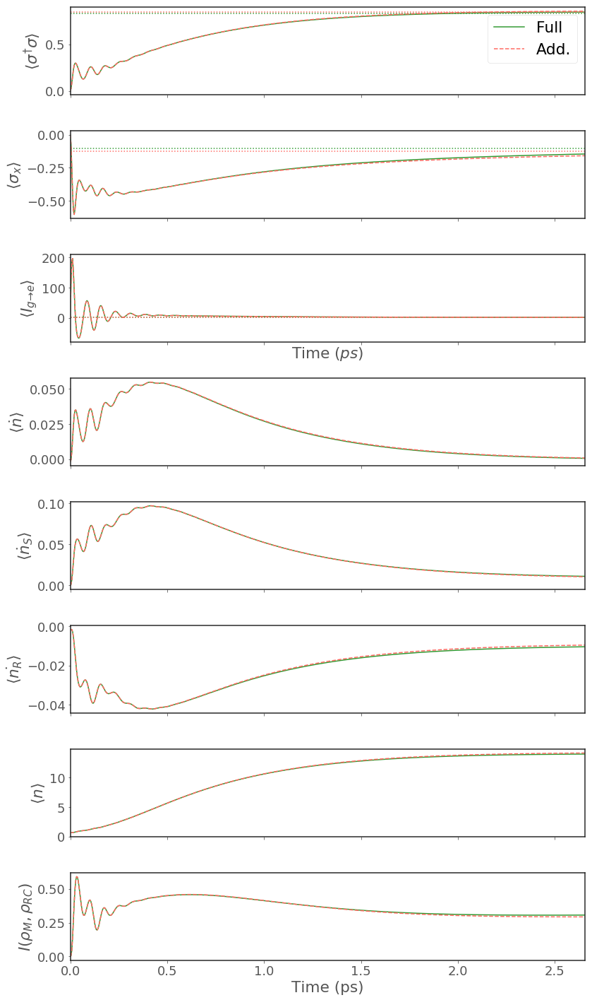

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


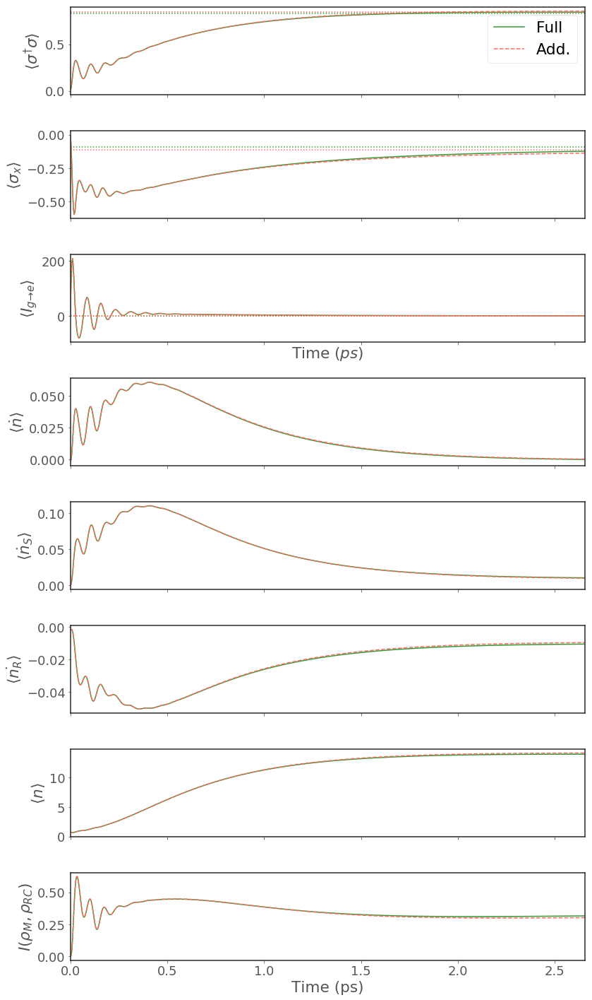

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


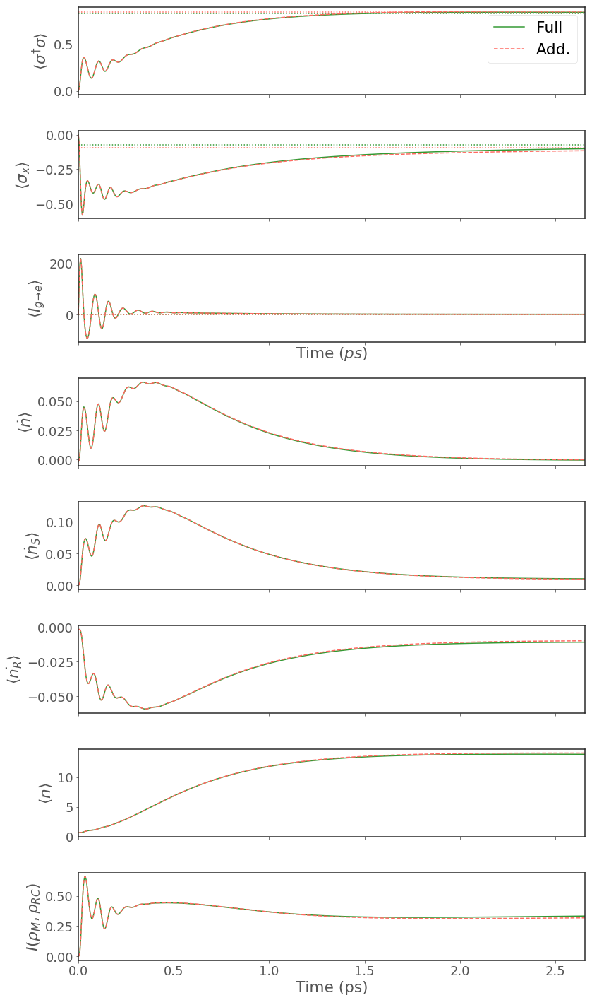

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


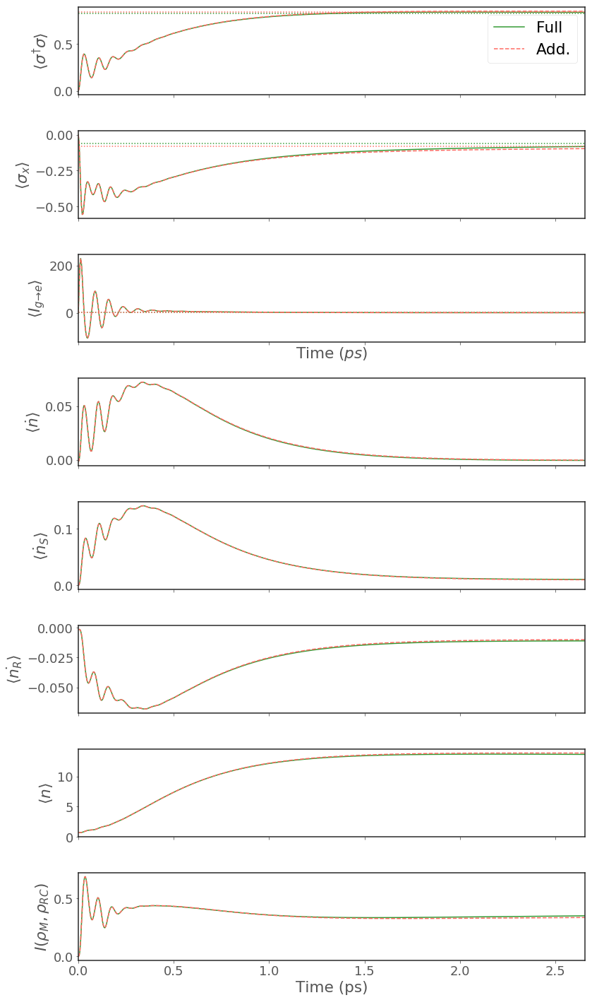

USING N=20
Detuning : 0.0097meV | w0 : 12.00meV
Dynamics complete


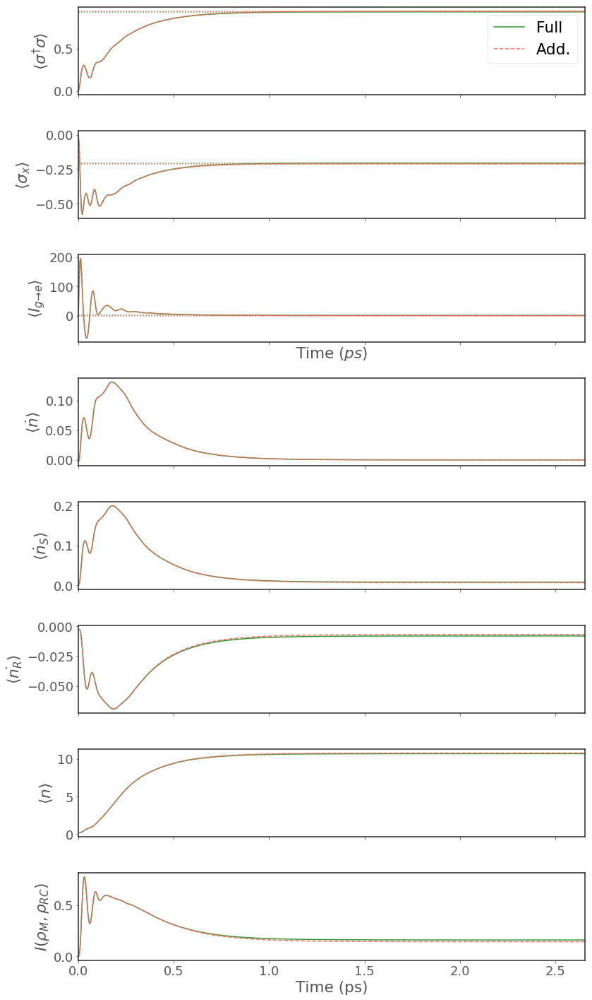

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


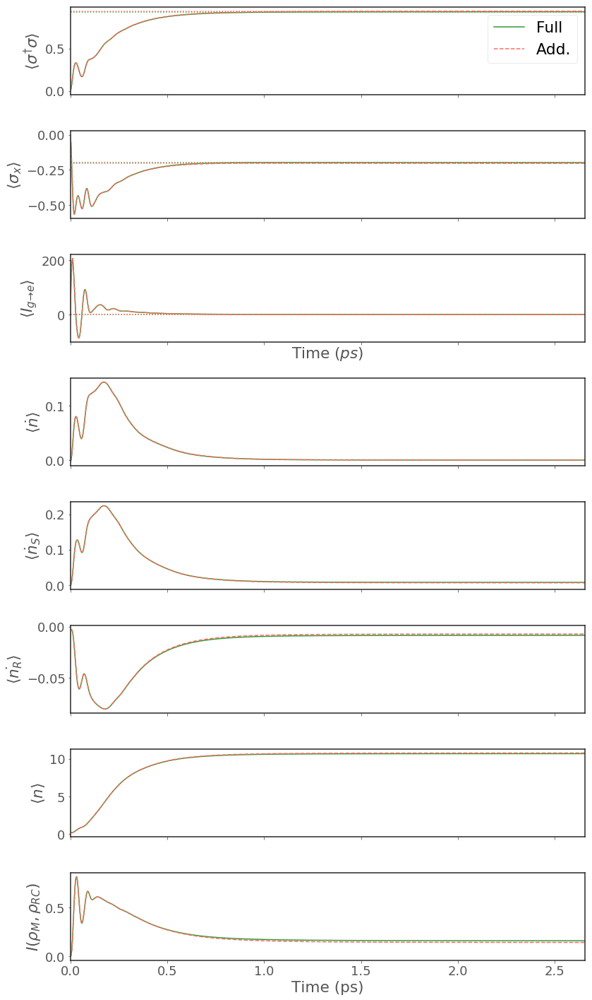

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


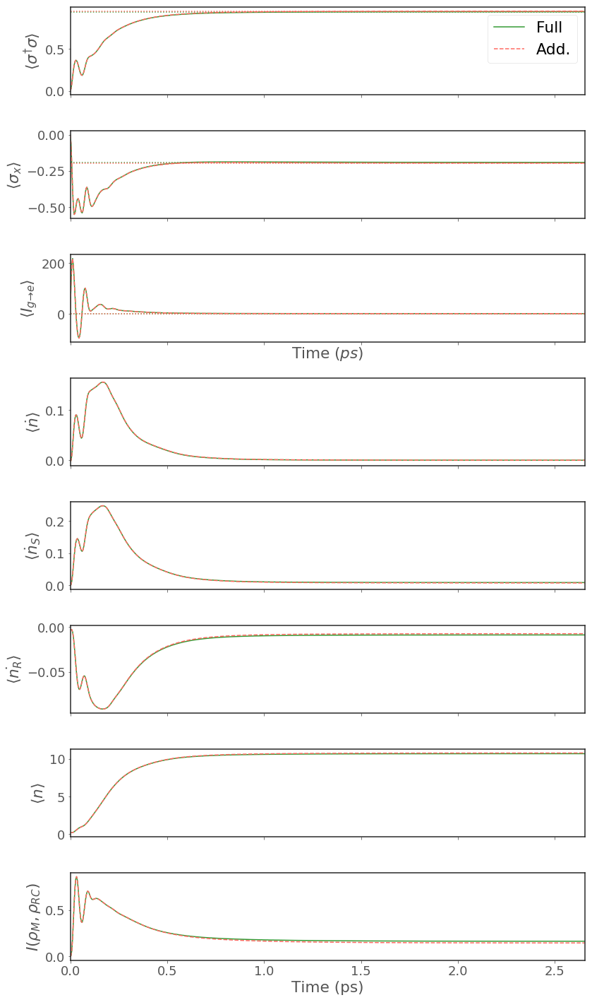

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


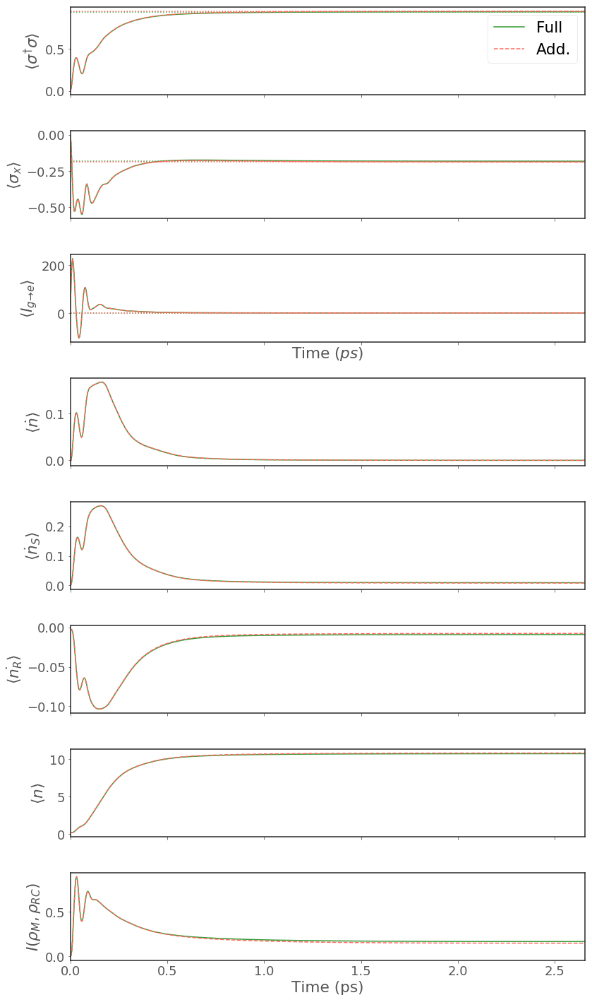

USING N=14
Detuning : 0.0097meV | w0 : 18.00meV
Dynamics complete


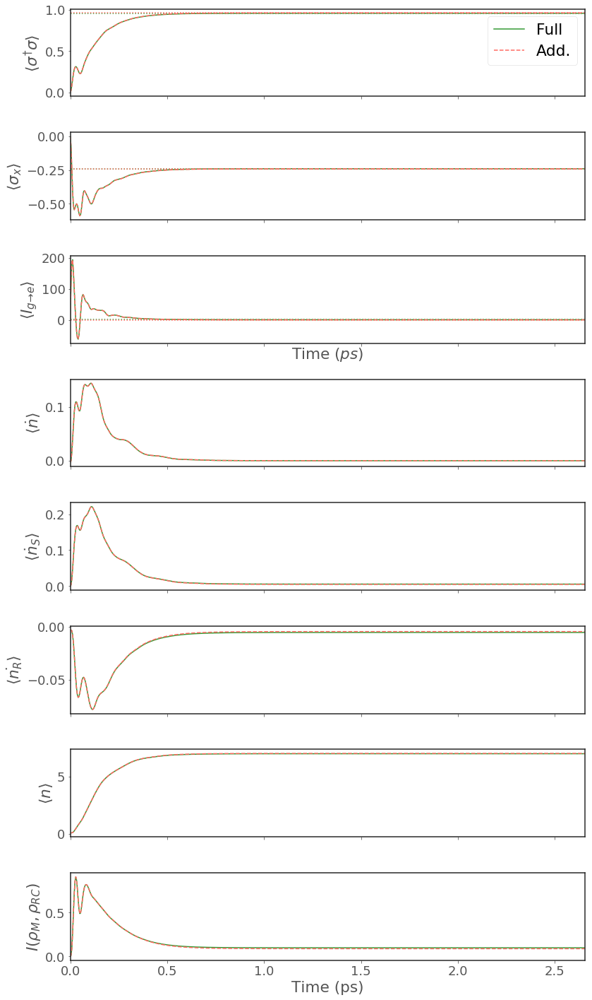

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


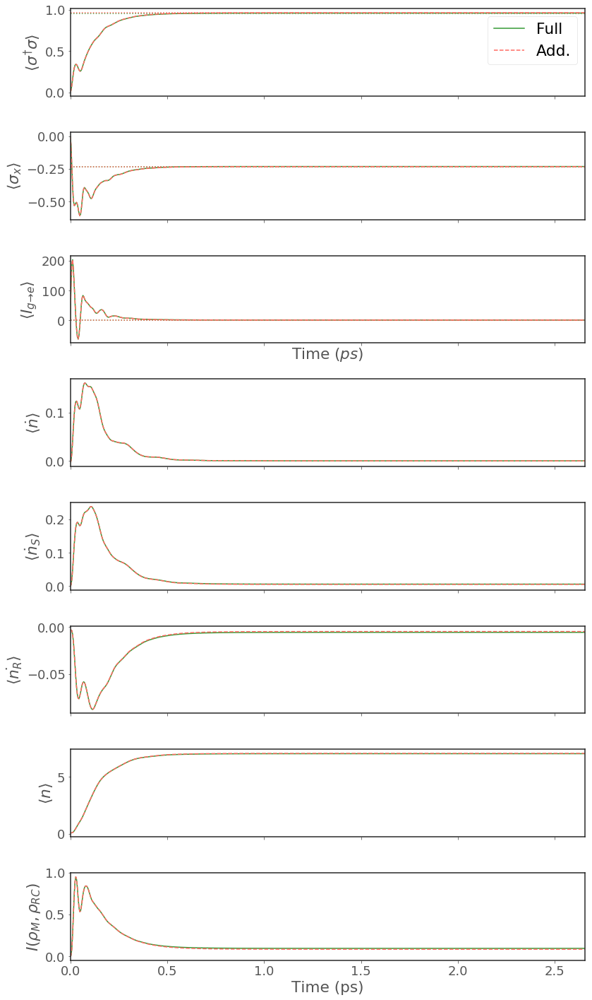

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


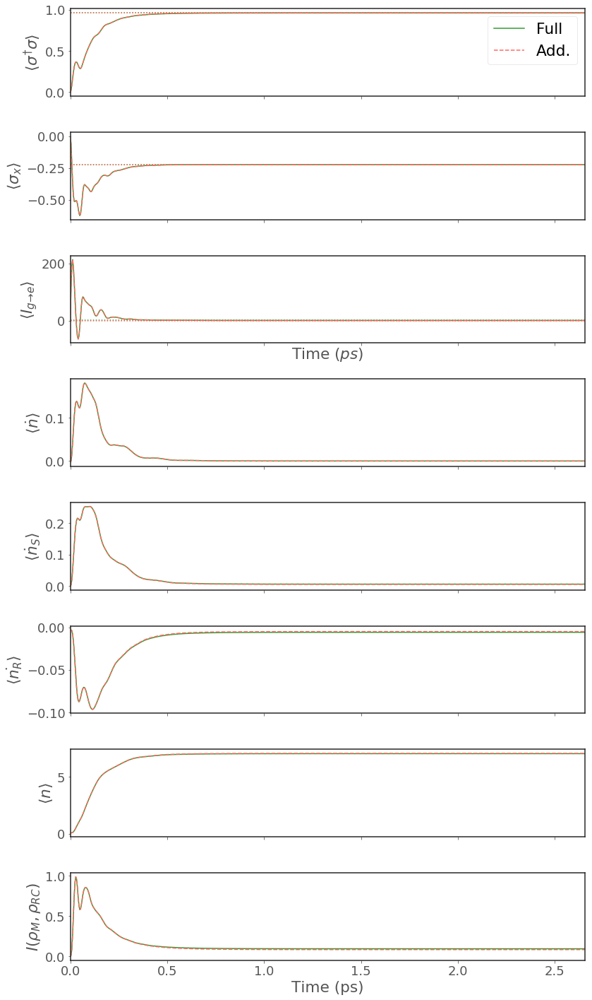

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


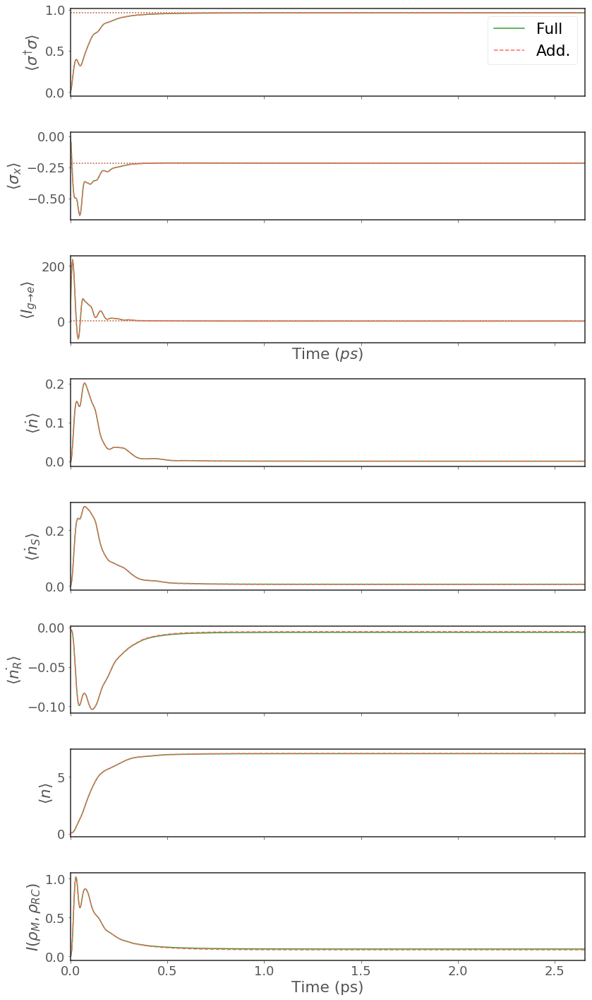

In [20]:
# higher T, strong coupling and strong Rabi 
T=77
alpha=100e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 50e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

Error could only converge to 0.09251246185849654
USING N=10
Detuning : 0.0010meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


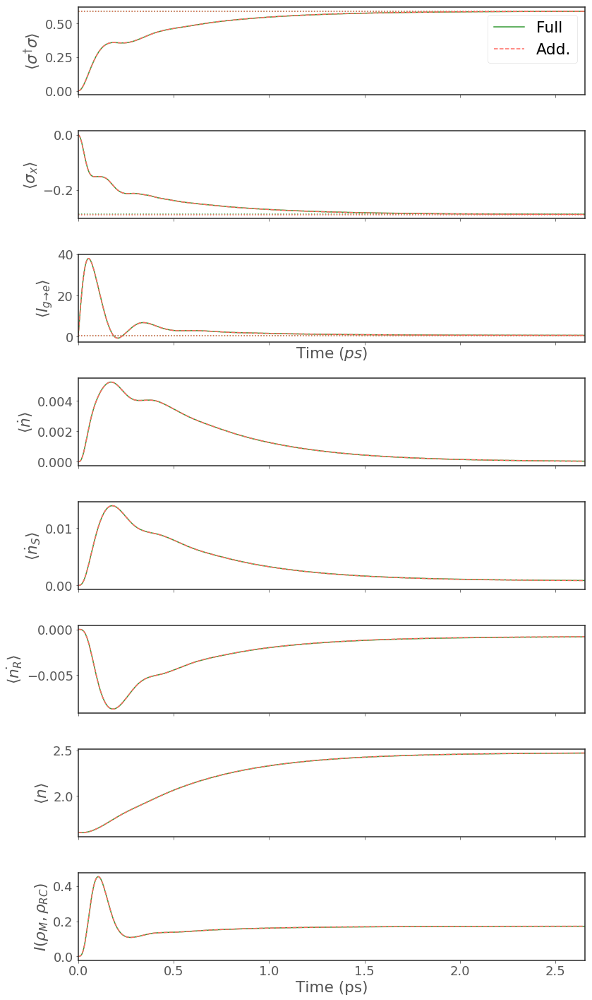

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


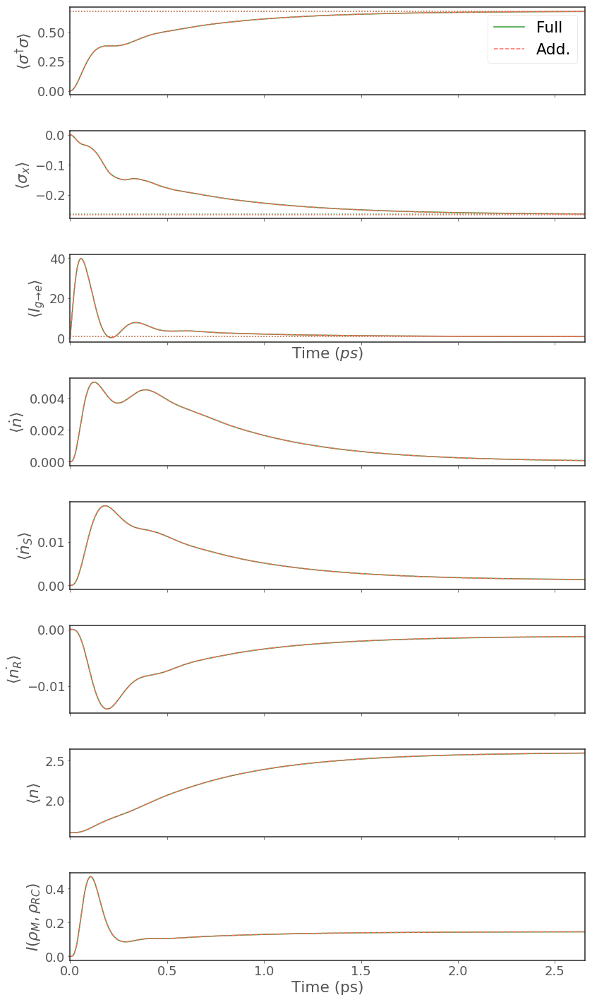

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


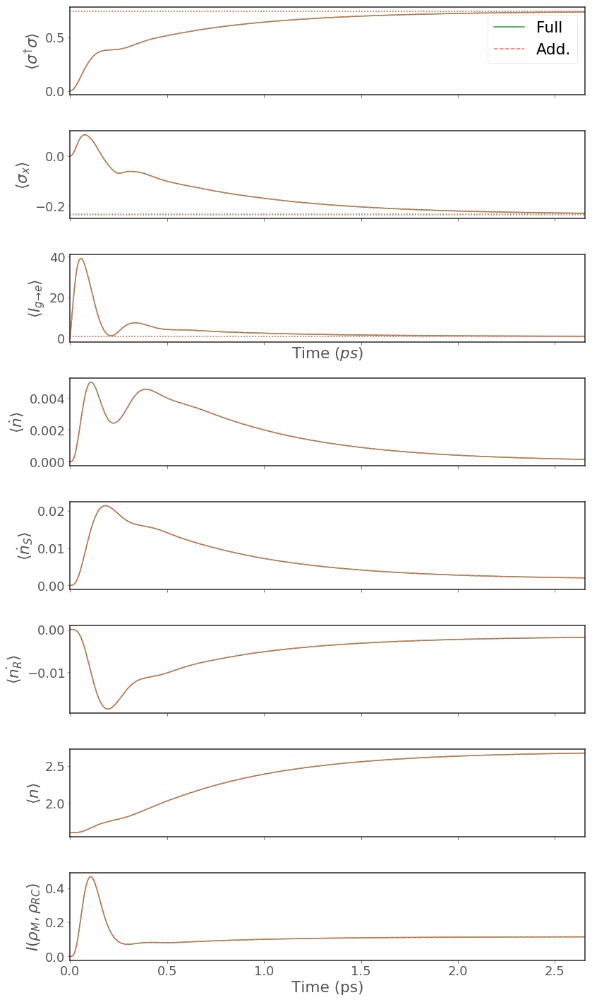

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


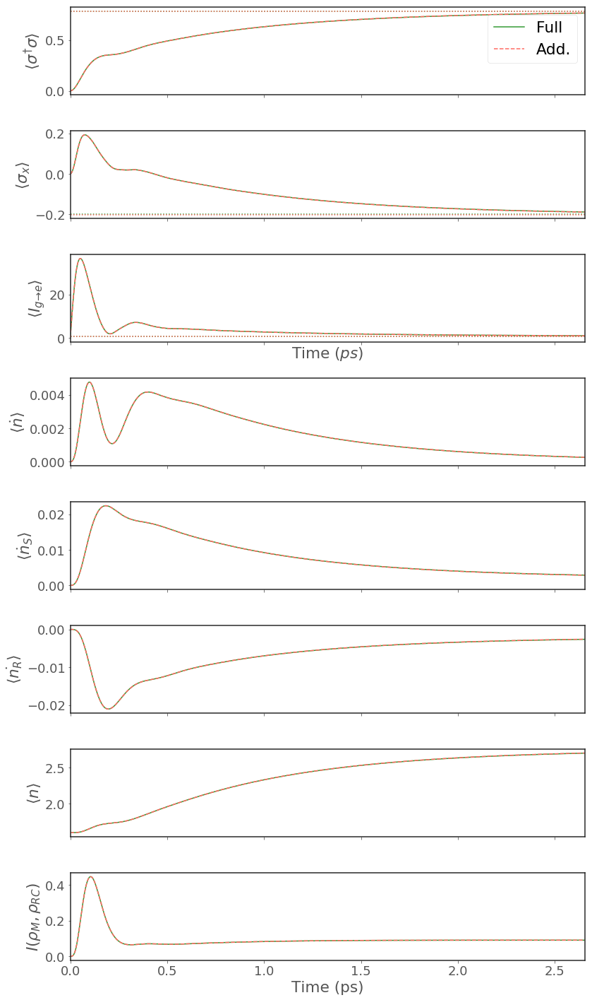

USING N=9
Detuning : 0.0010meV | w0 : 12.00meV
Dynamics complete


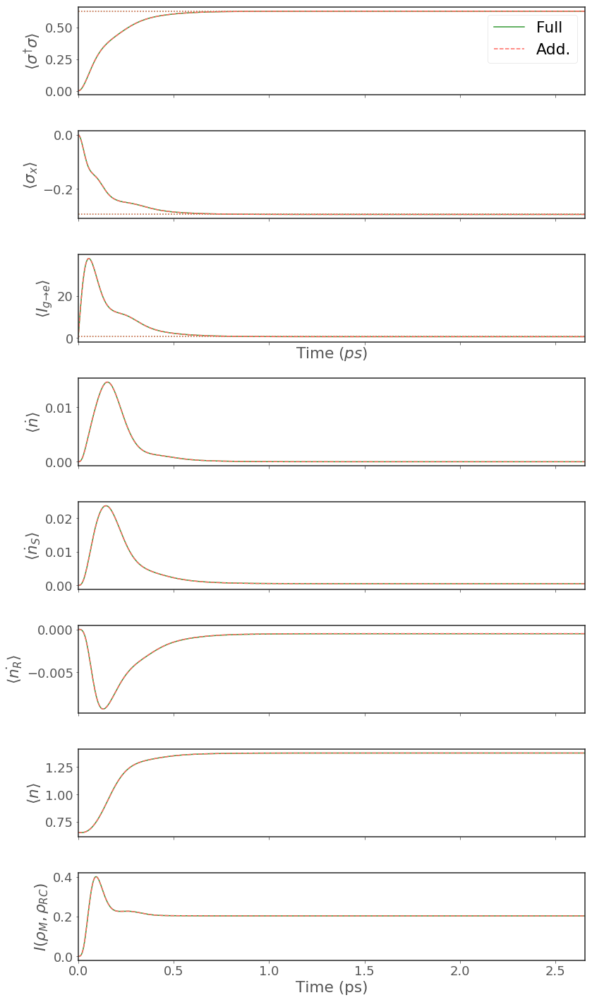

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


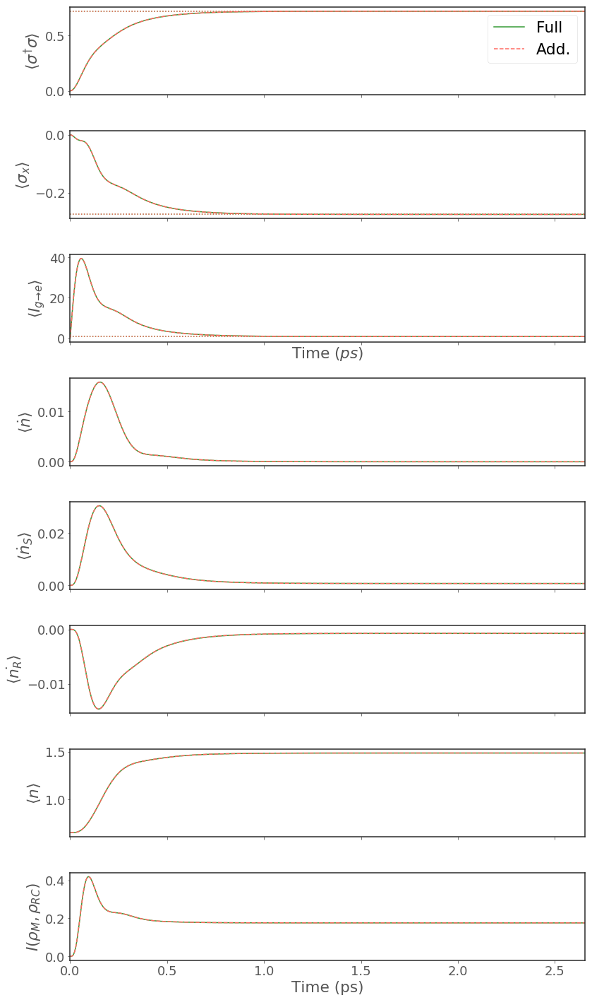

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


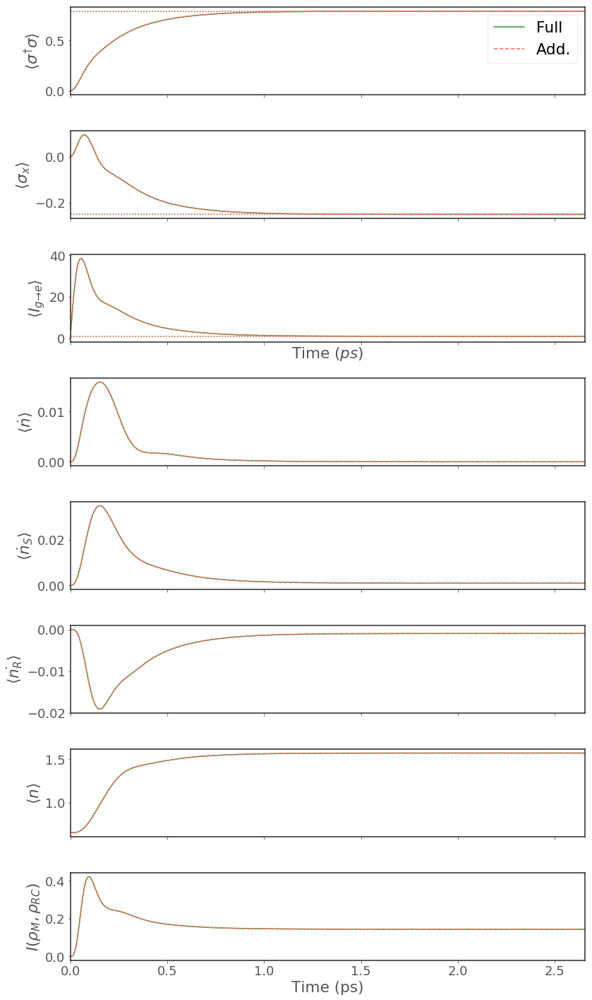

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


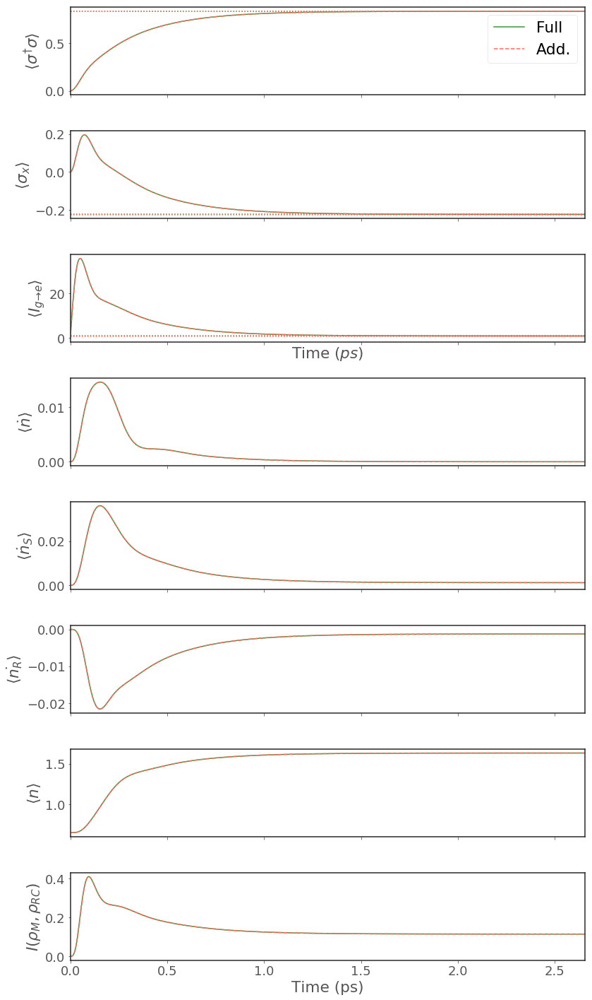

USING N=8
Detuning : 0.0010meV | w0 : 18.00meV
Dynamics complete


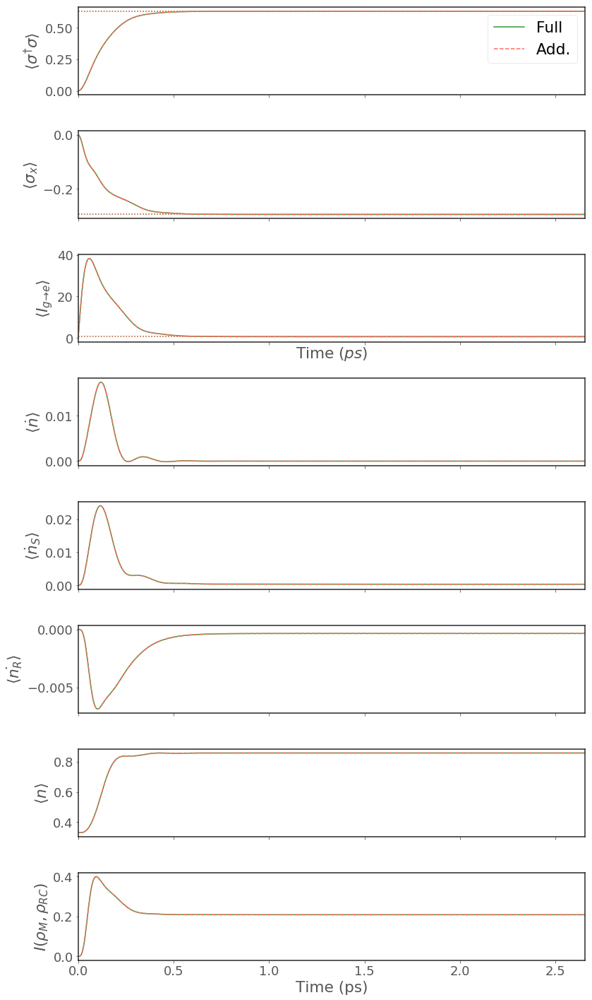

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


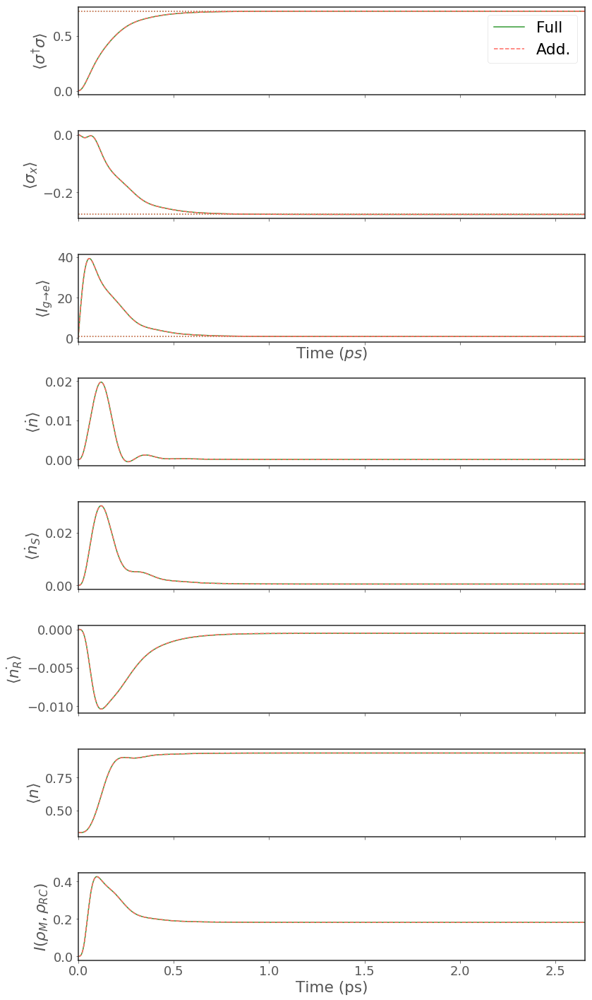

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


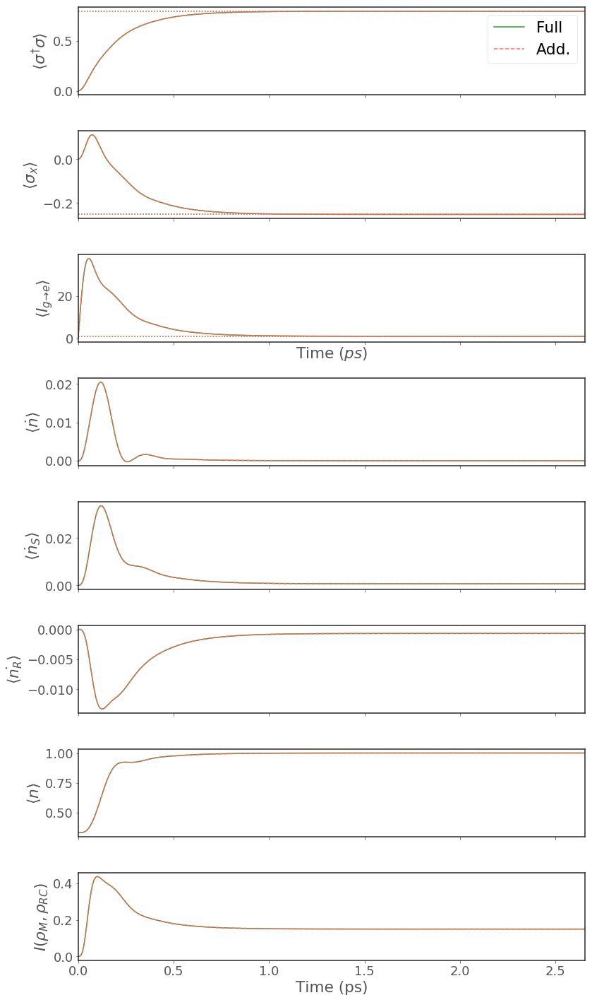

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


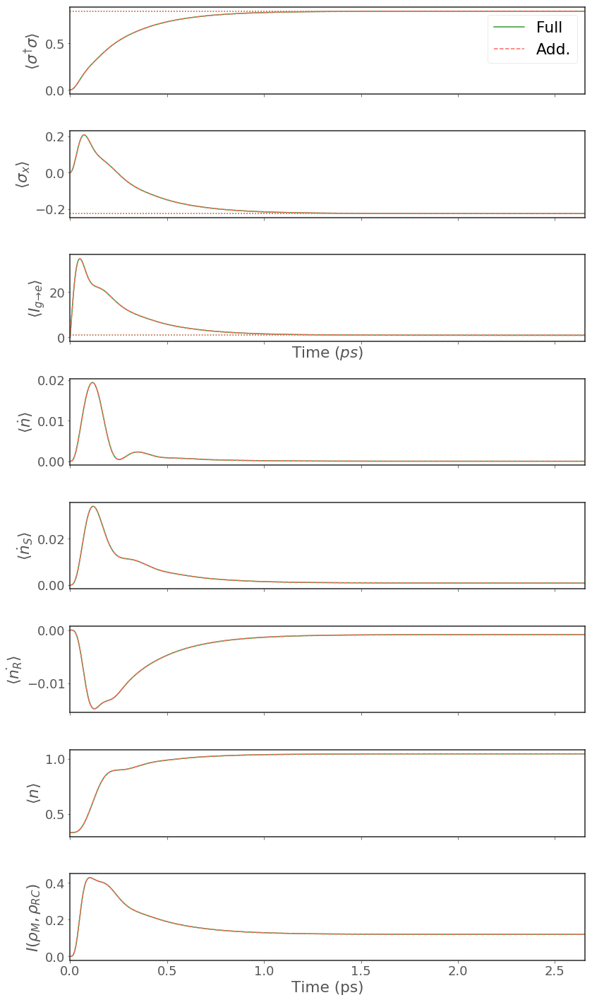

In [21]:
# highest T, intermediate coupling and intermediate Rabi 
T=150
alpha=10e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 10e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

Error could only converge to 0.09251246185849654
USING N=10
Detuning : 0.0010meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


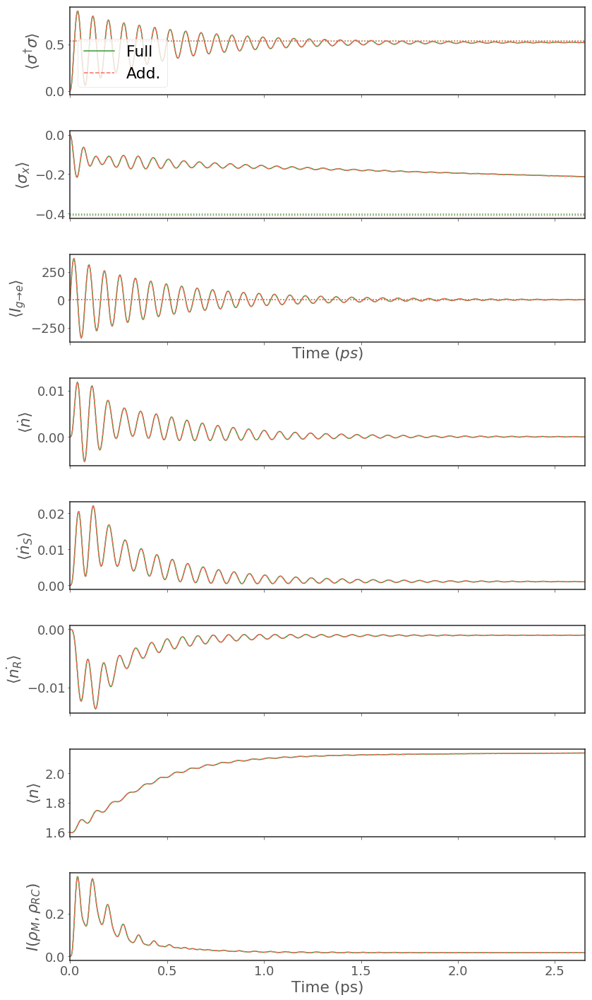

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


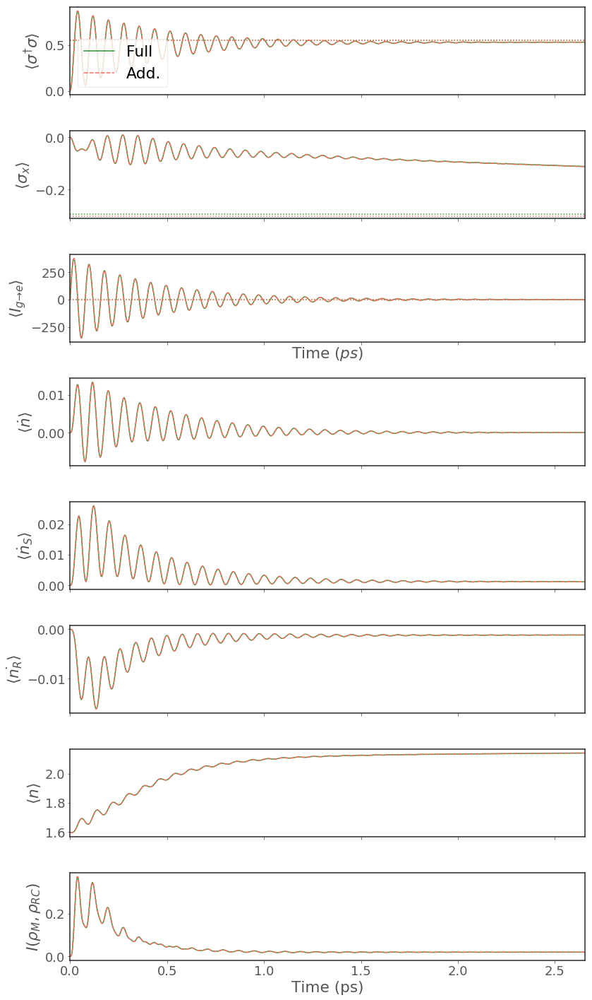

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


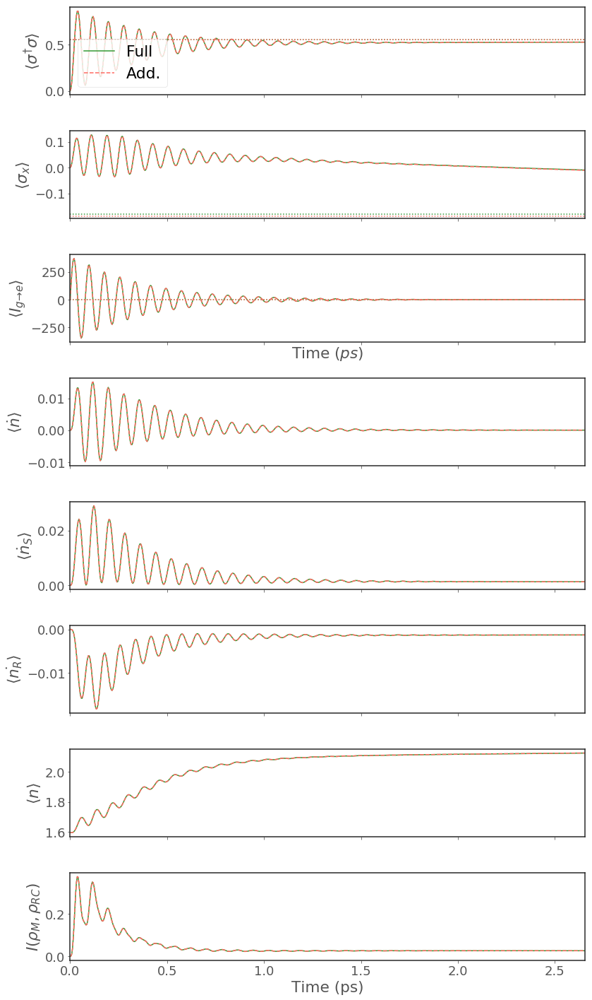

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


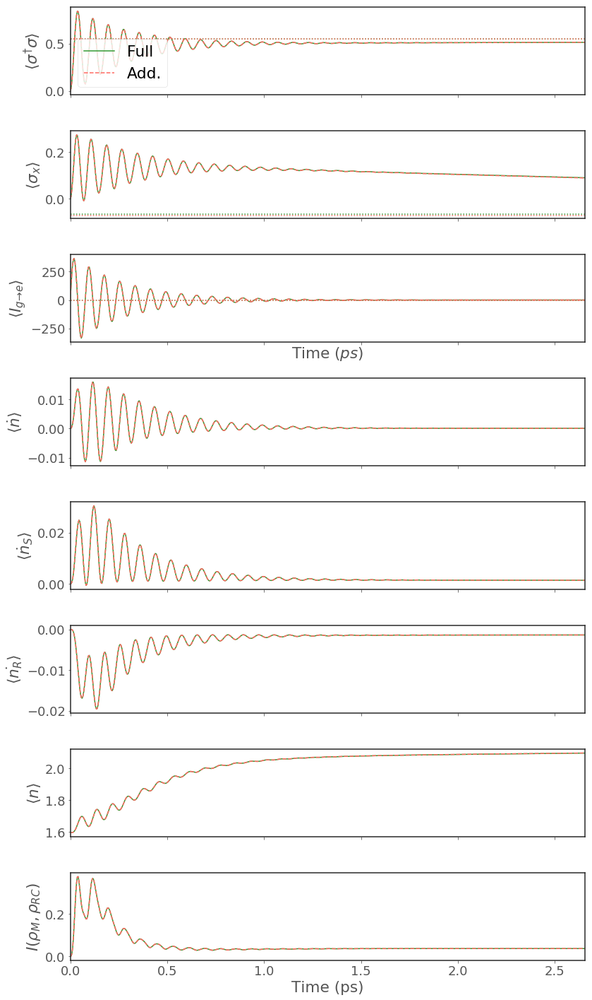

USING N=9
Detuning : 0.0010meV | w0 : 12.00meV
Dynamics complete


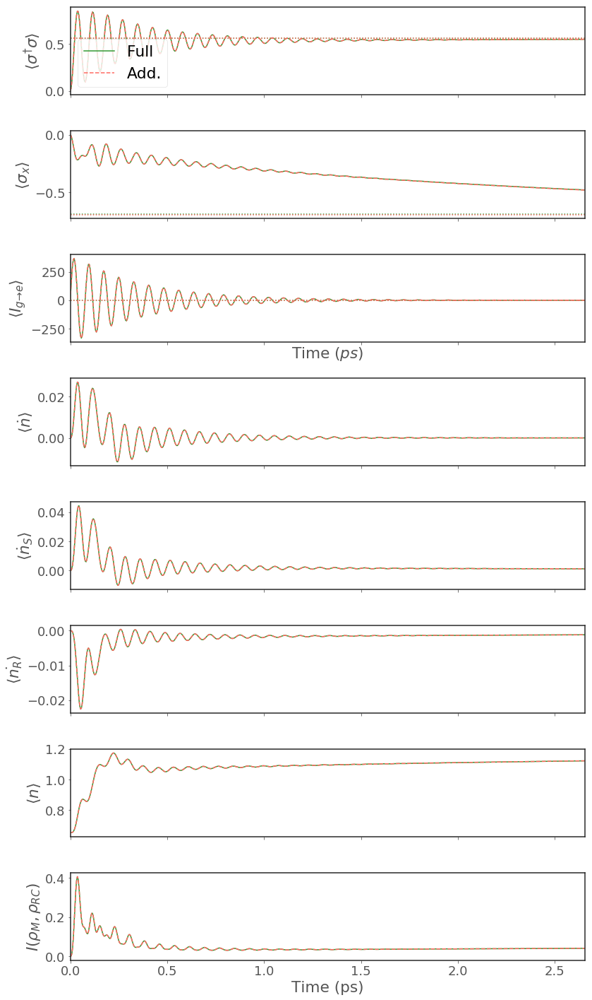

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


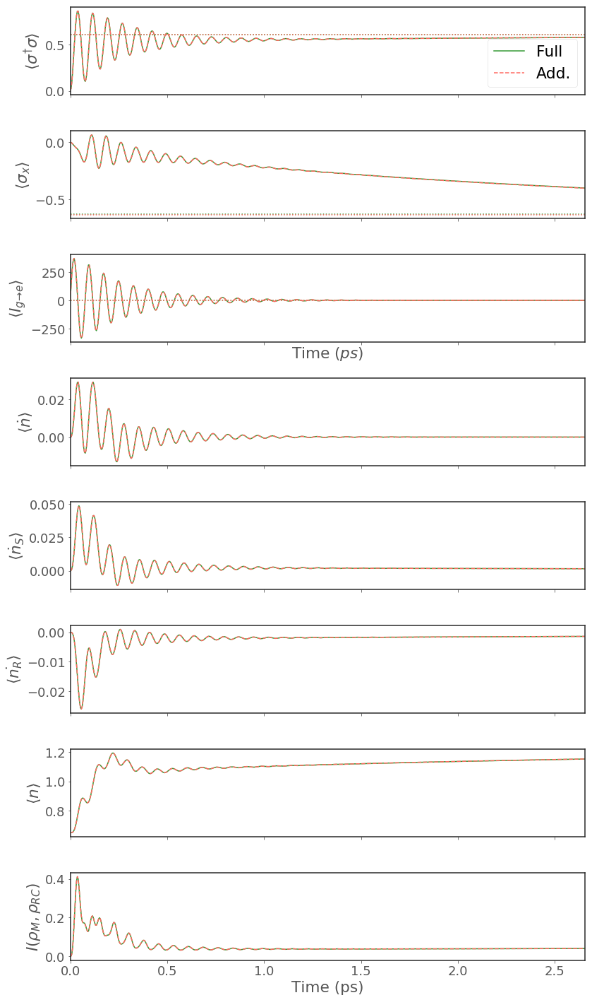

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


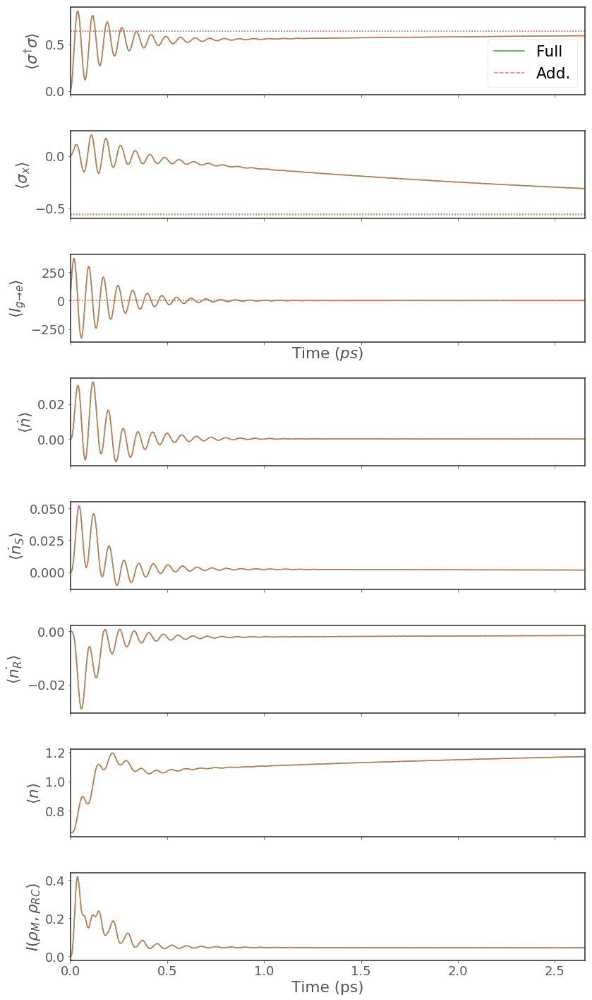

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


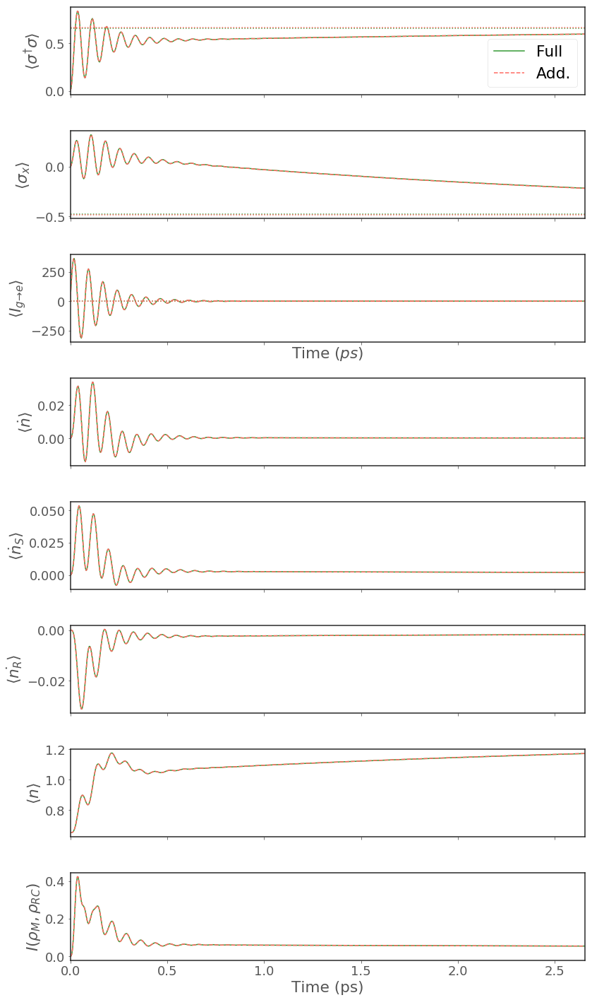

USING N=8
Detuning : 0.0010meV | w0 : 18.00meV
Dynamics complete


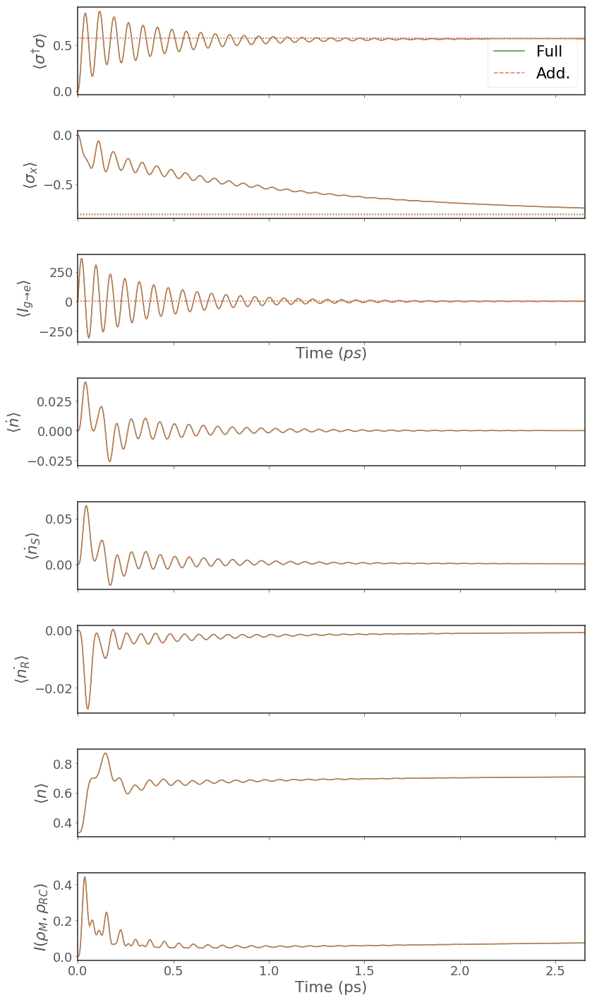

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


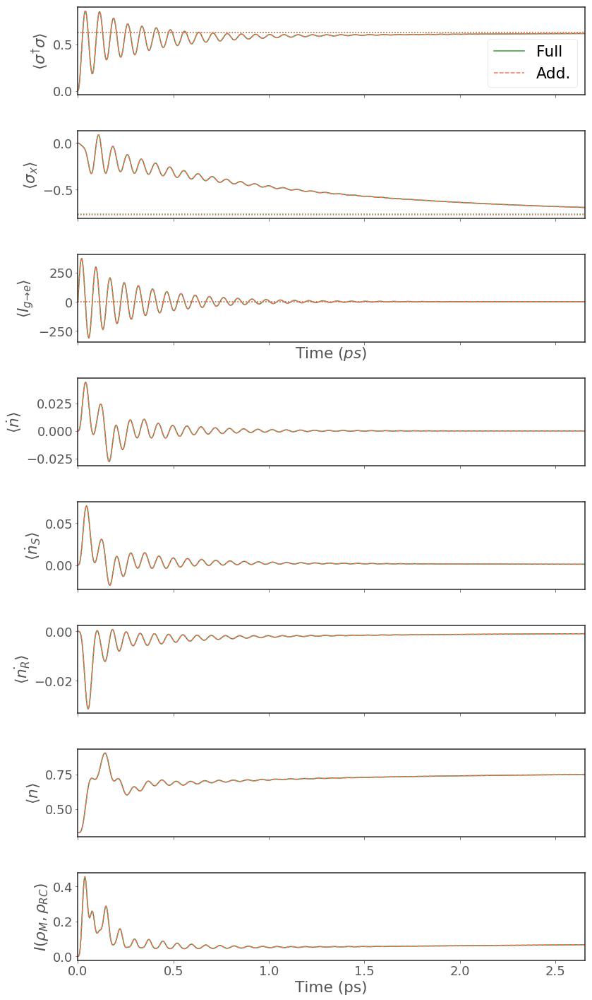

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


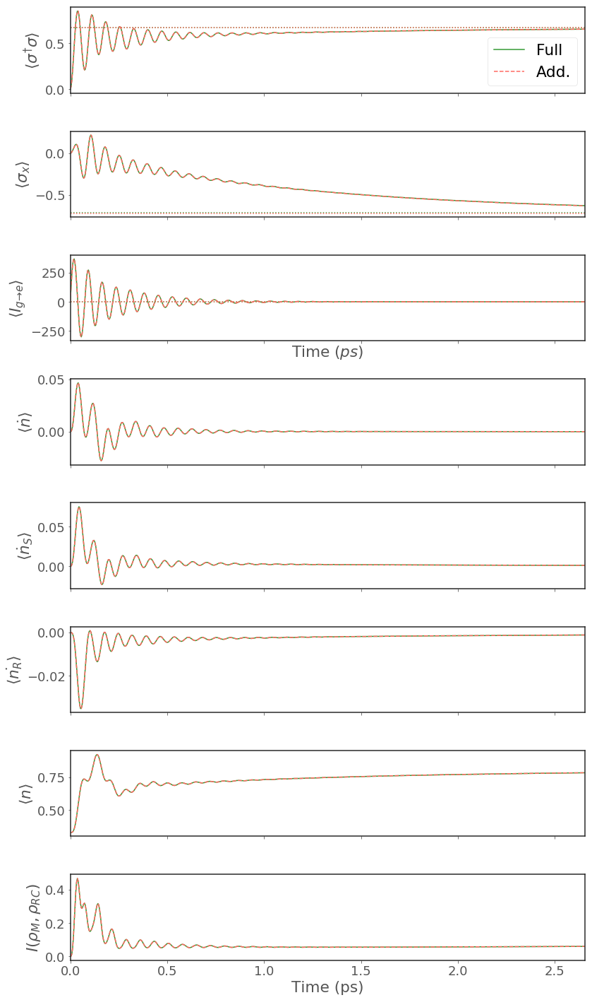

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


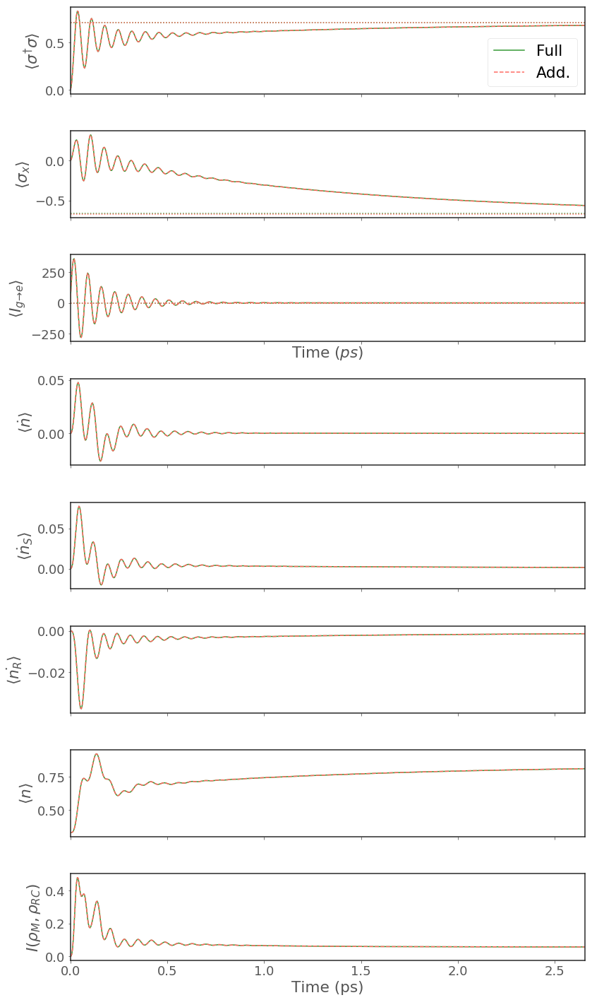

In [22]:
# highest T, intermediate coupling and strong Rabi 
T=150
alpha=10e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 50e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

Error could only converge to 5.927420816564555
USING N=24
Detuning : 0.0097meV | w0 : 6.00meV
Dynamics complete


/Users/admin/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


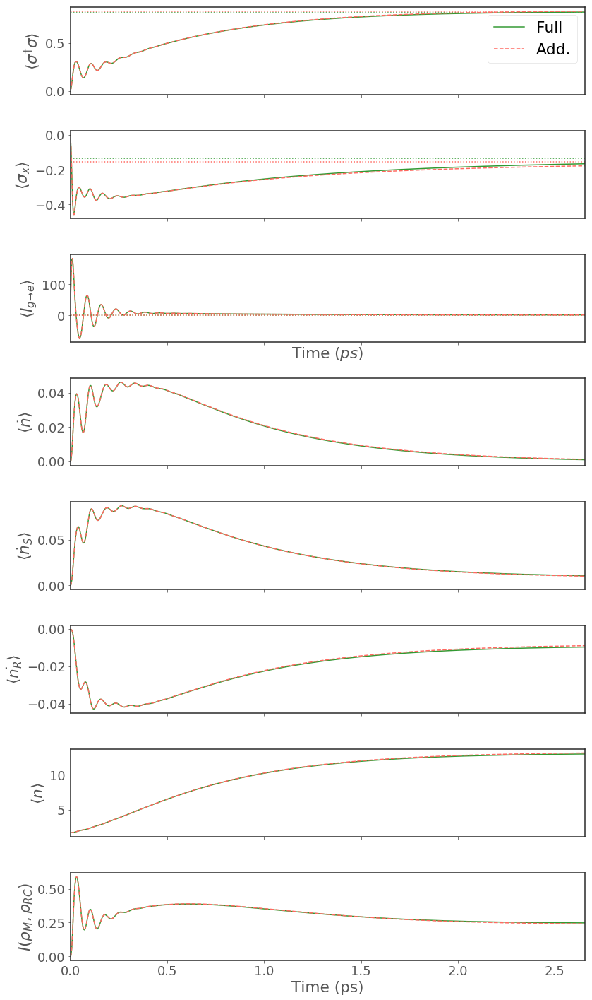

Detuning : 6.0000meV | w0 : 6.00meV
Dynamics complete


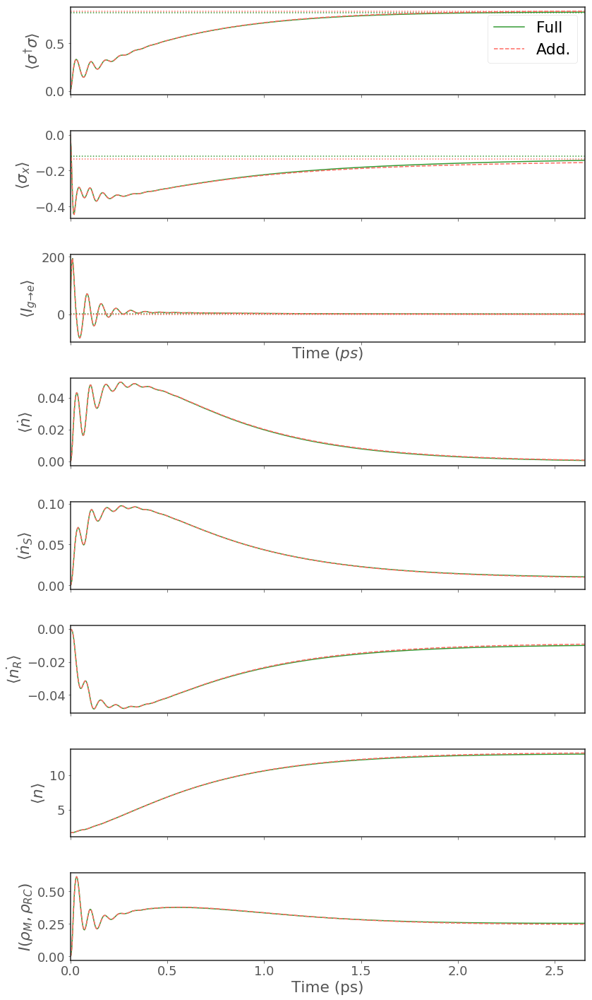

Detuning : 12.0000meV | w0 : 6.00meV
Dynamics complete


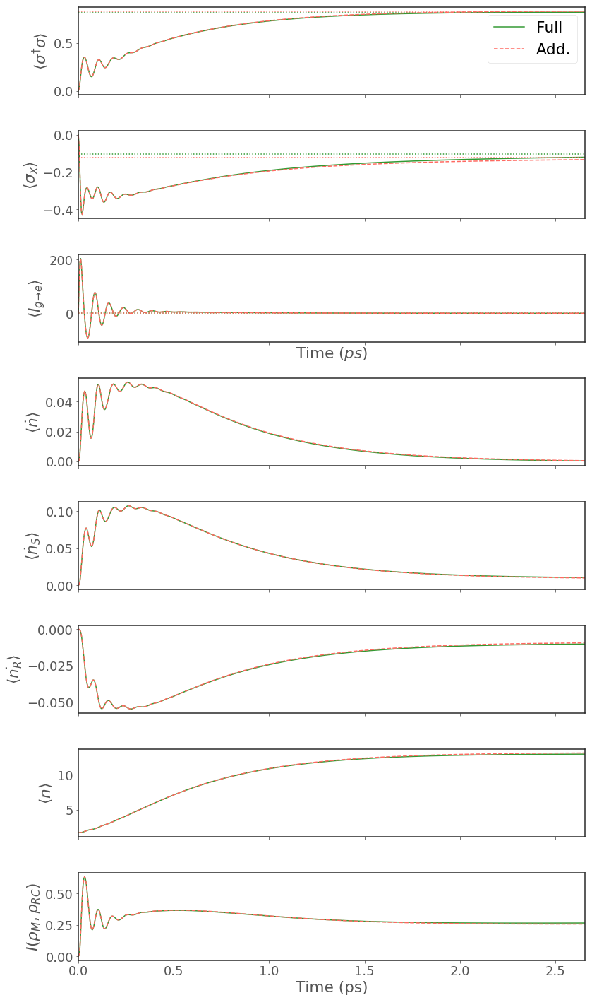

Detuning : 18.0000meV | w0 : 6.00meV
Dynamics complete


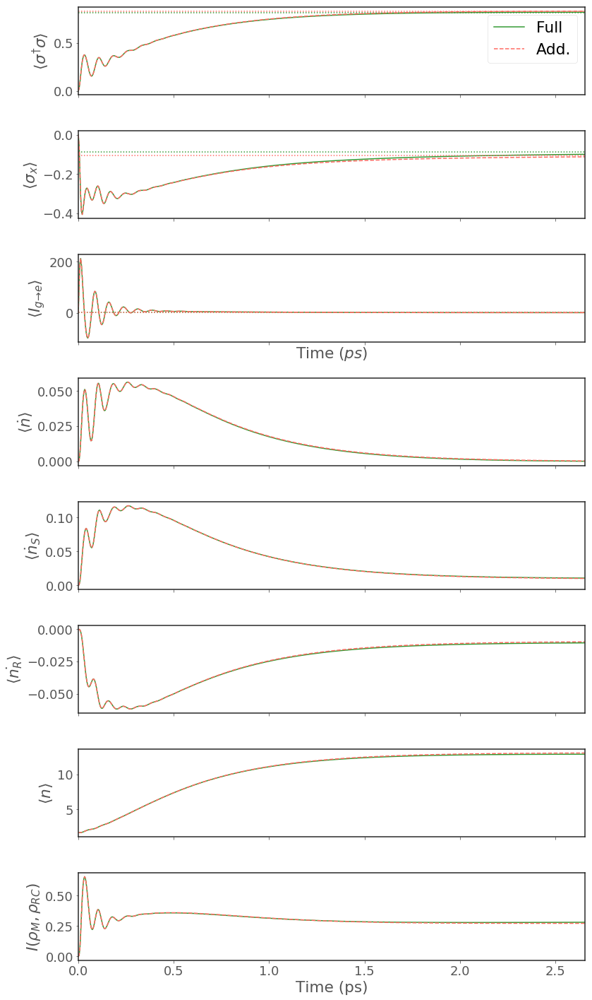

Error could only converge to 0.011738896778847669
USING N=24
Detuning : 0.0097meV | w0 : 12.00meV
Dynamics complete


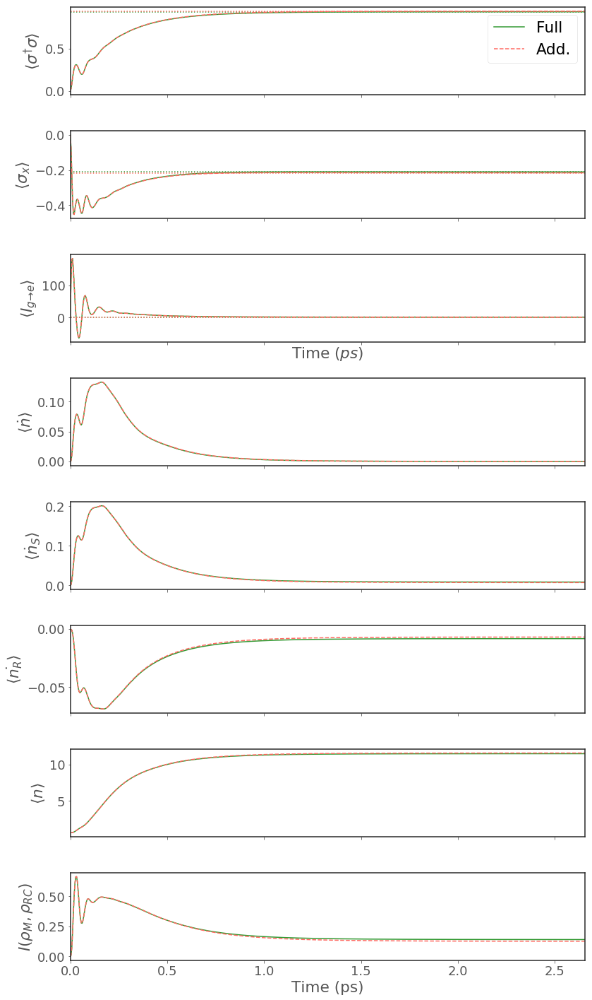

Detuning : 6.0000meV | w0 : 12.00meV
Dynamics complete


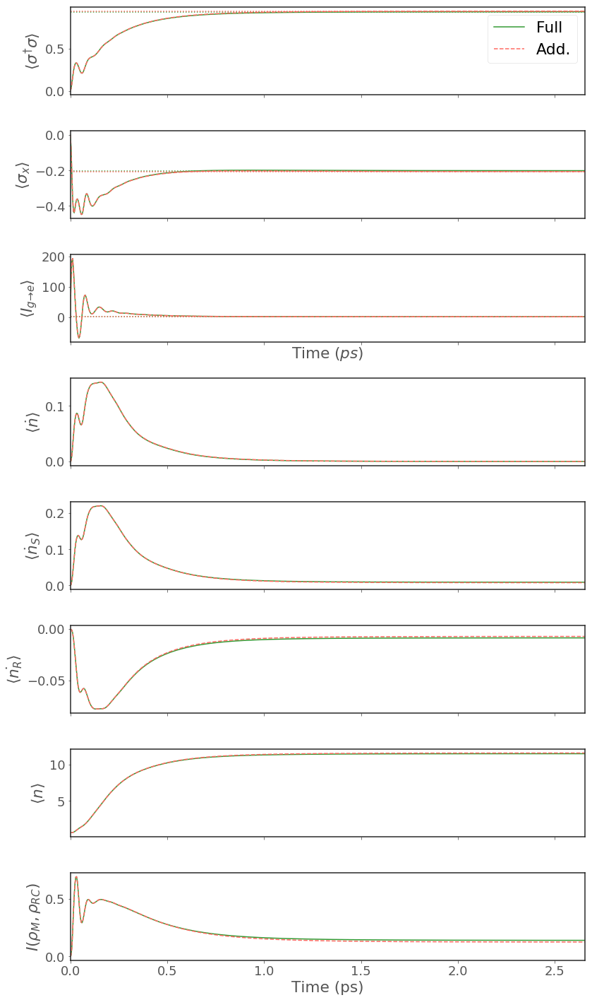

Detuning : 12.0000meV | w0 : 12.00meV
Dynamics complete


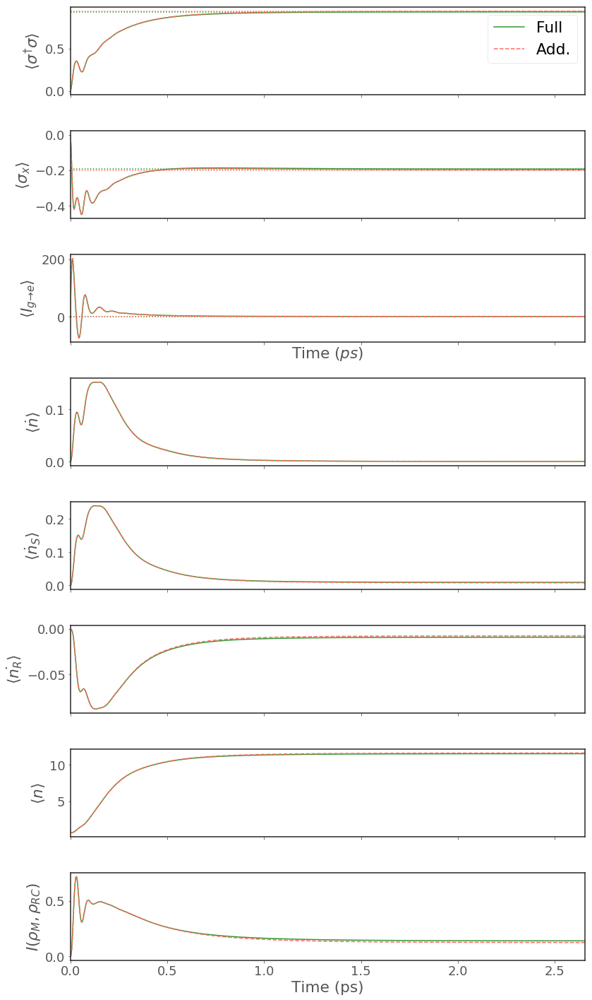

Detuning : 18.0000meV | w0 : 12.00meV
Dynamics complete


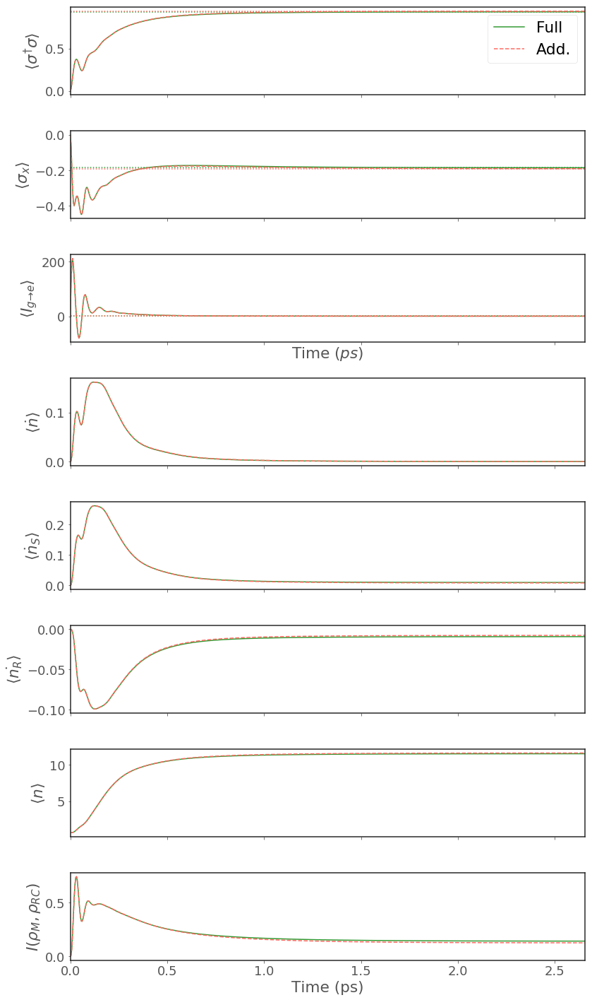

USING N=20
Detuning : 0.0097meV | w0 : 18.00meV
Dynamics complete


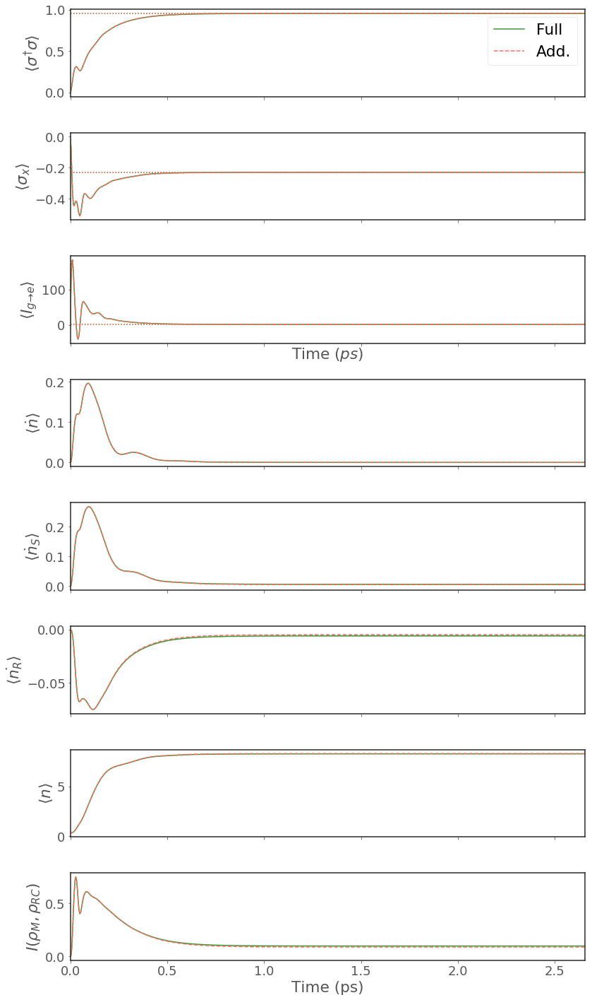

Detuning : 6.0000meV | w0 : 18.00meV
Dynamics complete


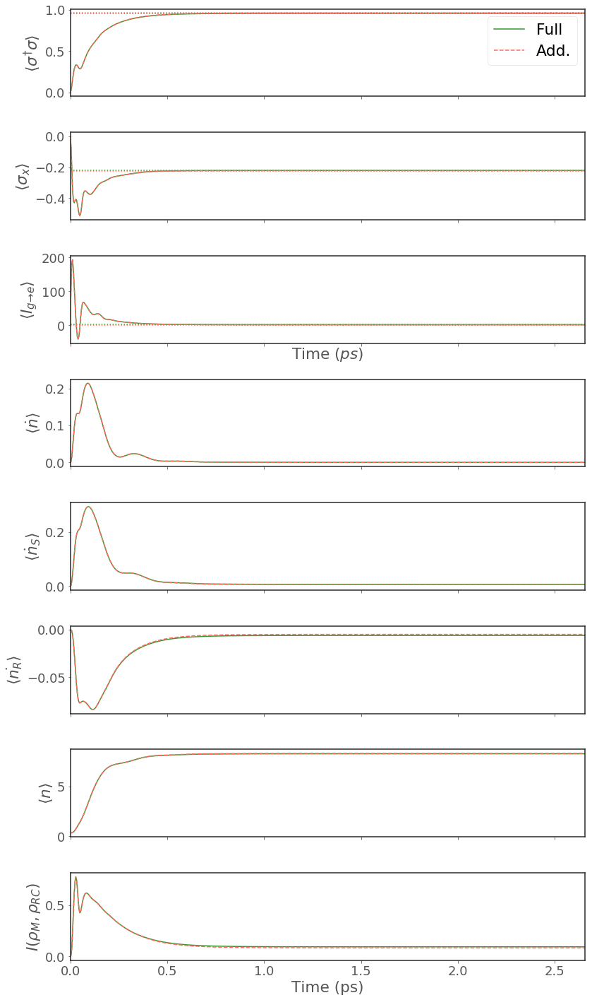

Detuning : 12.0000meV | w0 : 18.00meV
Dynamics complete


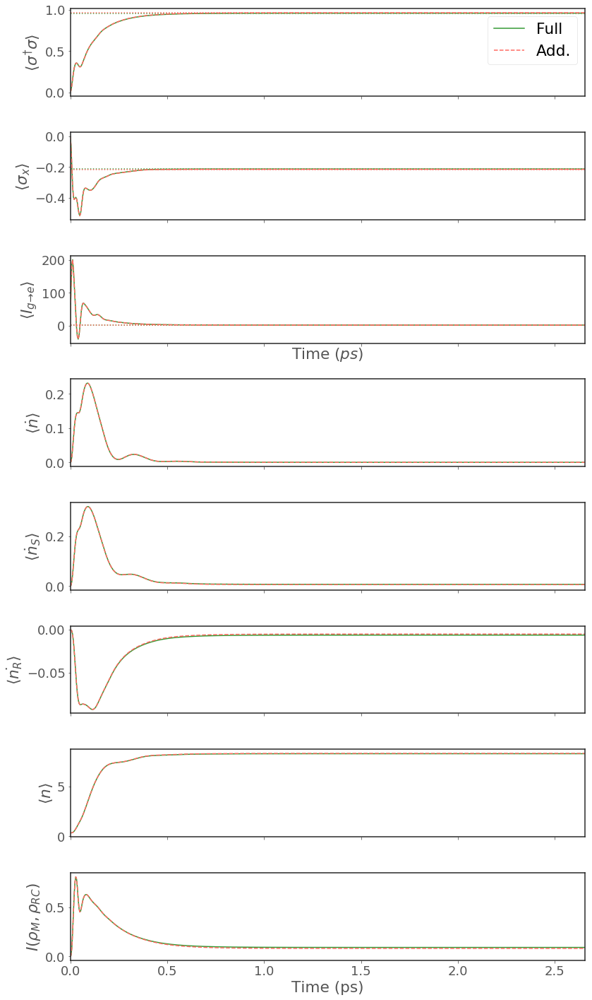

Detuning : 18.0000meV | w0 : 18.00meV
Dynamics complete


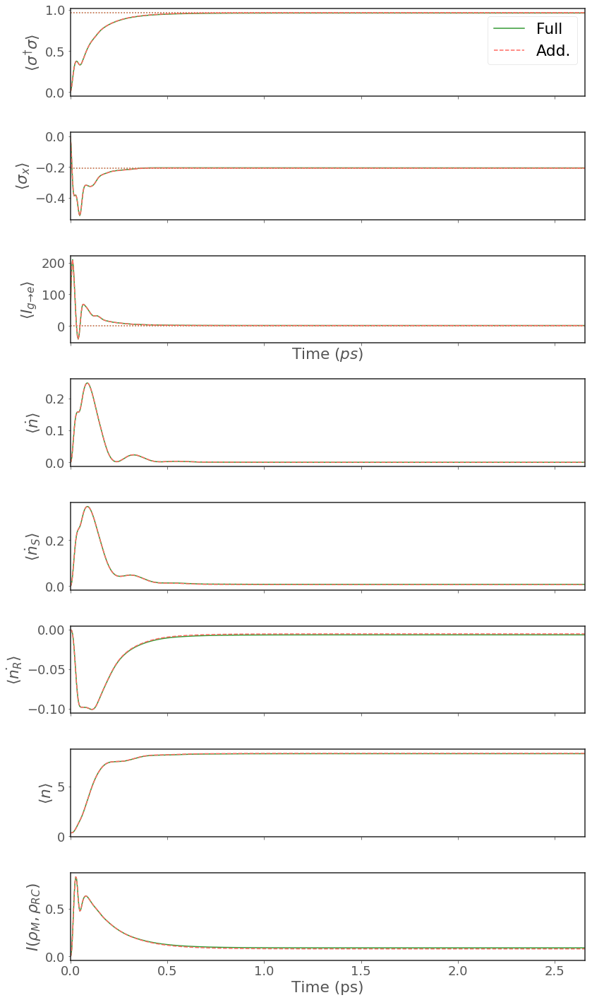

In [23]:
# highest T, strong coupling and strong Rabi 
T=150
alpha=100e-3
w0 = 6e-3
Gamma = 2*w0
Rabi = 50e-3

for w0 in [6e-3, 12e-3, 18e-3]:
    get_data_and_plot_for_detunings_additive(T=T, alpha=alpha, w0=w0, Gamma=Gamma, Rabi = Rabi, tf=tf)

In [24]:
def bloch_plot(data, pars):
    
    sigx = data.expect[1]
    sigy = data.expect[2]/pars[0]
    sigz = data.expect[0]-data.expect[3]
    
    b = qt.Bloch(view=[30, 30])
    b.add_points([sigx, sigy, sigz])
    b.show()
    b.view
bloch_plot(data_full, pars)

NameError: name 'data_full' is not defined

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[  0.      40.3275]
 [ 40.3275 -80.655 ]] Laser 
120.9825 24.1965 146.367653063
T_ph=77
w_RC=120.9825 | RC-res. coupling=0.1925 | TLS-RC coupling=67.81 | Gamma_RC=146.37 | alpha_ph=24.20 | N=9 |
Full:
[[ 0.23245059+0.j         -0.24120125+0.00546279j]
 [-0.24120125-0.00546279j  0.76754941+0.j        ]] 
 Add.:
[[ 0.23217665+0.j         -0.24142884+0.00539103j]
 [-0.24142884-0.00539103j  0.76782335+0.j        ]]
Dynamics complete


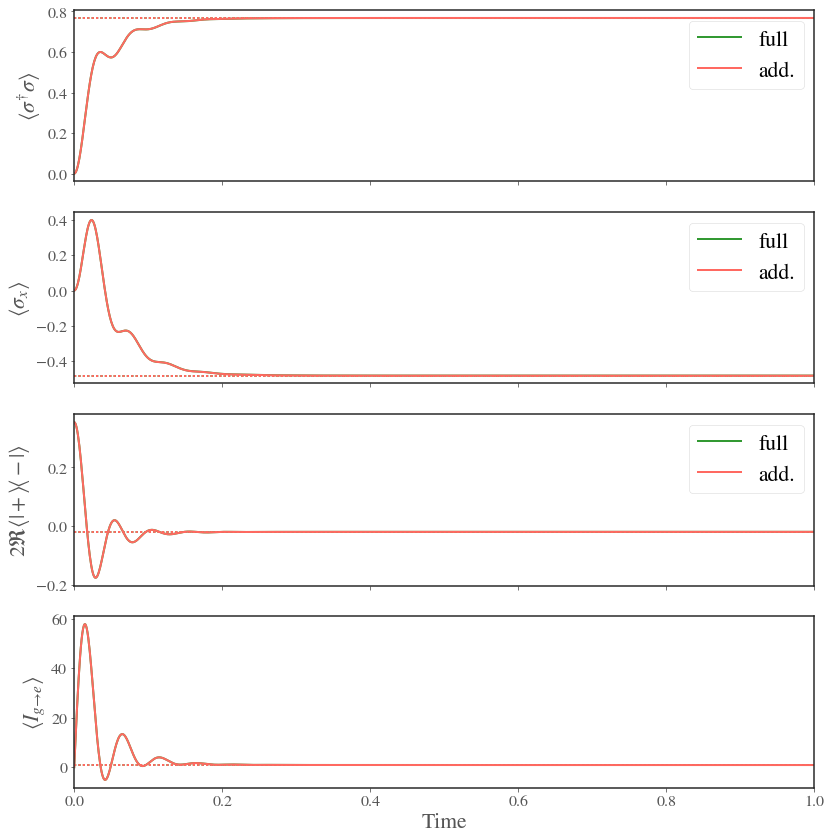

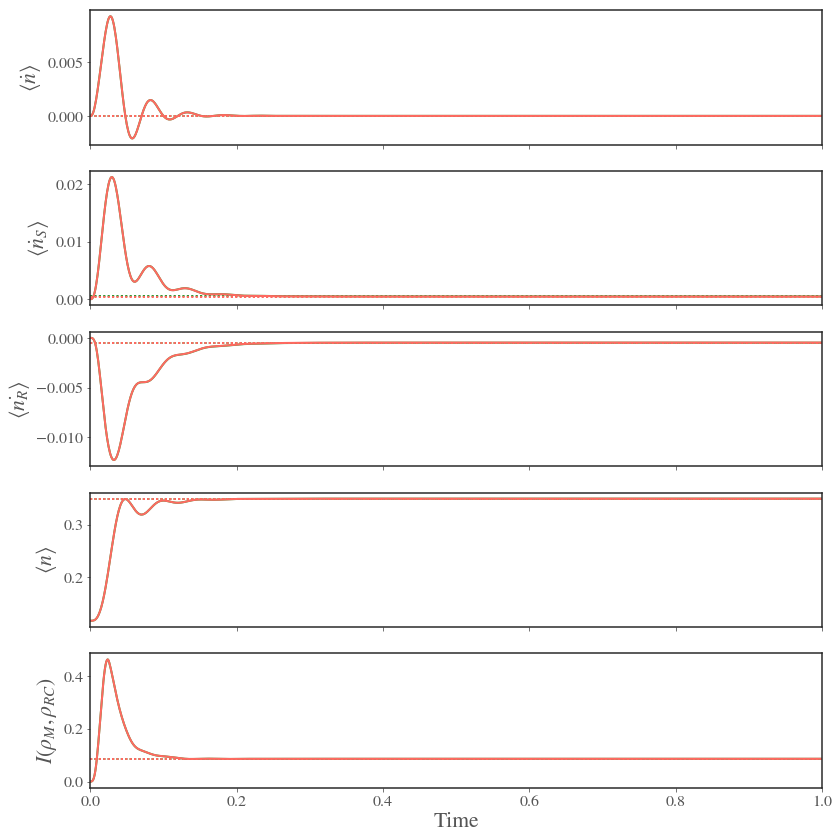

In [350]:
# T = 77K 
reload(EM)
timelist, data_full, data_add, L_RC, H, A_ph, A_EM, ss, pars = add_comparison(detuning=0.01, alpha=0.003, 
                                                                       Rabi=0.01, w0=0.015, N=9, T_ph=77)
plot_dynamics(timelist, data_full, data_add, A_EM, A_ph, ss, timelength=1)
plot_thermo_and_info(timelist, data_full, data_add, L_RC, H, A_ph.dag()*A_ph, ss, timelength=1)

 I don't know why the phonon currents have the oscillatory behaviour that they do. Nor do I know what the relative scaling factor is. I just need to focus on getting some of this written up now.

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[  0.      40.3275]
 [ 40.3275 -80.655 ]] Laser 
80.655 24.1965 65.05229025
T_ph=300
w_RC=80.655 | RC-res. coupling=0.1284 | TLS-RC coupling=55.37 | Gamma_RC=65.05 | alpha_ph=24.20 | N=8 |
Full:
[[ 0.42328623+0.j         -0.08646199+0.00411296j]
 [-0.08646199-0.00411296j  0.57671377+0.j        ]] 
 Add.:
[[ 0.42303050+0.j         -0.08660696+0.00404416j]
 [-0.08660696-0.00404416j  0.57696950+0.j        ]]
Dynamics complete


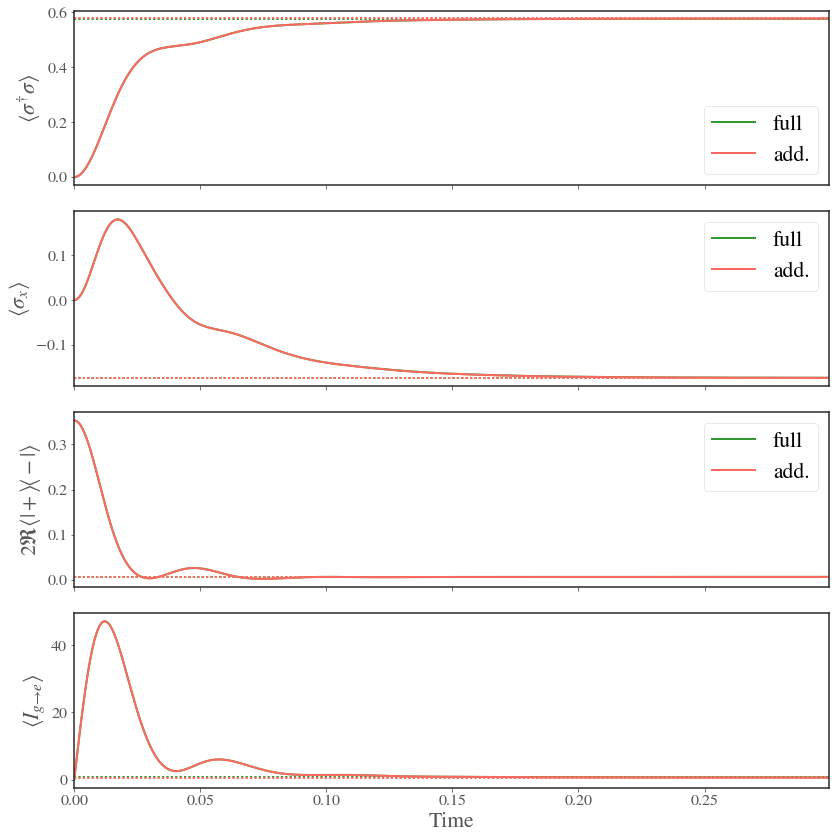

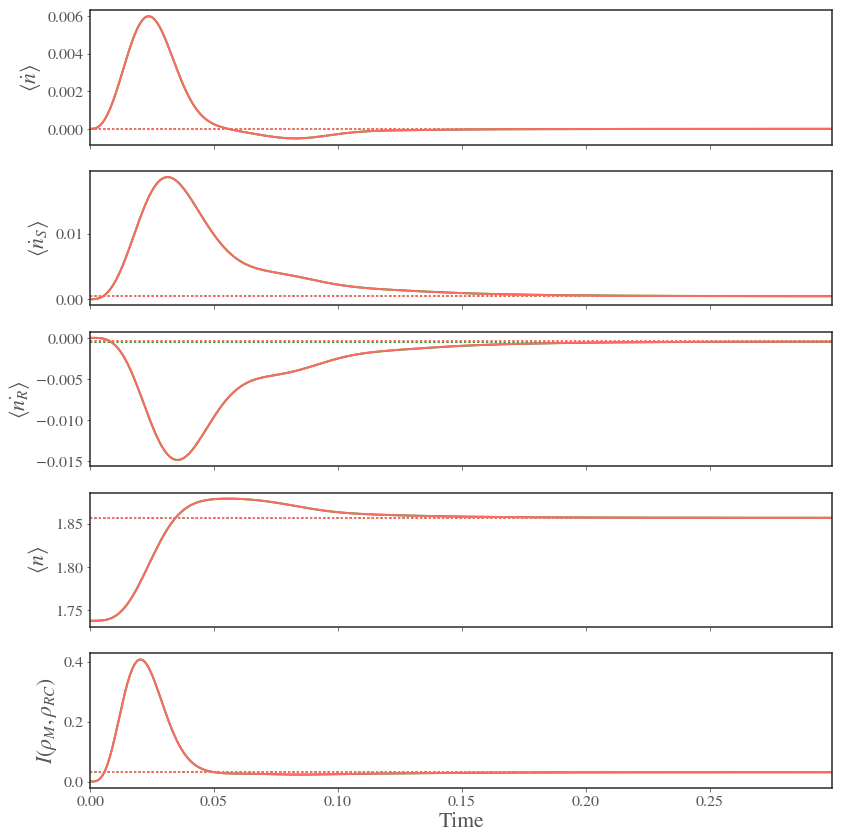

In [351]:
# T = 300K 
timelist, data_full, data_add, L_RC, H, A_ph, A_EM, ss, pars = add_comparison(detuning=0.01, alpha=0.003, 
                                                           Rabi=0.01, w0=0.01, N=8, T_ph=300)
plot_dynamics(timelist, data_full, data_add, A_EM, A_ph, ss, timelength=0.3)
plot_thermo_and_info(timelist, data_full, data_add, L_RC, H, A_ph.dag()*A_ph, ss, timelength=0.3)

## Temperature on higher $\omega_0$

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[  0.      40.3275]
 [ 40.3275 -80.655 ]] Laser 
241.965 24.1965 585.47061225
T_ph=77
w_RC=241.965 | RC-res. coupling=0.3851 | TLS-RC coupling=95.90 | Gamma_RC=585.47 | alpha_ph=24.20 | N=8 |
Full:
[[ 0.23737391+0.j        -0.24064155+0.0054265j]
 [-0.24064155-0.0054265j  0.76262609+0.j       ]] 
 Add.:
[[ 0.23696311+0.j        -0.24098665+0.0053575j]
 [-0.24098665-0.0053575j  0.76303689+0.j       ]]
Dynamics complete


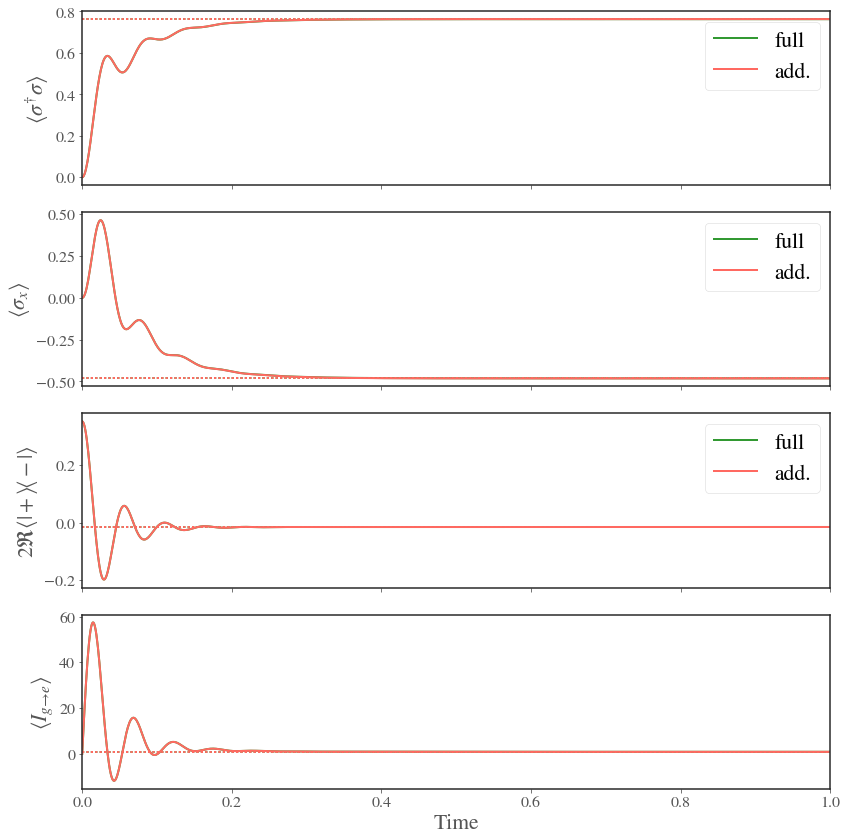

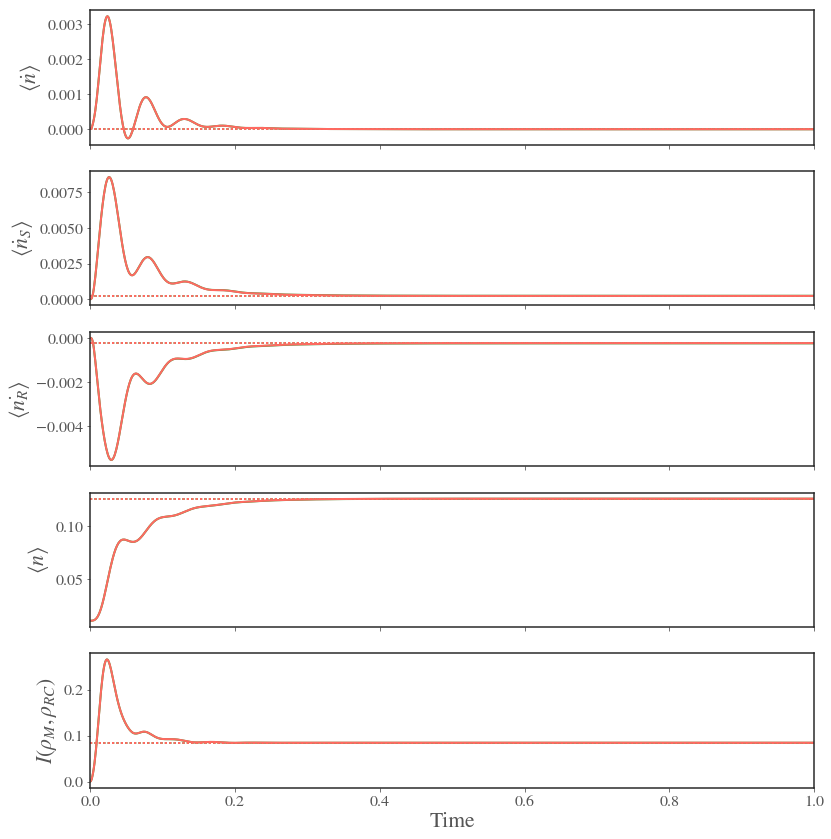

In [352]:
# T = 77K 
timelist, data_full, data_add, L_RC, H, A_ph, A_EM, ss, pars = add_comparison(detuning=0.01, alpha=0.003, 
                                                           Rabi=0.01,w0=0.03, N=8, T_ph=77)
plot_dynamics(timelist, data_full, data_add, A_EM, A_ph, ss, timelength=1)
plot_thermo_and_info(timelist, data_full, data_add, L_RC, H, A_ph.dag()*A_ph, ss, timelength=1)

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[  0.      40.3275]
 [ 40.3275 -80.655 ]] Laser 
241.965 24.1965 585.47061225
T_ph=35
w_RC=241.965 | RC-res. coupling=0.3851 | TLS-RC coupling=95.90 | Gamma_RC=585.47 | alpha_ph=24.20 | N=8 |
Full:
[[ 0.16958498+0.j         -0.29528870+0.00590863j]
 [-0.29528870-0.00590863j  0.83041502+0.j        ]] 
 Add.:
[[ 0.16904448+0.j         -0.29575864+0.00583678j]
 [-0.29575864-0.00583678j  0.83095552+0.j        ]]
Dynamics complete


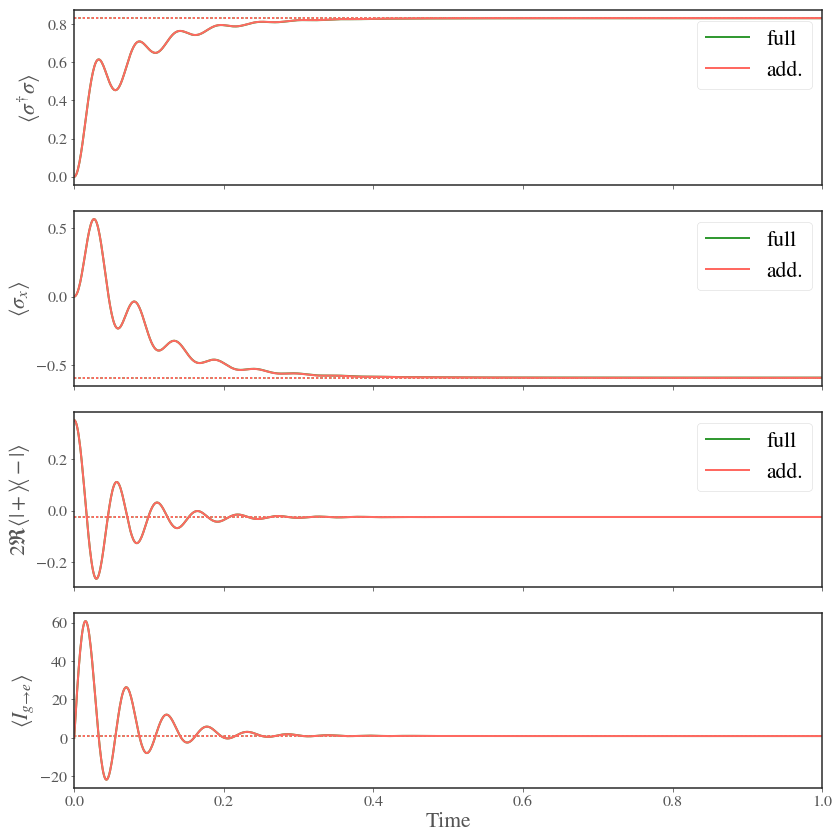

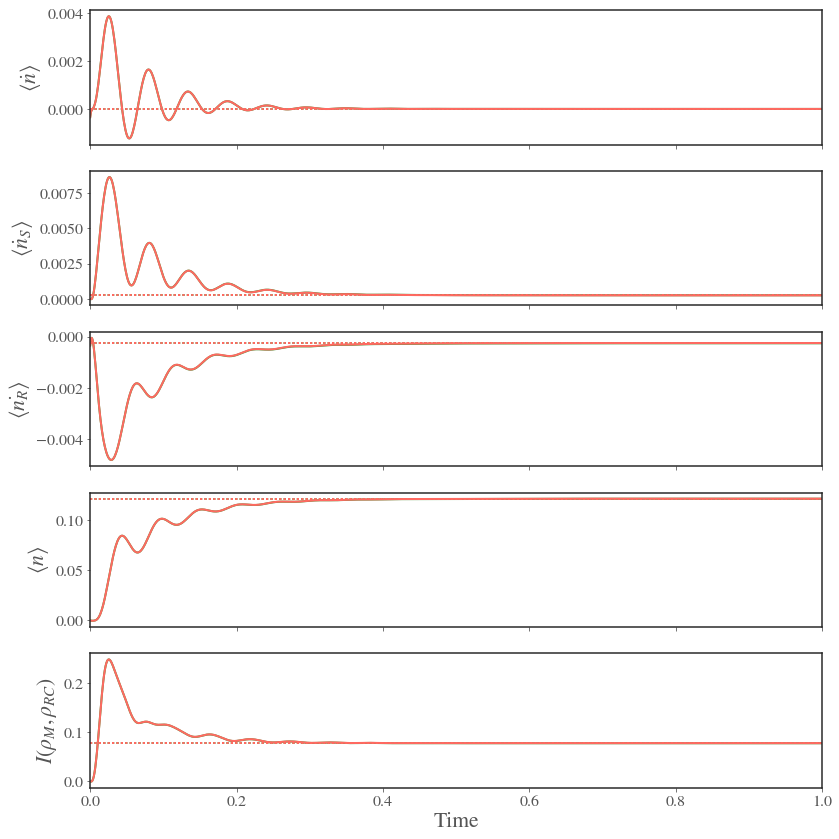

In [353]:
# T = 35K 
timelist, data_full, data_add, L_RC, H, A_ph, A_EM, ss, pars = add_comparison(detuning=0.01, alpha=0.003, 
                                                           Rabi=0.01, w0=0.03, N=8, T_ph=35)
plot_dynamics(timelist, data_full, data_add, A_EM, A_ph, ss, timelength=1)
plot_thermo_and_info(timelist, data_full, data_add, L_RC, H, A_ph.dag()*A_ph, ss, timelength=1)